In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
matplotlib.use('Agg')  # GUIエラーを回避するためにAggバックエンドを使用
import seaborn as sns
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, mean_absolute_percentage_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings('ignore')
import unicodedata # 全角を半角に変換するために使用
from joblib import dump
warnings.filterwarnings('ignore')
from sklearn.linear_model import Ridge
from xgboost import XGBRegressor
from catboost import CatBoostRegressor
from sklearn.ensemble import StackingRegressor
import shap
import sys
import os
from sklearn.cluster import KMeans
#import torch
#from pytorch_tabnet.tab_model import TabNetRegressor
from sklearn.cluster import KMeans, DBSCAN
from sklearn.mixture import GaussianMixture
import hdbscan
import argparse
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.cluster import DBSCAN, AgglomerativeClustering, MeanShift, Birch
from sklearn.cluster import estimate_bandwidth
from tqdm import tqdm
import japanize_matplotlib
import optuna
import scipy.stats as stats
from scipy.optimize import minimize

from IPython.display import display, HTML
from lightgbm import LGBMClassifier

from sklearn.linear_model import Ridge
from sklearn.linear_model import QuantileRegressor
from xgboost import XGBRegressor
from catboost import CatBoostRegressor
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import TweedieRegressor
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score, classification_report, confusion_matrix

from datetime import datetime
pd.options.display.max_columns = 1000
pd.options.display.max_rows = 100
%matplotlib inline

In [2]:
import logging
# Optunaのロガーを取得
optuna_logger = logging.getLogger('optuna')

# ロギングレベルをWARNING以上に設定
optuna_logger.setLevel(logging.WARNING)

# Model作成

## データの読み込み と 確認

In [3]:
aggregated_df = pd.read_csv("aggregated_df.csv")

In [53]:
aggregated_df.sort_values(by="target_amount_tableau",ascending=False)

,KEY,target_amount,target_amount_tableau,AVG_MONTHLY_POPULATION,TABELOG_ID,SAKAYA_DEALER_NAME,RST_TITLE,NEAREST_STATION_INFO,NEAREST_STATION_INFO_count,DISTANCE_VALUE,RATING_CNT,RATING_SCORE,IS_FAMILY_FRIENDLY,IS_FRIEND_FRIENDLY,IS_ALONE_FRIENDLY,DINNER_INFO,LUNCH_INFO,DINNER_PRICE,LUNCH_PRICE,HOLIDAY,HOME_PAGE_URL,PHONE_NUM,NUM_SEATS,AGE_RESTAURANT,CITY,CITY_count,CUISINE_CAT_origin,menu,average_target_amount_in_length_of_relationship,BAPC_2024,CUISINE_CAT,CUISINE_CAT_1_bread and desert,CUISINE_CAT_1_cafe and coffee shop,CUISINE_CAT_1_cafeteria,CUISINE_CAT_1_chinese cuisine,CUISINE_CAT_1_convenience store,CUISINE_CAT_1_family restaurant,CUISINE_CAT_1_fastfood light meal,CUISINE_CAT_1_foreign ethnic cuisine,CUISINE_CAT_1_hotel and ryokan,CUISINE_CAT_1_italian cuisine,CUISINE_CAT_1_izakaya,CUISINE_CAT_1_japanese cuisine,CUISINE_CAT_1_noodles,CUISINE_CAT_1_other,CUISINE_CAT_1_restaurant,rate_count,seats_rate_count,CUISINE_CAT_num,CUISINE_CAT_origin_num,y_class,CLUSTER_all
15881,2100026-9791,1033.0,599.583333,7838.406032,13164146.0,博多もつ鍋やまや池袋店,博多もつ鍋 やまや 池袋店,東池袋,485,640.0,218.0,3.18,0.0,1.0,0.0,1.0,1.0,4499.50,1499.50,0.0,1.0,1,85.0,11.0,豊島区,5078.0,もつ鍋,"""■麦酒"",""生ビール "",""瓶ビール "",""ノンアルコールビール"",""■こだわりの焼酎 正...",114.777778,122.133333,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,70891.161748,18530.0,12,34,high,0
20871,2100118-3949,1459.0,598.000000,2901.280713,13168762.0,富士らーめん,富士らーめん,浅草（つくばＥＸＰ）,1393,160.0,288.0,3.48,0.0,1.0,1.0,1.0,0.0,1499.50,749.25,0.0,0.0,1,10.0,11.0,台東区,5889.0,ラーメン,NaN,121.583333,126.083333,noodles,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,146990.310565,2880.0,13,139,high,3
15811,2100026-79005,2684.0,596.166667,14028.785577,13018041.0,大紘食品(株)兆楽(宇田川店),兆楽 宇田川町店,渋谷,2631,1200.0,1659.0,3.49,1.0,1.0,1.0,1.0,1.0,749.25,749.25,0.0,0.0,1,22.0,20.0,渋谷区,8632.0,中華料理,"""アルコール類"",""生ビール"",""瓶ビール"",""生ビールセット（A・B・C）"",""かた焼き生...",298.222222,142.583333,chinese cuisine,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,858961.148563,36498.0,4,149,high,1
15298,2100026-2495,3000.0,595.000000,4459.609149,13200737.0,シャルロッテ,シャルロッテ,蓮沼,203,133.0,4.0,3.04,0.0,0.0,0.0,0.0,0.0,1499.50,999.00,0.0,1.0,0,23.0,1.0,墨田区,3096.0,その他,"""Hot"",""ホットコーヒー"",""ホットティー"",""Cold"",""アイスコーヒー"",""アイス...",600.000000,231.750000,other,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1038.551194,92.0,14,20,high,3
19951,2100062-2528,961.0,594.833333,2904.857709,13045847.0,成城裏市場萬福c,成城裏市場 萬福,成城学園前,221,400.0,41.0,3.26,1.0,1.0,0.0,1.0,0.0,3499.50,1499.50,0.0,1.0,1,40.0,17.0,世田谷区,6748.0,居酒屋,NaN,80.083333,40.041667,izakaya,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,15096.346556,1640.0,11,178,high,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16858,2100042-23250,180.0,20.083333,1133.133920,13215129.0,鮨つね,鮨つね,三軒茶屋,812,640.0,21.0,3.07,1.0,0.0,0.0,1.0,1.0,6999.50,1499.50,1.0,1.0,1,19.0,8.0,世田谷区,6748.0,寿司,"""【ビール】"",""生ビール"",""小生ビール"",""アサヒスーパードライ（中瓶）"",""キリンラガ...",15.000000,12.541667,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,5726.788868,399.0,12,176,low,3
1117,2100008-631661,216.0,20.083333,2960.299045,13012692.0,カフェ・マディ 南青山店,カフェ・マディ 青山店,表参道,735,240.0,272.0,3.45,1.0,1.0,0.0,1.0,1.0,2499.50,1499.50,0.0,1.0,1,56.0,31.0,港区,11198.0,ヨーロッパ料理,"""■ＢＥＥＲ"",""ドラフト"",""ギネスドラフト"",""ヒューガルデン ホワイト"",""カールズバ...",18.000000,11.916667,foreign ethnic cuisine,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,132942.664665,15232.0,8,137,low,0
1925,2100008-668102,238.0,20.083333,2736.521437,13186225.0,東昇餃子楼 市谷店,中国料理 東昇餃子楼 市ヶ谷店,市ケ谷,327,260.0,24.0,3.08,0.0,0.0,0.0,1.0,1.0,3499.50,749.25,0.0,1.0,1,46.0,9.0,新宿区,10057.0,餃子,"""ビール"",""生ビール（中）"",""小生ビール"",""瓶ビール"",""ドライゼロ"",""紹興酒"",""...",19.833333,9.458333,chinese cuisine,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,6652.192744,1104.0,4,248,low,3
1623,2100008-661584,236.0,20.083333,3834.432752,13224316.0,太子堂 イサーンキッチン,タイ東北料理 イサーン・キッチン,三軒茶屋,812,160.0,259.0,3.47,0.0,0.0,0.0,1.0,1.0,2499.50,749.25,0.0,0.0,1,26.0,7.0,世田谷区,6748.0,タイ料理,NaN,19.666667,13.958333,foreign ethnic cuisine,

In [4]:
# We use -np.inf and np.inf to cover all possible values.
bins = [-np.inf, 75, 150, np.inf]

# Define the labels for the corresponding bins
labels = ['low', 'middle', 'high']

# Use pd.cut to create the new column 'y_class'
# right=True is the default, meaning the intervals are (a, b] (left-exclusive, right-inclusive).
# This corresponds to:
# 'low': (-inf, 75] -> target_amount_tableau <= 75
# 'middle': (75, 150] -> 75 < target_amount_tableau <= 150
# 'high': (150, inf) -> 150 < target_amount_tableau
aggregated_df['y_class'] = pd.cut(
    aggregated_df['target_amount_tableau'],
    bins=bins,
    labels=labels,
    right=True,
    include_lowest=True  # Although right=True is used, include_lowest=True ensures the lowest bin's left side is included, which is handled by -np.inf here.
)

# Display the first few rows to confirm the result (Optional)
print(aggregated_df[['target_amount_tableau', 'y_class']].head())

   target_amount_tableau y_class
0               9.500000     low
1               6.000000     low
2               1.416667     low
3               7.583333     low
4              40.500000     low


In [5]:
aggregated_df

,KEY,target_amount,target_amount_tableau,AVG_MONTHLY_POPULATION,TABELOG_ID,SAKAYA_DEALER_NAME,RST_TITLE,NEAREST_STATION_INFO,NEAREST_STATION_INFO_count,DISTANCE_VALUE,RATING_CNT,RATING_SCORE,IS_FAMILY_FRIENDLY,IS_FRIEND_FRIENDLY,IS_ALONE_FRIENDLY,DINNER_INFO,LUNCH_INFO,DINNER_PRICE,LUNCH_PRICE,HOLIDAY,HOME_PAGE_URL,PHONE_NUM,NUM_SEATS,AGE_RESTAURANT,CITY,CITY_count,CUISINE_CAT_origin,menu,average_target_amount_in_length_of_relationship,BAPC_2024,CUISINE_CAT,CUISINE_CAT_1_bread and desert,CUISINE_CAT_1_cafe and coffee shop,CUISINE_CAT_1_cafeteria,CUISINE_CAT_1_chinese cuisine,CUISINE_CAT_1_convenience store,CUISINE_CAT_1_family restaurant,CUISINE_CAT_1_fastfood light meal,CUISINE_CAT_1_foreign ethnic cuisine,CUISINE_CAT_1_hotel and ryokan,CUISINE_CAT_1_italian cuisine,CUISINE_CAT_1_izakaya,CUISINE_CAT_1_japanese cuisine,CUISINE_CAT_1_noodles,CUISINE_CAT_1_other,CUISINE_CAT_1_restaurant,rate_count,seats_rate_count,CUISINE_CAT_num,CUISINE_CAT_origin_num,y_class
0,2100008-100038,115.0,9.500000,1153.122639,13047470.0,南青山焼き鳥もつ焼き青山,焼き鳥 もつ焼き 青山,外苑前,427,400.0,38.0,3.21,0.0,1.0,0.0,1.0,0.0,4499.5,1499.5,1.0,1.0,1,36.0,17.0,港区,11198.0,焼き鳥,NaN,9.583333,4.791667,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,12951.162681,1368.0,12,211,low
1,2100008-100075,72.0,6.000000,792.017377,13034295.0,六本木 豚タツ,白金三代目 豚タツ,麻布十番,770,400.0,38.0,3.26,0.0,1.0,0.0,1.0,0.0,6999.5,3999.5,0.0,0.0,1,16.0,18.0,港区,11198.0,しゃぶしゃぶ,"""◇焼酎◇"",""芋"",""紫"",""明るい農村"",""こく紫"",""富乃宝山"",""吉兆宝山"",""いも...",6.000000,9.166667,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,13991.735832,608.0,12,16,low
2,2100008-100077,17.0,1.416667,818.302181,13154369.0,西麻布barnemesis,ネメシス,広尾、六本木,1473,560.0,6.0,3.00,0.0,1.0,1.0,1.0,1.0,5999.0,5999.0,0.0,1.0,0,18.0,23.0,港区,11198.0,バー,NaN,2.428571,2.375000,bar,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1458.000000,108.0,0,107,low
3,2100008-100088,114.0,7.583333,5817.798084,13268055.0,阿佐ヶ谷 ライブハウス yellow vision,Yellow Vision,阿佐ケ谷、南阿佐ケ谷,632,64.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,999.0,999.0,0.0,1.0,0,23.0,3.0,杉並区,4557.0,その他,NaN,9.500000,12.333333,other,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0.000000,0.0,14,20,low
4,2100008-100124,477.0,40.500000,1139.661995,13105939.0,一之江 梁山泊,中国酒家 長江,一之江,198,80.0,23.0,3.22,1.0,1.0,0.0,1.0,1.0,2999.0,2999.0,0.0,0.0,0,90.0,15.0,江戸川区,3129.0,中華料理,NaN,43.363636,53.416667,chinese cuisine,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,7961.725397,2070.0,4,149,low
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23530,2401200-125094,97.0,25.250000,2495.429860,13293108.0,schoolbuscoffeestopnakameguro店,SCHOOL BUS COFFEE STOP NAKAMEGURO,池尻大橋,464,800.0,39.0,3.11,0.0,0.0,1.0,1.0,1.0,1499.5,1499.5,0.0,1.0,1,20.0,1.0,目黒区,3306.0,カフェ,NaN,16.166667,4.041667,cafe and coffee shop,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,11346.621088,780.0,2,53,low
23531,2401200-125960,9.0,0.583333,1953.273199,13300975.0,焼ふぐ夢鉄砲天(sora)南青山店,焼ふぐ夢鉄砲 天 南青山店,青山一丁目,171,173.0,20.0,3.09,0.0,0.0,1.0,1.0,0.0,34999.5,3499.5,3.0,1.0,1,10.0,0.5,港区,11198.0,ふぐ,NaN,1.800000,0.375000,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,5634.072001,200.0,12,31,low
23532,2401200-126070,9.0,0.916667,2791.743851,13304942.0,meikitchen,MEiKiTCHEN,神保町,662,283.0,2.0,3.06,0.0,0.0,0.0,0.0,0.0,5499.5,1499.5,0.0,0.0,0,30.0,0.4,千代田区,7395.0,スペイン料理,NaN,3.000000,1.333333,foreign ethnic cuisine,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,536.583270,60.0,8,83,low
23533,2401200-127228,39.0,6.000000,891.541033,13220741.0,鮨 長島,鮨 長島,白金台,229,800.0,80.0,3.55,0.0,0.0,1.0,1.0,0.0,24999.5,5999.0,0.0,0.0,1,7.0,7.0,港区,11198.0,寿司,NaN,3.250000,1.541667,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,45105.733775,560.0,12,176,low


In [6]:
aggregated_df.sort_values(by="target_amount_tableau",ascending=False)

,KEY,target_amount,target_amount_tableau,AVG_MONTHLY_POPULATION,TABELOG_ID,SAKAYA_DEALER_NAME,RST_TITLE,NEAREST_STATION_INFO,NEAREST_STATION_INFO_count,DISTANCE_VALUE,RATING_CNT,RATING_SCORE,IS_FAMILY_FRIENDLY,IS_FRIEND_FRIENDLY,IS_ALONE_FRIENDLY,DINNER_INFO,LUNCH_INFO,DINNER_PRICE,LUNCH_PRICE,HOLIDAY,HOME_PAGE_URL,PHONE_NUM,NUM_SEATS,AGE_RESTAURANT,CITY,CITY_count,CUISINE_CAT_origin,menu,average_target_amount_in_length_of_relationship,BAPC_2024,CUISINE_CAT,CUISINE_CAT_1_bread and desert,CUISINE_CAT_1_cafe and coffee shop,CUISINE_CAT_1_cafeteria,CUISINE_CAT_1_chinese cuisine,CUISINE_CAT_1_convenience store,CUISINE_CAT_1_family restaurant,CUISINE_CAT_1_fastfood light meal,CUISINE_CAT_1_foreign ethnic cuisine,CUISINE_CAT_1_hotel and ryokan,CUISINE_CAT_1_italian cuisine,CUISINE_CAT_1_izakaya,CUISINE_CAT_1_japanese cuisine,CUISINE_CAT_1_noodles,CUISINE_CAT_1_other,CUISINE_CAT_1_restaurant,rate_count,seats_rate_count,CUISINE_CAT_num,CUISINE_CAT_origin_num,y_class
18995,2100048-223148,68444.00,34774.333333,3872.463665,13098970.0,浅草もんじゃぜんや,浅草もんじゃ ぜんや,浅草（つくばＥＸＰ）,1393,160.0,8.0,3.00,1.0,0.0,0.0,1.0,1.0,2499.50,1499.50,0.0,0.0,1,4.0,1.0,台東区,5889.0,もんじゃ焼き,"""ビール"",""生ビール"",""瓶ビール"",""ホッピー"",""ホッピーセット"",""日本酒"",""豪快...",5703.666667,1023.875000,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1944.000000,32.0,12,35,high
18988,2100048-223115,60546.00,25388.750000,3775.728541,13177610.0,浅草もんじゃかのや,浅草もんじゃ かのや,浅草（つくばＥＸＰ）,1393,240.0,67.0,3.31,0.0,0.0,0.0,1.0,1.0,3499.50,749.25,0.0,0.0,1,26.0,2.0,台東区,5889.0,もんじゃ焼き,"""店長オススメ！健康ドリンク！全て中ジョッキサイズです。"",""お疲れクエン酸サワー"",""男梅...",5045.500000,711.083333,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,26620.411931,1742.0,12,35,high
15979,2100039-20212,14617.00,17071.750000,5935.482422,13107693.0,(東京油組総本店)油そば銀座店,東京油組総本店 銀座組,東銀座,930,240.0,307.0,3.15,1.0,1.0,1.0,1.0,1.0,749.25,749.25,0.0,1.0,1,8.0,15.0,中央区,8669.0,つけ麺,"""ビール【ヱビス小瓶】"",""コーラ"",""黒ウーロン茶""",1218.083333,608.583333,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,95211.880844,2456.0,12,27,high
9037,2100014-5601497,6868.00,9280.333333,6493.845186,13006265.0,世界の山ちゃん西武新宿店◆,世界の山ちゃん 西武新宿店,西武新宿,1146,80.0,201.0,3.11,1.0,1.0,0.0,1.0,0.0,2499.50,1499.50,0.0,1.0,1,251.0,20.0,新宿区,10057.0,居酒屋,"""ビール"",""中ジョッキ"",""大ジョッキ"",""ピッチャー"",""大瓶"",""コロナビール"",""ハ...",572.333333,795.375000,izakaya,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,58478.739453,50451.0,11,178,high
9203,2100014-6005316,11336.00,9112.500000,2710.761812,13268705.0,月島もんじゃおこげ浅草店◆,月島もんじゃ おこげ 浅草,浅草,1000,240.0,84.0,3.31,0.0,0.0,0.0,1.0,1.0,2499.50,1499.50,0.0,0.0,1,120.0,3.0,台東区,5889.0,もんじゃ焼き,NaN,944.666667,767.041667,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,33374.844809,10080.0,12,35,high
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20643,2100118-1687,-8.12,-1.416667,2011.452055,13007953.0,串のこたに,串のこたに,綾瀬,307,240.0,187.0,3.47,0.0,1.0,0.0,1.0,0.0,3499.50,2499.50,0.0,1.0,1,150.0,20.0,足立区,3556.0,串揚げ,NaN,-1.353333,235.592523,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,94078.195894,28050.0,12,152,low
18829,2100048-1113028,-35.00,-2.916667,1471.723829,13007204.0,有限会社精香園,精香園,田町,324,1200.0,159.0,3.46,0.0,1.0,0.0,1.0,0.0,5499.50,1499.50,0.0,0.0,1,48.0,20.0,港区,11198.0,焼肉,NaN,-35.000000,23.966667,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,78845.628297,7632.0,12,212,low
21748,2100914-13098,-43.00,-3.583333,9173.344237,13288425.0,鰻の成瀬北千住店,鰻の成瀬 北千住店,北千住,980,480.0,74.0,3.06,0.0,0.0,0.0,1.0,1.0,2499.50,2499.50,0.0,1.0,1,25.0,2.0,足立区,3556.0,うなぎ,NaN,-43.000000,0.208333,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,19853.581003,1850.0,12,3,low
8754,2100014-2131304,-45.00,-3.750000,11702.711358,13084874.0,酒亭玉河・本店(立川),酒亭 玉河,立川,707,160.0,253.0,3.48,1.0,1.0,1.0,1.0,1.0,2499.50,1499.50,0.0,0.0,1,36.0,75.0,立川市,1693.0,居酒屋,NaN,-45.000000,9.333333,izakaya,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,129126.904768,9108.0,11,178,low


(0.0, 600.0)

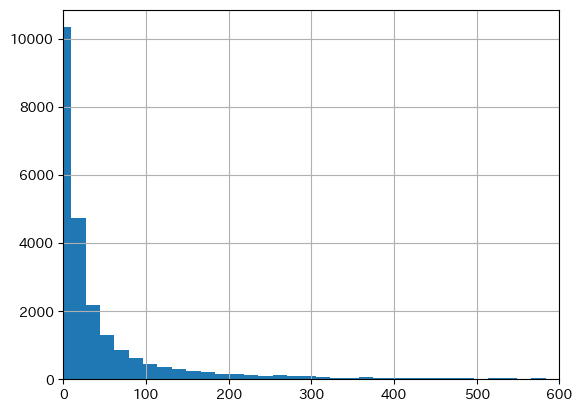

In [7]:
aggregated_df["target_amount_tableau"].hist(bins=2000)
plt.xlim(0, 600)

## IQR による外れ値可視化

### aggregated_df すべてのデータ

In [8]:
def calc_IQR(df:pd.DataFrame, target:str):
    Q1 = df[target].quantile(0.25)
    Q3 = df[target].quantile(0.75)
    IQR = Q3 - Q1
    
    # 外れ値の閾値を設定
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    print(f"--- Outlier Detection ---")
    print(f"Q1 (target_amount): {Q1}")
    print(f"Q3 (target_amount): {Q3}")
    print(f"IQR: {IQR}")
    print(f"Lower Bound: {lower_bound}")
    print(f"Upper Bound: {upper_bound}")
    print(f"Original df_quantity_1 Length: {len(df)}")

In [9]:
calc_IQR(aggregated_df, "target_amount_tableau")

--- Outlier Detection ---
Q1 (target_amount): 2.833333333333333
Q3 (target_amount): 49.0
IQR: 46.166666666666664
Lower Bound: -66.41666666666667
Upper Bound: 118.25
Original df_quantity_1 Length: 23535


この結果を見ると、IQRだけで外れ値とみなすのはかなり厳しい。600なども学習データに入れたい。

### aggregated_df を adhocに絞ったデータ

In [10]:
aggregated_df_trim = aggregated_df[(aggregated_df["target_amount_tableau"]<600) & (aggregated_df["target_amount_tableau"]>20)]
calc_IQR(aggregated_df_trim, "target_amount_tableau")

--- Outlier Detection ---
Q1 (target_amount): 33.75
Q3 (target_amount): 124.41666666666669
IQR: 90.66666666666669
Lower Bound: -102.25000000000003
Upper Bound: 260.41666666666674
Original df_quantity_1 Length: 9294


In [11]:
aggregated_df.columns

Index(['KEY', 'target_amount', 'target_amount_tableau',
       'AVG_MONTHLY_POPULATION', 'TABELOG_ID', 'SAKAYA_DEALER_NAME',
       'RST_TITLE', 'NEAREST_STATION_INFO', 'NEAREST_STATION_INFO_count',
       'DISTANCE_VALUE', 'RATING_CNT', 'RATING_SCORE', 'IS_FAMILY_FRIENDLY',
       'IS_FRIEND_FRIENDLY', 'IS_ALONE_FRIENDLY', 'DINNER_INFO', 'LUNCH_INFO',
       'DINNER_PRICE', 'LUNCH_PRICE', 'HOLIDAY', 'HOME_PAGE_URL', 'PHONE_NUM',
       'NUM_SEATS', 'AGE_RESTAURANT', 'CITY', 'CITY_count',
       'CUISINE_CAT_origin', 'menu',
       'average_target_amount_in_length_of_relationship', 'BAPC_2024',
       'CUISINE_CAT', 'CUISINE_CAT_1_bread and desert',
       'CUISINE_CAT_1_cafe and coffee shop', 'CUISINE_CAT_1_cafeteria',
       'CUISINE_CAT_1_chinese cuisine', 'CUISINE_CAT_1_convenience store',
       'CUISINE_CAT_1_family restaurant', 'CUISINE_CAT_1_fastfood light meal',
       'CUISINE_CAT_1_foreign ethnic cuisine',
       'CUISINE_CAT_1_hotel and ryokan', 'CUISINE_CAT_1_italian cuisi

In [12]:
# カラム名、データ型、サンプル（最初の行）の情報を取得
df_info = pd.DataFrame({
    'カラム名': aggregated_df.columns,
    'データ型': aggregated_df.dtypes,
    'サンプル': aggregated_df.iloc[0].values
})

# Jupyter Notebookで表示
df_info

,カラム名,データ型,サンプル
KEY,KEY,object,2100008-100038
target_amount,target_amount,float64,115.0
target_amount_tableau,target_amount_tableau,float64,9.5
AVG_MONTHLY_POPULATION,AVG_MONTHLY_POPULATION,float64,1153.122639
TABELOG_ID,TABELOG_ID,float64,13047470.0
SAKAYA_DEALER_NAME,SAKAYA_DEALER_NAME,object,南青山焼き鳥もつ焼き青山
RST_TITLE,RST_TITLE,object,焼き鳥 もつ焼き 青山
NEAREST_STATION_INFO,NEAREST_STATION_INFO,object,外苑前
NEAREST_STATION_INFO_count,NEAREST_STATION_INFO_count,int64,427
DISTANCE_VALUE,DISTANCE_VALUE,float64,400.0


In [13]:
aggregated_df.head()

,KEY,target_amount,target_amount_tableau,AVG_MONTHLY_POPULATION,TABELOG_ID,SAKAYA_DEALER_NAME,RST_TITLE,NEAREST_STATION_INFO,NEAREST_STATION_INFO_count,DISTANCE_VALUE,RATING_CNT,RATING_SCORE,IS_FAMILY_FRIENDLY,IS_FRIEND_FRIENDLY,IS_ALONE_FRIENDLY,DINNER_INFO,LUNCH_INFO,DINNER_PRICE,LUNCH_PRICE,HOLIDAY,HOME_PAGE_URL,PHONE_NUM,NUM_SEATS,AGE_RESTAURANT,CITY,CITY_count,CUISINE_CAT_origin,menu,average_target_amount_in_length_of_relationship,BAPC_2024,CUISINE_CAT,CUISINE_CAT_1_bread and desert,CUISINE_CAT_1_cafe and coffee shop,CUISINE_CAT_1_cafeteria,CUISINE_CAT_1_chinese cuisine,CUISINE_CAT_1_convenience store,CUISINE_CAT_1_family restaurant,CUISINE_CAT_1_fastfood light meal,CUISINE_CAT_1_foreign ethnic cuisine,CUISINE_CAT_1_hotel and ryokan,CUISINE_CAT_1_italian cuisine,CUISINE_CAT_1_izakaya,CUISINE_CAT_1_japanese cuisine,CUISINE_CAT_1_noodles,CUISINE_CAT_1_other,CUISINE_CAT_1_restaurant,rate_count,seats_rate_count,CUISINE_CAT_num,CUISINE_CAT_origin_num,y_class
0,2100008-100038,115.0,9.500000,1153.122639,13047470.0,南青山焼き鳥もつ焼き青山,焼き鳥 もつ焼き 青山,外苑前,427,400.0,38.0,3.21,0.0,1.0,0.0,1.0,0.0,4499.5,1499.5,1.0,1.0,1,36.0,17.0,港区,11198.0,焼き鳥,NaN,9.583333,4.791667,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,12951.162681,1368.0,12,211,low
1,2100008-100075,72.0,6.000000,792.017377,13034295.0,六本木 豚タツ,白金三代目 豚タツ,麻布十番,770,400.0,38.0,3.26,0.0,1.0,0.0,1.0,0.0,6999.5,3999.5,0.0,0.0,1,16.0,18.0,港区,11198.0,しゃぶしゃぶ,"""◇焼酎◇"",""芋"",""紫"",""明るい農村"",""こく紫"",""富乃宝山"",""吉兆宝山"",""いも...",6.000000,9.166667,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,13991.735832,608.0,12,16,low
2,2100008-100077,17.0,1.416667,818.302181,13154369.0,西麻布barnemesis,ネメシス,広尾、六本木,1473,560.0,6.0,3.00,0.0,1.0,1.0,1.0,1.0,5999.0,5999.0,0.0,1.0,0,18.0,23.0,港区,11198.0,バー,NaN,2.428571,2.375000,bar,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1458.000000,108.0,0,107,low
3,2100008-100088,114.0,7.583333,5817.798084,13268055.0,阿佐ヶ谷 ライブハウス yellow vision,Yellow Vision,阿佐ケ谷、南阿佐ケ谷,632,64.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,999.0,999.0,0.0,1.0,0,23.0,3.0,杉並区,4557.0,その他,NaN,9.500000,12.333333,other,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0.000000,0.0,14,20,low
4,2100008-100124,477.0,40.500000,1139.661995,13105939.0,一之江 梁山泊,中国酒家 長江,一之江,198,80.0,23.0,3.22,1.0,1.0,0.0,1.0,1.0,2999.0,2999.0,0.0,0.0,0,90.0,15.0,江戸川区,3129.0,中華料理,NaN,43.363636,53.416667,chinese cuisine,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,7961.725397,2070.0,4,149,low


In [14]:
aggregated_df = aggregated_df[~(aggregated_df["CUISINE_CAT"]=="convenience store")]

In [15]:
#aggregated_df = aggregated_df[(aggregated_df["BAPC_2024"]<400) & (aggregated_df["BAPC_2024"]>20)]

In [16]:
aggregated_df = aggregated_df[(aggregated_df["target_amount_tableau"]<600) & (aggregated_df["target_amount_tableau"]>20)]
aggregated_df_high = aggregated_df[(aggregated_df["target_amount_tableau"]<1000) & (aggregated_df["target_amount_tableau"]>=200)]
aggregated_df_middle = aggregated_df[(aggregated_df["target_amount_tableau"]<200) & (aggregated_df["target_amount_tableau"]>=80)]
aggregated_df_low = aggregated_df[(aggregated_df["target_amount_tableau"]<80) & (aggregated_df["target_amount_tableau"]>0)]

In [17]:
print(len(aggregated_df_high))
print(len(aggregated_df_middle))
print(len(aggregated_df_low))

1283
2288
5720


In [18]:
aggregated_df_high

,KEY,target_amount,target_amount_tableau,AVG_MONTHLY_POPULATION,TABELOG_ID,SAKAYA_DEALER_NAME,RST_TITLE,NEAREST_STATION_INFO,NEAREST_STATION_INFO_count,DISTANCE_VALUE,RATING_CNT,RATING_SCORE,IS_FAMILY_FRIENDLY,IS_FRIEND_FRIENDLY,IS_ALONE_FRIENDLY,DINNER_INFO,LUNCH_INFO,DINNER_PRICE,LUNCH_PRICE,HOLIDAY,HOME_PAGE_URL,PHONE_NUM,NUM_SEATS,AGE_RESTAURANT,CITY,CITY_count,CUISINE_CAT_origin,menu,average_target_amount_in_length_of_relationship,BAPC_2024,CUISINE_CAT,CUISINE_CAT_1_bread and desert,CUISINE_CAT_1_cafe and coffee shop,CUISINE_CAT_1_cafeteria,CUISINE_CAT_1_chinese cuisine,CUISINE_CAT_1_convenience store,CUISINE_CAT_1_family restaurant,CUISINE_CAT_1_fastfood light meal,CUISINE_CAT_1_foreign ethnic cuisine,CUISINE_CAT_1_hotel and ryokan,CUISINE_CAT_1_italian cuisine,CUISINE_CAT_1_izakaya,CUISINE_CAT_1_japanese cuisine,CUISINE_CAT_1_noodles,CUISINE_CAT_1_other,CUISINE_CAT_1_restaurant,rate_count,seats_rate_count,CUISINE_CAT_num,CUISINE_CAT_origin_num,y_class
5,2100008-100152,3500.0,277.000000,15635.301882,13098922.0,新宿ねぎし 池袋東口店,ねぎし 池袋東口店,池袋,2564,400.0,239.0,3.22,1.0,1.0,1.0,1.0,1.0,1499.5,1499.50,0.0,1.0,1,60.0,15.0,豊島区,5078.0,牛タン,NaN,291.666667,148.000000,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,82732.711729,14340.0,12,216,high
43,2100008-101466,2133.0,292.416667,3115.696629,13104475.0,北沢 duke capo,DUKE CAPO,下北沢、池ノ上、東北沢,802,80.0,15.0,3.07,0.0,1.0,0.0,1.0,1.0,2999.0,2999.00,0.0,1.0,0,32.0,15.0,世田谷区,6748.0,ダイニングバー,"""━…‥‥…━ ＢＥＥＲ ━…‥‥…━"",""Sapporo 黒ラベル"",""HAINEKEN""...",177.750000,151.375000,bar,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4090.563477,480.0,0,91,high
113,2100008-104162,3473.0,279.750000,4588.420359,13110873.0,磯丸水産 大久保店[64],磯丸水産 大久保駅前店,大久保、新大久保、西武新宿,1146,80.0,55.0,3.06,0.0,1.0,1.0,1.0,1.0,2999.0,2999.00,0.0,1.0,0,160.0,15.0,新宿区,10057.0,魚介料理・海鮮料理,"""□■ ビール ■□"",""生ビール（キリン一番搾り）"",""ノンアルコールビール（キリングリー...",289.416667,77.708333,other,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,14756.039935,8800.0,14,251,high
162,2100008-106029,2557.0,217.583333,3462.919905,13115673.0,磯丸水産 錦糸町店[67],磯丸水産 錦糸町店,錦糸町,1091,80.0,105.0,3.04,1.0,1.0,0.0,1.0,1.0,2499.5,749.25,0.0,1.0,1,80.0,15.0,墨田区,3096.0,海鮮,"""□■ ビール ■□"",""生ビール（キリン一番搾り）"",""ノンアルコールビール（キリングリー...",213.083333,97.758333,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,27261.968843,8400.0,12,205,high
195,2100008-107404,2910.0,202.500000,812.839229,13129284.0,和幸 多摩境店,とんかつ 和幸 多摩境店,多摩境,59,560.0,71.0,3.09,1.0,1.0,1.0,1.0,1.0,1499.5,1499.50,0.0,1.0,1,92.0,14.0,町田市,2044.0,とんかつ,NaN,242.500000,98.000000,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,20000.955604,6532.0,12,28,high
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23371,2101118-2490,706.0,232.833333,7383.236454,13013317.0,銀座瀬里奈,銀座瀬里奈,銀座一丁目、銀座、東銀座,1859,240.0,118.0,3.53,1.0,1.0,0.0,1.0,1.0,19999.0,19999.00,0.0,1.0,1,83.0,38.0,中央区,8669.0,懐石・会席料理,"""【ビール】"",""生ビール"",""ビール（小瓶）"",""ギネス"",""サントリー オールフリー"",...",58.833333,123.750000,other,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,64677.843961,9794.0,14,184,high
23385,2101118-649,917.0,238.250000,1093.585558,13015577.0,トラットリアイタリア目黒駅前,トラットリア・イタリア 目黒店,目黒,606,160.0,189.0,3.35,1.0,1.0,0.0,1.0,1.0,4499.5,1499.50,0.0,1.0,1,76.0,25.0,品川区,4009.0,イタリアン,"""ビール"",""生ビール"",""瓶ビール"",""モレッティ（イタリア産瓶ビール）"",""キリングリー...",76.416667,78.958333,italian cuisine,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,79741.764132,14364.0,10,41,high
23408,2101122-1428,765.0,336.083333,1959.269037,13225825.0,メーメー牧場,メーメー牧場,八王子,971,400.0,18.0,3.19,1.0,0.0,0.0,1.0,0.0,4499.5,2249.25,0.0,0.0,1,32.0,7.0,八王子市,2850.0,焼肉,NaN,63.750000,52.500000,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,5946.013904,576.0,12,212,high
23429,2101122-4051,1151.0,582.250000,2314.621406,13102789.0,うまいもん酒場かさ,かさ,拝島,145,141.0,20.0,3.08,0.0,1.0,0.0,1.0,0.0,2499.5,2999.00,0.0,0.0,1,91.0,15.0,昭島市,542.0,居酒屋,NaN,95.916667,109.583333,izakaya,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,5543.493954,1820.0,11,178,high


In [19]:
aggregated_df_low

,KEY,target_amount,target_amount_tableau,AVG_MONTHLY_POPULATION,TABELOG_ID,SAKAYA_DEALER_NAME,RST_TITLE,NEAREST_STATION_INFO,NEAREST_STATION_INFO_count,DISTANCE_VALUE,RATING_CNT,RATING_SCORE,IS_FAMILY_FRIENDLY,IS_FRIEND_FRIENDLY,IS_ALONE_FRIENDLY,DINNER_INFO,LUNCH_INFO,DINNER_PRICE,LUNCH_PRICE,HOLIDAY,HOME_PAGE_URL,PHONE_NUM,NUM_SEATS,AGE_RESTAURANT,CITY,CITY_count,CUISINE_CAT_origin,menu,average_target_amount_in_length_of_relationship,BAPC_2024,CUISINE_CAT,CUISINE_CAT_1_bread and desert,CUISINE_CAT_1_cafe and coffee shop,CUISINE_CAT_1_cafeteria,CUISINE_CAT_1_chinese cuisine,CUISINE_CAT_1_convenience store,CUISINE_CAT_1_family restaurant,CUISINE_CAT_1_fastfood light meal,CUISINE_CAT_1_foreign ethnic cuisine,CUISINE_CAT_1_hotel and ryokan,CUISINE_CAT_1_italian cuisine,CUISINE_CAT_1_izakaya,CUISINE_CAT_1_japanese cuisine,CUISINE_CAT_1_noodles,CUISINE_CAT_1_other,CUISINE_CAT_1_restaurant,rate_count,seats_rate_count,CUISINE_CAT_num,CUISINE_CAT_origin_num,y_class
4,2100008-100124,477.0,40.500000,1139.661995,13105939.0,一之江 梁山泊,中国酒家 長江,一之江,198,80.0,23.0,3.22,1.0,1.0,0.0,1.0,1.0,2999.0,2999.00,0.0,0.0,0,90.0,15.0,江戸川区,3129.0,中華料理,NaN,43.363636,53.416667,chinese cuisine,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,7961.725397,2070.0,4,149,low
6,2100008-100248,473.0,37.500000,4166.779740,13100784.0,番番(バンバン) 神谷町店,焼鶏 番番,神谷町,293,240.0,57.0,3.04,0.0,1.0,0.0,1.0,1.0,3499.5,749.25,0.0,1.0,1,48.0,19.0,港区,11198.0,鳥料理,"""お飲み物"",""★角ハイボール"",""白州ハイボール"",""知多ハイボール"",""ジンジャーハイボ...",39.416667,18.875000,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,14799.354515,2736.0,12,252,low
7,2100008-100255,169.0,22.916667,1009.211837,13099652.0,六本木 六七(ロクナナ),六七,六本木、乃木坂、六本木一丁目,1473,400.0,97.0,3.41,0.0,1.0,0.0,1.0,1.0,5999.0,5999.00,1.0,0.0,0,44.0,15.0,港区,11198.0,ラウンジ,NaN,14.083333,13.391667,other,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,44724.307958,4268.0,14,138,low
8,2100008-100273,312.0,22.000000,14325.820878,13099879.0,中国名菜 銀座アスター 新宿賓館,銀座アスター 新宿賓館,新宿三丁目,1668,560.0,159.0,3.30,0.0,1.0,0.0,1.0,1.0,8999.5,2499.50,0.0,1.0,1,200.0,15.0,新宿区,10057.0,中華料理,"""おすすめ乾杯ドリンク"",""アサヒスーパードライ エクストラコールド タンブラー"",""フリー...",26.000000,115.000000,chinese cuisine,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,62225.274870,31800.0,4,149,low
20,2100008-100718,894.0,69.000000,4496.518737,13012227.0,東中野 焼肉名菜 慶州,慶州,東中野,255,80.0,69.0,3.34,1.0,1.0,0.0,1.0,0.0,6999.5,1499.50,0.0,0.0,1,55.0,20.0,中野区,2706.0,焼肉,NaN,74.500000,36.500000,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,28680.150422,3795.0,12,212,low
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23524,2401194-154401,215.0,28.583333,11081.889139,13244841.0,クンテープ 虎ノ門ヒルズ店,クンテープ 虎ノ門ヒルズ店,虎ノ門ヒルズ、虎ノ門、神谷町,360,640.0,35.0,3.00,0.0,0.0,1.0,1.0,1.0,3999.0,3999.00,0.0,0.0,1,44.0,5.0,港区,11198.0,タイ料理,"""果肉入りチューハイ"",""パクチー/マンゴー/レモン"",""SHOCHU"",""金黒（芋）"",""...",17.916667,29.750000,foreign ethnic cuisine,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,8505.000000,1540.0,8,88,low
23525,2401200-116360,292.0,56.583333,3049.072581,13207208.0,バル&デリ エル・ロセヨ,バルアンドデリ エル・ロセヨ,学芸大学,537,160.0,56.0,3.39,1.0,0.0,0.0,1.0,1.0,3999.0,3999.00,0.0,1.0,1,35.0,8.0,目黒区,3306.0,スペイン料理,"""生ビール"",""マオウ生ビール"",""大マオウ生ビールpint"",""ジョッキ"",""Pint"",...",24.333333,12.375000,foreign ethnic cuisine,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,25071.857920,1960.0,8,83,low
23526,2401200-118780,251.0,67.916667,1590.312919,13230726.0,入ル 坂上ル,韓国食堂 入ル 坂上ル,恵比寿,1534,240.0,280.0,3.51,0.0,0.0,0.0,1.0,0.0,6999.5,1499.50,0.0,1.0,1,28.0,6.0,渋谷区,8632.0,韓国料理,"""マッコリ"",""虎マッコリ(日本)"",""ホームランマッコリ(日本)"",""イルドンマッコリ(韓...",20.916667,10.375000,foreign ethnic cuisine,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,149174.164349,7840.0,8,245,low
23529,2401200-123546,309.0,56.083333,5872.300290,13275861.0,韓国酒場コッキオ グランスタ八重北店,韓国酒場コッキオ グランスタ八重北店,東京,1232,0.0,254.0,3.44,1.0,0.0,0.0,1.0,1.0,3499.5,1499.50,0.0,0.0,1,86.0,3.0,千代田区,7395.0,韓国料理,"""◆ ビール・ハイボール ◆"",""生ビール"",""TERRA"",""ビアリー"",""ハイボール"",...",25.750000,178.500000,foreign ethnic cuisine,0,0,0,

In [20]:
aggregated_df_low.isnull().sum()

KEY                                                   0
target_amount                                         0
target_amount_tableau                                 0
AVG_MONTHLY_POPULATION                                0
TABELOG_ID                                            0
SAKAYA_DEALER_NAME                                    0
RST_TITLE                                             0
NEAREST_STATION_INFO                                  1
NEAREST_STATION_INFO_count                            0
DISTANCE_VALUE                                        0
RATING_CNT                                            0
RATING_SCORE                                          0
IS_FAMILY_FRIENDLY                                    0
IS_FRIEND_FRIENDLY                                    0
IS_ALONE_FRIENDLY                                     0
DINNER_INFO                                           0
LUNCH_INFO                                            0
DINNER_PRICE                                    

## カテゴリごとの統計情報

In [21]:
summary_stats = aggregated_df.groupby('CUISINE_CAT')['target_amount_tableau'].agg(
    data_count='count',
    mean='mean',
    std='std',
    kurtosis=lambda x: stats.kurtosis(x),
    min='min',
    q25=lambda x: x.quantile(0.25),
    median='median',
    q75=lambda x: x.quantile(0.75),
    max='max'
)
summary_stats.sort_values(by='data_count', ascending=False).head(100)

,data_count,mean,std,kurtosis,min,q25,median,q75,max
CUISINE_CAT,,,,,,,,,
japanese cuisine,3189,114.042385,116.293009,3.774303,20.083333,36.916667,68.000000,141.833333,599.583333
izakaya,1771,104.243883,114.406887,4.358896,20.083333,33.125000,57.000000,125.041667,594.833333
bar,858,82.112859,95.549948,7.246414,20.083333,28.166667,45.708333,89.208333,569.500000
noodles,758,100.263632,99.207197,5.579841,20.083333,35.104167,62.625000,127.958333,598.000000
chinese cuisine,630,92.547619,91.839936,5.570919,20.083333,35.416667,56.000000,111.666667,596.166667
italian cuisine,615,93.147290,95.960935,4.786291,20.083333,32.416667,55.333333,107.541667,544.416667
foreign ethnic cuisine,440,85.360038,88.564637,7.177227,20.083333,30.812500,51.000000,98.437500,528.750000
other,360,97.385880,103.475701,5.457298,20.166667,32.500000,51.958333,124.375000,595.000000
cafe and coffee shop,343,84.922741,89.785804,8.708954,20.166667,30.583333,53.250000,99.666667,561.083333


In [22]:
summary_stats = aggregated_df.groupby('CUISINE_CAT_origin')['target_amount_tableau'].agg(
    data_count='count',
    mean='mean',
    std='std',
    kurtosis=lambda x: stats.kurtosis(x),
    min='min',
    q25=lambda x: x.quantile(0.25),
    median='median',
    q75=lambda x: x.quantile(0.75),
    max='max'
)
summary_stats.sort_values(by='data_count', ascending=False).head(100)

,data_count,mean,std,kurtosis,min,q25,median,q75,max
CUISINE_CAT_origin,,,,,,,,,
居酒屋,1648,105.450951,115.813505,4.301532,20.083333,33.333333,57.958333,125.687500,594.833333
焼肉,864,138.392361,122.034292,2.012255,20.166667,50.000000,92.916667,181.604167,590.333333
ラーメン,553,106.915009,102.403550,5.533911,20.416667,38.500000,67.666667,137.083333,598.000000
バー,443,73.301166,87.682652,9.464280,20.166667,26.666667,39.750000,79.541667,553.583333
中華料理,395,89.549367,94.149211,7.182689,20.083333,34.166667,52.500000,99.750000,596.166667
イタリアン,370,85.549324,90.389254,7.334135,20.166667,30.687500,52.000000,97.854167,560.000000
焼き鳥,335,107.412687,111.480724,4.387098,20.083333,34.708333,60.666667,130.041667,593.333333
カフェ,304,88.521382,96.018977,8.441429,20.166667,30.979167,55.416667,101.270833,561.083333
寿司,288,103.501157,117.961987,4.843150,20.083333,31.000000,53.083333,121.750000,587.083333


In [23]:
# # ヒストグラムの描画
# plt.figure(figsize=(10, 6))
# sns.histplot(
#     data=aggregated_df,
#     x='target_amount_tableau',
#     hue='CUISINE_CAT',
#     multiple='layer',  # ヒストグラムを半透明で重ねて表示
#     bins=15,
#     edgecolor='black'
# )
# plt.title('CUISINE_CAT Target Amount tableau', fontsize=16)
# plt.xlabel('Target Amount', fontsize=12)
# plt.ylabel('flequency', fontsize=12)
# plt.legend(title='CUISINE_CAT')
# plt.grid(axis='y', linestyle='--', alpha=0.7)
# plt.show()

In [24]:
# # KDEプロットの描画
# plt.figure(figsize=(10, 6))
# sns.kdeplot(
#     data=aggregated_df,
#     x='target_amount_tableau',
#     hue='CUISINE_CAT',
#     fill=True,  # 曲線の下を塗りつぶす
#     alpha=.3,   # 塗りつぶしの透過度
#     linewidth=2
# )
# plt.title('Target Amount tableauの分布（KDEプロット）', fontsize=16)
# plt.xlabel('Target Amount', fontsize=12)
# plt.ylabel('密度', fontsize=12)
# plt.grid(axis='y', linestyle='--', alpha=0.7)
# plt.show()

In [25]:
aggregated_df['CUISINE_CAT_origin'].unique()

array(['中華料理', '牛タン', '鳥料理', 'ラウンジ', '焼肉', 'カフェ', 'お好み焼き', 'ダイニングバー',
       'タイ料理', '居酒屋', 'ピザ', 'バー', '焼き鳥', '海鮮', '韓国料理', 'ワインバー', 'ステーキ',
       'ホルモン', '焼鳥', 'パン', '火鍋', '鉄板焼き', 'そば', '串揚げ', '魚介料理・海鮮料理', '寿司',
       'とんかつ', '釜飯', '四川料理', 'もんじゃ焼き', '串焼き', 'ホテル', '日本料理', 'イタリアン',
       'ベトナム料理', 'ラーメン', 'カレー', 'もつ焼き', '担々麺', 'つけ麺', 'もつ鍋', '欧風カレー',
       '屋形船・クルージング', 'ふぐ', 'フレンチ', '食堂', '洋食', '立ち食い寿司', '肉料理', 'うどん',
       '天ぷら', 'ジンギスカン', 'インドネシア料理', 'ビストロ', 'バル・バール', 'オムライス', 'スペイン料理',
       'シュラスコ', '郷土料理（その他）', '定食・食堂', 'その他', 'うなぎ', 'パブ', '割烹・小料理',
       'インド料理', 'バル', 'ダーツ', 'しゃぶしゃぶ', 'アジア・エスニック', '台湾料理', 'かに',
       'スープカレー', 'おでん', 'サンドイッチ', '馬肉料理', '丼', 'ヨーロッパ料理', '郷土料理', '立ち飲み',
       '餃子', 'ろばた焼き', 'メキシコ料理', '沖縄料理', '牛料理', 'ちゃんこ鍋', 'ハワイ料理', 'インドカレー',
       'ビアバー', '弁当', '洋食・欧風料理（その他）', 'すき焼き', 'オイスターバー', '懐石・会席料理',
       'ハンバーガー', 'コーヒー専門店', '中東料理', '焼きとん', '海鮮丼', 'デリカテッセン', 'アメリカ料理',
       '天丼', 'パスタ', 'からあげ', '回転寿司', 'バーベキュー', 'トルコ料理', '喫茶店', 'スイーツ',
       'お

In [26]:
cuisine_cat = [
       'CUISINE_CAT_1_bread and desert', 'CUISINE_CAT_1_cafe and coffee shop',
       'CUISINE_CAT_1_cafeteria', 'CUISINE_CAT_1_chinese cuisine',
       #'CUISINE_CAT_1_convenience store', 'CUISINE_CAT_1_family restaurant',
       'CUISINE_CAT_1_fastfood light meal',
       'CUISINE_CAT_1_foreign ethnic cuisine',
       'CUISINE_CAT_1_hotel and ryokan', 
       'CUISINE_CAT_1_italian cuisine',
       'CUISINE_CAT_1_izakaya', 'CUISINE_CAT_1_japanese cuisine',
       'CUISINE_CAT_1_noodles', 
       'CUISINE_CAT_1_other',
       'CUISINE_CAT_1_restaurant'
]

cuisine_counts = aggregated_df["CUISINE_CAT_origin"].value_counts()
cuisine_cat_origin = cuisine_counts[cuisine_counts >= 30].index.tolist()

In [59]:
from sklearn.preprocessing import StandardScaler

# 特徴量のクラスタリング
clustering_features = ['AVG_MONTHLY_POPULATION', 'NUM_SEATS', 'RATING_SCORE', 'DINNER_PRICE']

# ['AVG_MONTHLY_POPULATION', 'RATING_CNT', 'RATING_SCORE', 'NUM_SEATS', "CUISINE_CAT_num",'IS_FAMILY_FRIENDLY',
#        'IS_FRIEND_FRIENDLY', 'IS_ALONE_FRIENDLY', 'DINNER_INFO', 'LUNCH_INFO','DINNER_PRICE', 'LUNCH_PRICE',
#        'HOLIDAY', 'HOME_PAGE_URL', 'PHONE_NUM', 'AGE_RESTAURANT',"CUISINE_CAT_origin_num"]

def kmean_by_cat(df:pd.DataFrame, cuisine:str, clustering_features:list):
    X_for_clustering = df[clustering_features]
    
    # クラスタリング用のデータを標準化
    scaler_clustering = StandardScaler()
    X_scaled_clustering = scaler_clustering.fit_transform(X_for_clustering)
    
    # エルボー法による最適なクラスタ数の探索
    print("\n=== エルボー法による最適なクラスタ数の探索 ===")
    inertia = []
    cluster_range = range(1, 21)
    
    for i in cluster_range:
        kmeans_elbow = KMeans(n_clusters=i, random_state=42, n_init=10)
        kmeans_elbow.fit(X_scaled_clustering)
        inertia.append(kmeans_elbow.inertia_)
    
    # エルボー法のグラフをプロット
    plt.figure(figsize=(10, 6))
    plt.plot(cluster_range, inertia, marker='o', linestyle='--')
    plt.xlabel('Number of clusters')
    plt.ylabel('Inertia')
    plt.title('Elbow Method For Optimal k')
    plt.xticks(cluster_range)
    plt.grid(True)
    plt.savefig('elbow_method.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # K-meansクラスタリングの実行
    kmeans = KMeans(n_clusters=6, random_state=42, n_init=10)
    df[f"CLUSTER_{cuisine}"] = kmeans.fit_predict(X_scaled_clustering)
    
    print(f"クラスタリング完了。新しい特徴量 'CLUSTER_{cuisine}' を追加しました。")
    print(f"各クラスタのサンプル数:\n{df[f'CLUSTER_{cuisine}'].value_counts()}")

    plt.figure(figsize=(10, 6))
    sns.violinplot(x=f'CLUSTER_{cuisine}', y='target_amount_tableau', data=df)

    summary_stats = df.groupby(f'CLUSTER_{cuisine}')['target_amount_tableau'].agg(
        data_count='count',
        mean='mean',
        std='std',
        kurtosis=lambda x: stats.kurtosis(x),
        min='min',
        q25=lambda x: x.quantile(0.25),
        median='median',
        q75=lambda x: x.quantile(0.75),
        max='max'
    )
    summary_stats["category"] = cuisine

    # # スタイル設定
    # plt.style.use('ggplot')
    # sns.set_palette("tab10") # Seabornのカラーパレットを使用
    
    # # クラスターごとのデータのリストを作成
    # clusters = df[f'CLUSTER_{cuisine}'].unique()
    # data_by_cluster = [df[df[f'CLUSTER_{cuisine}'] == c]["target_amount_tableau"] for c in clusters]
    
    # # ヒストグラムの描画
    # plt.figure(figsize=(10, 6))
    # plt.hist(data_by_cluster,
    #          bins=30, # ビンの数を設定
    #          label=clusters,
    #          alpha=0.7, # 透過度
    #          rwidth=0.8) # ビンの幅を調整
    
    # # 凡例、タイトル、ラベルを追加
    # plt.legend(title="CLUSTER")
    # plt.title("target_amount_tableau by CLUSTER")
    # plt.xlabel("target_amount_tableau")
    # plt.ylabel("Frequency")
    # plt.xlim(0, 800)
    # # グラフを表示
    # plt.show()
    
    
    return summary_stats
    

### 全カテゴリ、Base 変数でクラスタリング実行

In [60]:
aggregated_df.head(1)

,KEY,target_amount,target_amount_tableau,AVG_MONTHLY_POPULATION,TABELOG_ID,SAKAYA_DEALER_NAME,RST_TITLE,NEAREST_STATION_INFO,NEAREST_STATION_INFO_count,DISTANCE_VALUE,RATING_CNT,RATING_SCORE,IS_FAMILY_FRIENDLY,IS_FRIEND_FRIENDLY,IS_ALONE_FRIENDLY,DINNER_INFO,LUNCH_INFO,DINNER_PRICE,LUNCH_PRICE,HOLIDAY,HOME_PAGE_URL,PHONE_NUM,NUM_SEATS,AGE_RESTAURANT,CITY,CITY_count,CUISINE_CAT_origin,menu,average_target_amount_in_length_of_relationship,BAPC_2024,CUISINE_CAT,CUISINE_CAT_1_bread and desert,CUISINE_CAT_1_cafe and coffee shop,CUISINE_CAT_1_cafeteria,CUISINE_CAT_1_chinese cuisine,CUISINE_CAT_1_convenience store,CUISINE_CAT_1_family restaurant,CUISINE_CAT_1_fastfood light meal,CUISINE_CAT_1_foreign ethnic cuisine,CUISINE_CAT_1_hotel and ryokan,CUISINE_CAT_1_italian cuisine,CUISINE_CAT_1_izakaya,CUISINE_CAT_1_japanese cuisine,CUISINE_CAT_1_noodles,CUISINE_CAT_1_other,CUISINE_CAT_1_restaurant,rate_count,seats_rate_count,CUISINE_CAT_num,CUISINE_CAT_origin_num,y_class,CLUSTER_all
4,2100008-100124,477.0,40.5,1139.661995,13105939.0,一之江 梁山泊,中国酒家 長江,一之江,198,80.0,23.0,3.22,1.0,1.0,0.0,1.0,1.0,2999.0,2999.0,0.0,0.0,0,90.0,15.0,江戸川区,3129.0,中華料理,NaN,43.363636,53.416667,chinese cuisine,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,7961.725397,2070.0,4,149,low,0



=== エルボー法による最適なクラスタ数の探索 ===


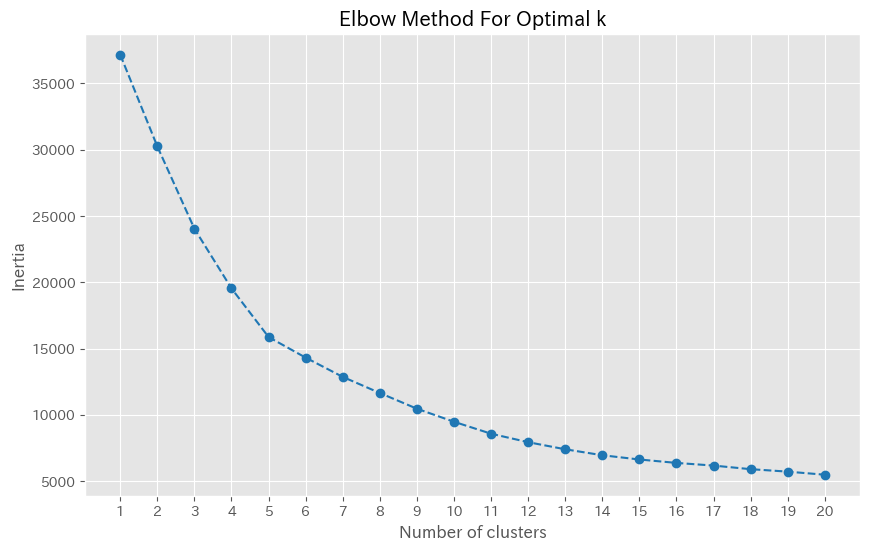

クラスタリング完了。新しい特徴量 'CLUSTER_all' を追加しました。
各クラスタのサンプル数:
CLUSTER_all
2    4979
0    2577
1    1014
5     333
3     297
4      91
Name: count, dtype: int64


,data_count,mean,std,kurtosis,min,q25,median,q75,max,category
CLUSTER_all,,,,,,,,,,
0,2577,115.503040,113.330693,3.451364,20.083333,38.750000,70.500000,147.083333,599.583333,all
1,1014,126.432857,129.200585,2.385680,20.333333,37.937500,71.583333,160.937500,596.166667,all
2,4979,88.228911,94.731722,7.082186,20.083333,30.833333,51.250000,104.250000,598.000000,all
3,297,152.207351,140.998601,0.839033,20.333333,44.583333,94.000000,211.833333,587.916667,all
4,91,88.440476,97.531888,6.255981,20.333333,32.208333,51.166667,89.250000,546.416667,all
5,333,92.835085,108.119929,6.525358,20.166667,31.083333,48.250000,107.166667,576.833333,all


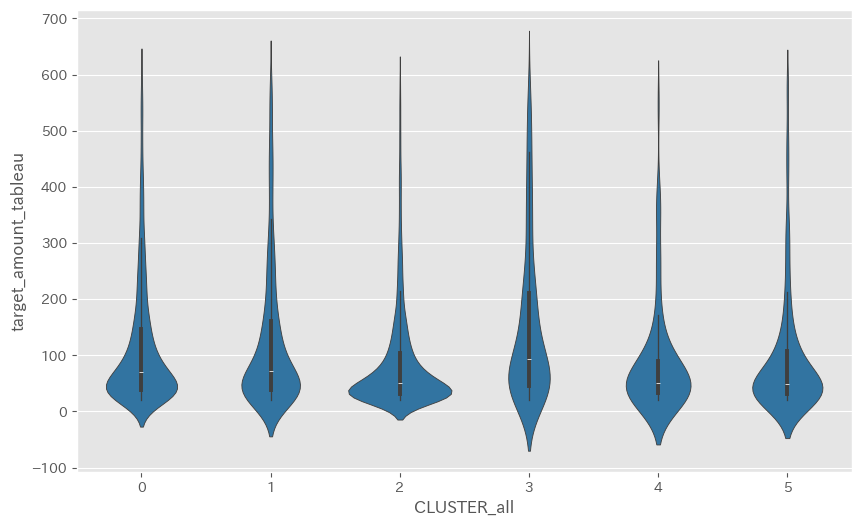

In [61]:
cuisine = "all"
html_string = f"<h2><span style='font-size:20px; font-weight:bold;'>{cuisine},\n{clustering_features}</span></h2>"
display(HTML(html_string))
stats_all = kmean_by_cat(aggregated_df,cuisine,clustering_features)
stats_all

In [62]:
stats_all

,data_count,mean,std,kurtosis,min,q25,median,q75,max,category
CLUSTER_all,,,,,,,,,,
0,2577,115.503040,113.330693,3.451364,20.083333,38.750000,70.500000,147.083333,599.583333,all
1,1014,126.432857,129.200585,2.385680,20.333333,37.937500,71.583333,160.937500,596.166667,all
2,4979,88.228911,94.731722,7.082186,20.083333,30.833333,51.250000,104.250000,598.000000,all
3,297,152.207351,140.998601,0.839033,20.333333,44.583333,94.000000,211.833333,587.916667,all
4,91,88.440476,97.531888,6.255981,20.333333,32.208333,51.166667,89.250000,546.416667,all
5,333,92.835085,108.119929,6.525358,20.166667,31.083333,48.250000,107.166667,576.833333,all


### 全カテゴリ、Base + α　でクラスタリング

In [31]:
# cuisine = "all"

# vals = ['RATING_CNT', 'RATING_SCORE','IS_FAMILY_FRIENDLY',
#        'IS_FRIEND_FRIENDLY', 'IS_ALONE_FRIENDLY', 'DINNER_INFO', 'LUNCH_INFO','DINNER_PRICE', 'LUNCH_PRICE',
#        'HOLIDAY', 'HOME_PAGE_URL', 'PHONE_NUM', 'AGE_RESTAURANT',"CUISINE_CAT_origin_num"]

# for v in vals:
#     clustering_features.append(v)
#     html_string = f"<h2><span style='font-size:20px; font-weight:bold;'>{cuisine},\n{clustering_features}</span></h2>"
#     display(HTML(html_string))
#     stats_all = kmean_by_cat(aggregated_df,cuisine,clustering_features)
#     print(stats_all)
#     clustering_features.pop()

In [32]:
stats_cat = pd.DataFrame()
# for cuisine in cuisine_cat:
#     if len(aggregated_df[aggregated_df[cuisine]==1]) < 30:
#         continue
#     print("----------------------------------------------------------")
#     html_string = f"<h2><span style='font-size:20px; font-weight:bold;'>{cuisine}</span></h2>"
#     display(HTML(html_string))
#     stats_temp = kmean_by_cat(aggregated_df[aggregated_df[cuisine]==1],cuisine,clustering_features)
#     print(stats_temp)
#     stats_cat = pd.concat([stats_cat,stats_temp])

In [33]:
stats_cat

""


In [34]:
stats_cat_origin = pd.DataFrame()

# for cuisine in cuisine_cat_origin:
#     print("----------------------------------------------------------")
#     html_string = f"<h2><span style='font-size:20px; font-weight:bold;'>{cuisine}</span></h2>"
#     display(HTML(html_string))
#     stats_temp = kmean_by_cat(aggregated_df[aggregated_df["CUISINE_CAT_origin"]==cuisine], cuisine,clustering_features)
#     stats_cat_origin = pd.concat([stats_cat_origin,stats_temp])

In [35]:
stats_cat_origin.head(100)

""


num of data =  9291
NUM_SEATS                     0.121614
RATING_CNT                    0.120566
seats_rate_count              0.115228
AVG_MONTHLY_POPULATION        0.111489
NEAREST_STATION_INFO_count    0.105231
Name: target_amount_tableau, dtype: float64


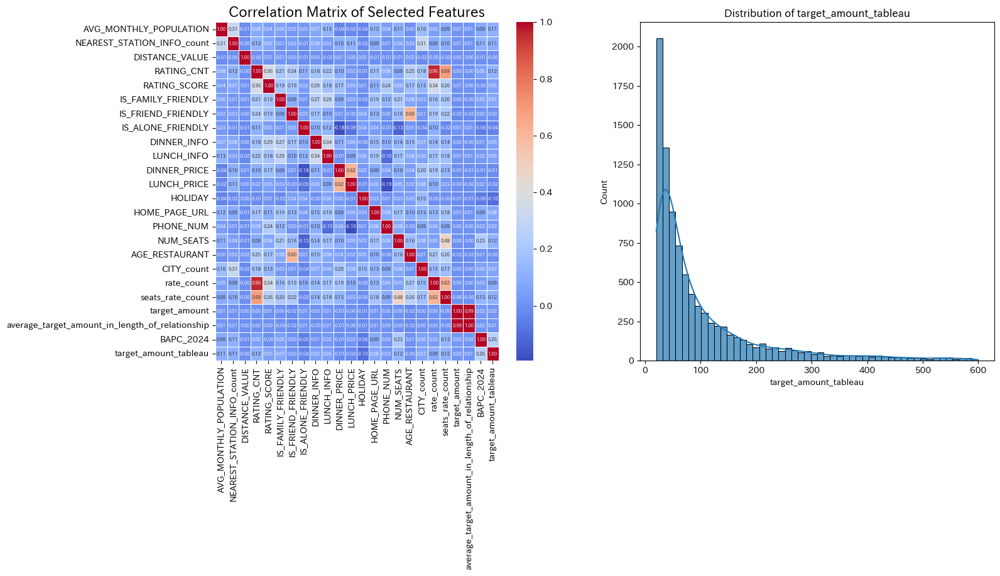

In [36]:
c = [
    'AVG_MONTHLY_POPULATION',
   'NEAREST_STATION_INFO_count',
   'DISTANCE_VALUE', 'RATING_CNT', 'RATING_SCORE', 'IS_FAMILY_FRIENDLY',
   'IS_FRIEND_FRIENDLY', 'IS_ALONE_FRIENDLY', 'DINNER_INFO', 'LUNCH_INFO','DINNER_PRICE', 'LUNCH_PRICE',
   'HOLIDAY', 'HOME_PAGE_URL', 'PHONE_NUM', 'NUM_SEATS',
   'AGE_RESTAURANT', 'CITY_count',"rate_count","seats_rate_count",#"CLUSTER",
   'target_amount', 'average_target_amount_in_length_of_relationship', 'BAPC_2024',"target_amount_tableau"
]

def calc_corr(df):
    columns_for_corr = df.select_dtypes(include=np.number).columns.tolist()
    print("num of data = ", len(df))
    # 選択した列間の相関係数を計算
    correlation_matrix = df[c].corr()
    
    # ヒートマップの描画
    # plt.figure(figsize=(10, 8)) # グラフのサイズを設定
    # sns.heatmap(
    #     correlation_matrix,
    #     annot=True,      # 各セルに相関係数の値を表示
    #     cmap='coolwarm', # カラーマップを指定 (diverging colormapが相関には適しています)
    #     fmt=".2f",       # 表示する数値のフォーマット (小数点以下2桁まで)
    #     linewidths=.5,   # セル間の境界線の太さ
    #     cbar=True,        # カラーバーを表示
    #     annot_kws={"size": 7}
    # )
    # plt.title('Correlation Matrix of Selected Features', fontsize=16)
    # plt.xticks(rotation=45, ha='right') # x軸のラベルを回転して見やすくする
    # plt.yticks(rotation=0)              # y軸のラベルの回転はそのまま
    # plt.tight_layout() # レイアウトの調整
    # plt.show()

    #相関が top5 の説明変数を表示
    target_corr = correlation_matrix['target_amount_tableau']
    abs_target_corr = target_corr.abs()
    top_5_correlations = abs_target_corr.drop(['target_amount', 'average_target_amount_in_length_of_relationship', 'BAPC_2024','target_amount_tableau']).sort_values(ascending=False).head(5)
    print(top_5_correlations)

    # ヒストグラムの作成
    # plt.hist(df['target_amount_tableau'], bins=50, edgecolor='black', alpha=0.7)
    
    # グラフのタイトルとラベルを設定
    # plt.title('Distribution of target_amount_tableau')
    # plt.xlabel('target_amount_tableau')
    # plt.ylabel('Frequency')
    # plt.xlim(0,400)
    # # グリッドを追加
    # plt.grid(axis='y', linestyle='--', alpha=0.7)
    
    # # グラフを表示
    # plt.show()


    # 1行2列のサブプロットを作成
    fig, ax = plt.subplots(1, 2, figsize=(16, 7))
    
    # 左側のサブプロットにヒートマップを描画
    sns.heatmap(
        correlation_matrix,
        annot=True,      # 各セルに相関係数の値を表示
        cmap='coolwarm', # カラーマップを指定 (diverging colormapが相関には適しています)
        fmt=".2f",       # 表示する数値のフォーマット (小数点以下2桁まで)
        linewidths=.5,   # セル間の境界線の太さ
        cbar=True,        # カラーバーを表示
        annot_kws={"size": 5},
        ax=ax[0]
    )
    #sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', ax=ax[0])
    ax[0].set_title('Correlation Matrix of Selected Features', fontsize=16)
    
    # 右側のサブプロットにヒストグラムを描画
    sns.histplot(df['target_amount_tableau'], bins=50, edgecolor='black', alpha=0.7, kde=True, ax=ax[1])
    ax[1].set_title('Distribution of target_amount_tableau')
    
    # sns.pairplot(df, vars=clustering_features, hue='CLUSTER', palette='viridis', plot_kws={'alpha': 0.1})
    # plt.suptitle('Clustering Results Pair Plot', y=1.02)
    # plt.savefig('clustering_results.png', dpi=300, bbox_inches='tight')
    # plt.show()


html_string = f"<h2><span style='font-size:20px; font-weight:bold;'>ALL</span></h2>"
display(HTML(html_string))
calc_corr(aggregated_df)

----------------------------------------------------------


num of data =  36
HOME_PAGE_URL     0.404840
AGE_RESTAURANT    0.355982
LUNCH_INFO        0.337182
RATING_SCORE      0.317635
DINNER_INFO       0.300427
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  343
RATING_SCORE              0.200632
LUNCH_INFO                0.125496
IS_ALONE_FRIENDLY         0.109491
DINNER_INFO               0.099745
AVG_MONTHLY_POPULATION    0.084967
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  70
RATING_CNT                    0.166557
DINNER_INFO                   0.156433
rate_count                    0.147298
NEAREST_STATION_INFO_count    0.146306
LUNCH_INFO                    0.139255
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  630
NEAREST_STATION_INFO_count    0.217656
RATING_CNT                    0.180454
rate_count                    0.155227
AVG_MONTHLY_POPULATION        0.100684
RATING_SCORE                  0.086946
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  93
NUM_SEATS                 0.179932
RATING_SCORE              0.144499
HOLIDAY                   0.133072
AVG_MONTHLY_POPULATION    0.125576
LUNCH_INFO                0.110976
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  440
IS_FRIEND_FRIENDLY    0.133758
RATING_SCORE          0.132591
PHONE_NUM             0.132524
DISTANCE_VALUE        0.095246
AGE_RESTAURANT        0.086457
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  10
IS_FAMILY_FRIENDLY        0.655687
CITY_count                0.524094
AVG_MONTHLY_POPULATION    0.499603
seats_rate_count          0.470212
RATING_CNT                0.439785
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  615
AVG_MONTHLY_POPULATION        0.221983
NEAREST_STATION_INFO_count    0.197922
RATING_CNT                    0.188762
seats_rate_count              0.184893
rate_count                    0.161198
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  1771
RATING_CNT                    0.182521
NUM_SEATS                     0.177715
seats_rate_count              0.174628
rate_count                    0.171417
NEAREST_STATION_INFO_count    0.112604
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  3189
NUM_SEATS                 0.167804
seats_rate_count          0.159713
RATING_CNT                0.140800
HOME_PAGE_URL             0.111064
AVG_MONTHLY_POPULATION    0.109886
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  758
AVG_MONTHLY_POPULATION        0.230706
NEAREST_STATION_INFO_count    0.214213
seats_rate_count              0.209245
RATING_CNT                    0.165807
CITY_count                    0.149840
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  360
AVG_MONTHLY_POPULATION    0.127146
HOME_PAGE_URL             0.125913
DISTANCE_VALUE            0.108310
LUNCH_PRICE               0.103692
PHONE_NUM                 0.102219
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  117
IS_FRIEND_FRIENDLY    0.255648
HOLIDAY               0.197510
AGE_RESTAURANT        0.196232
PHONE_NUM             0.187900
seats_rate_count      0.162660
Name: target_amount_tableau, dtype: float64


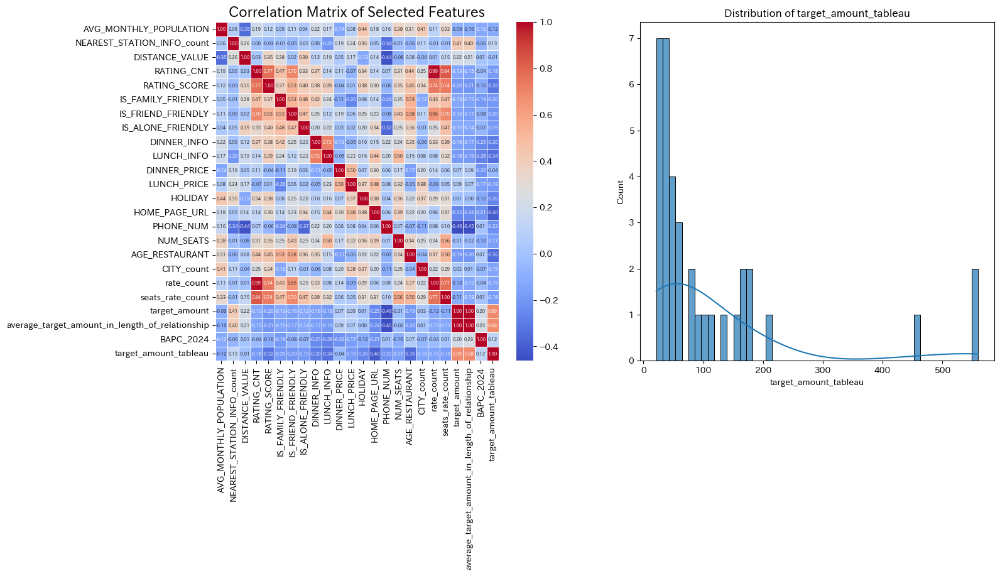

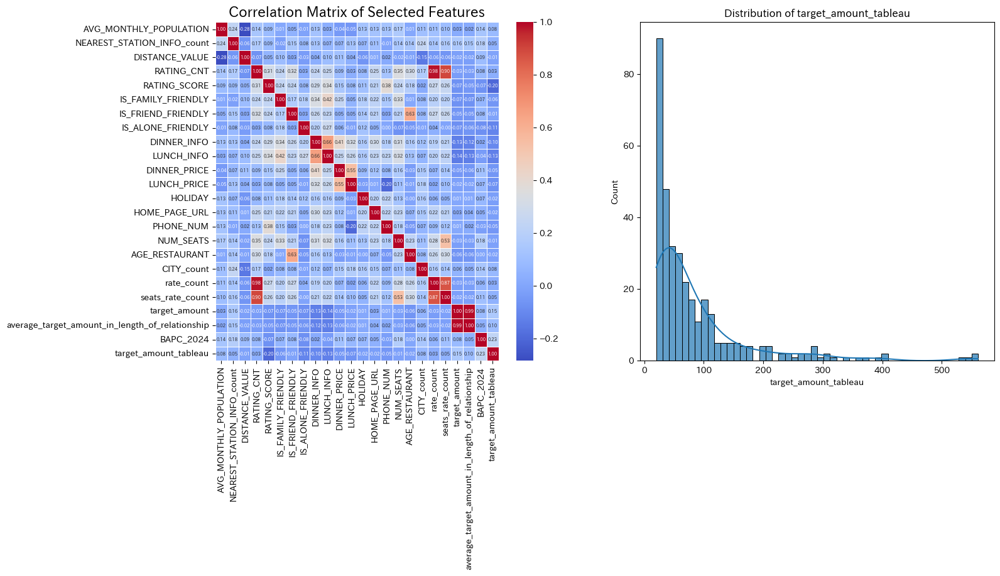

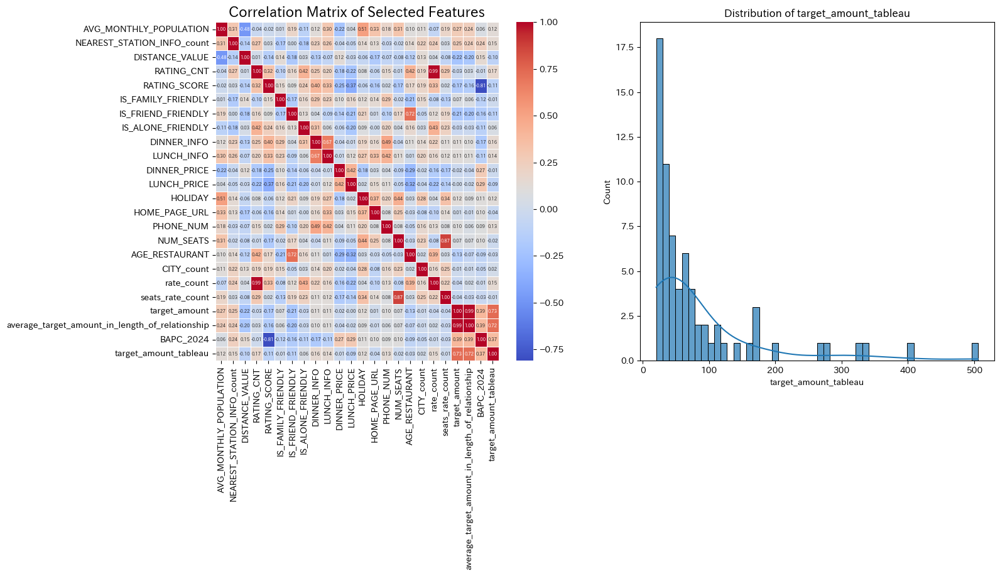

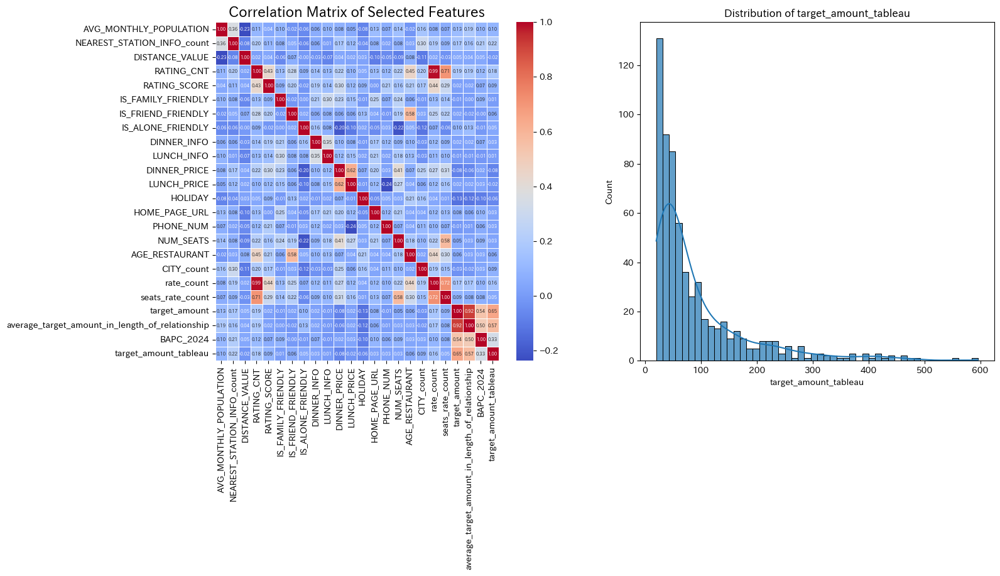

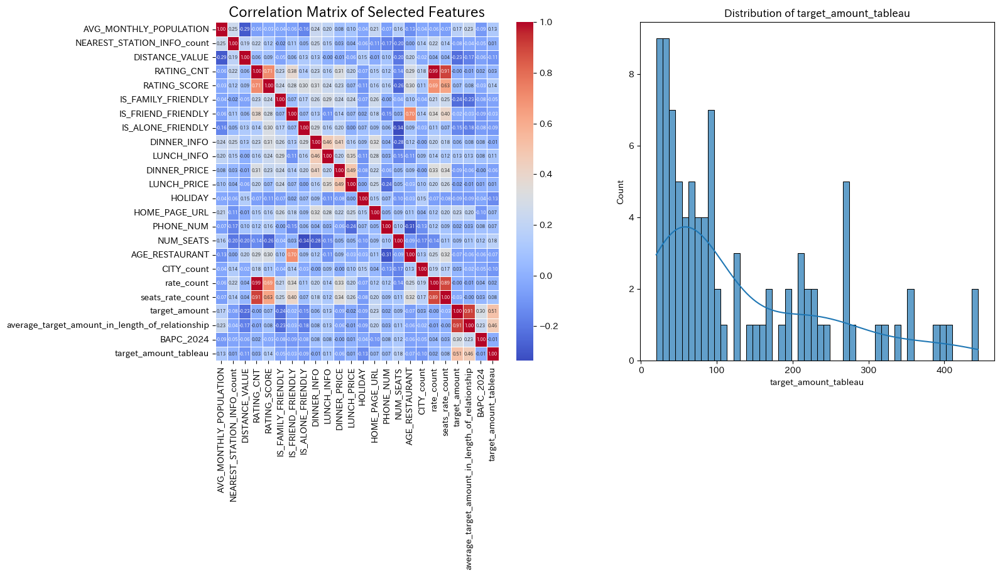

...

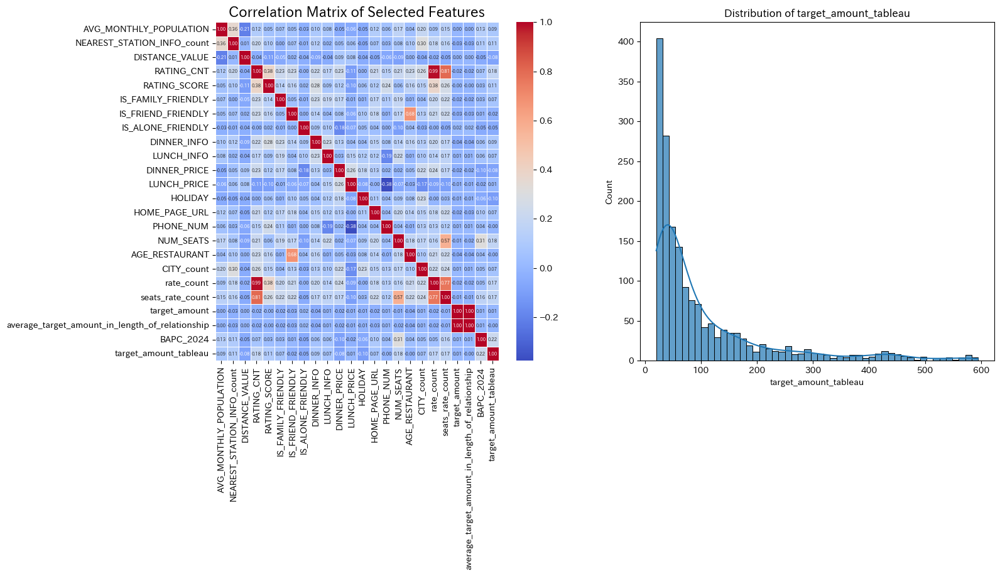

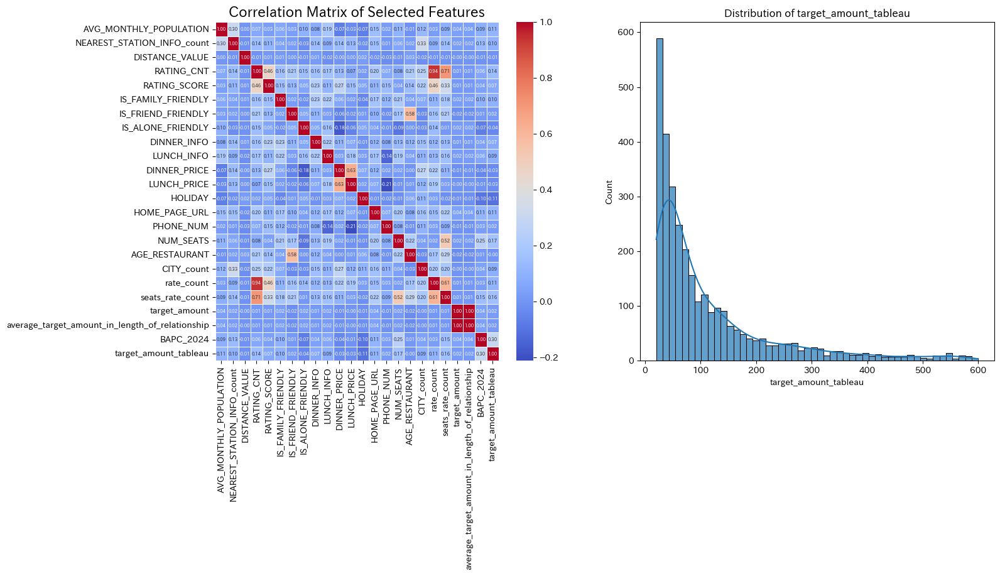

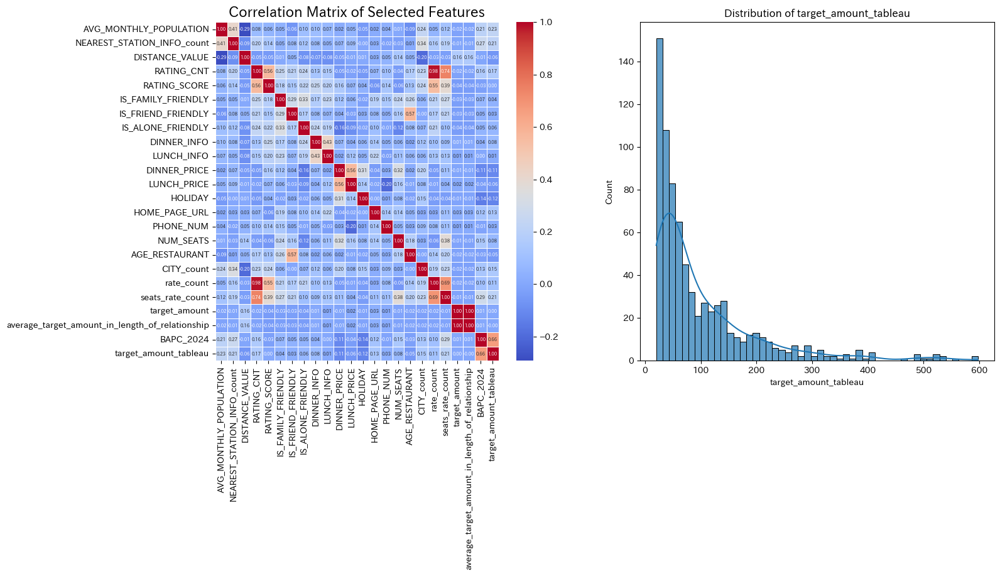

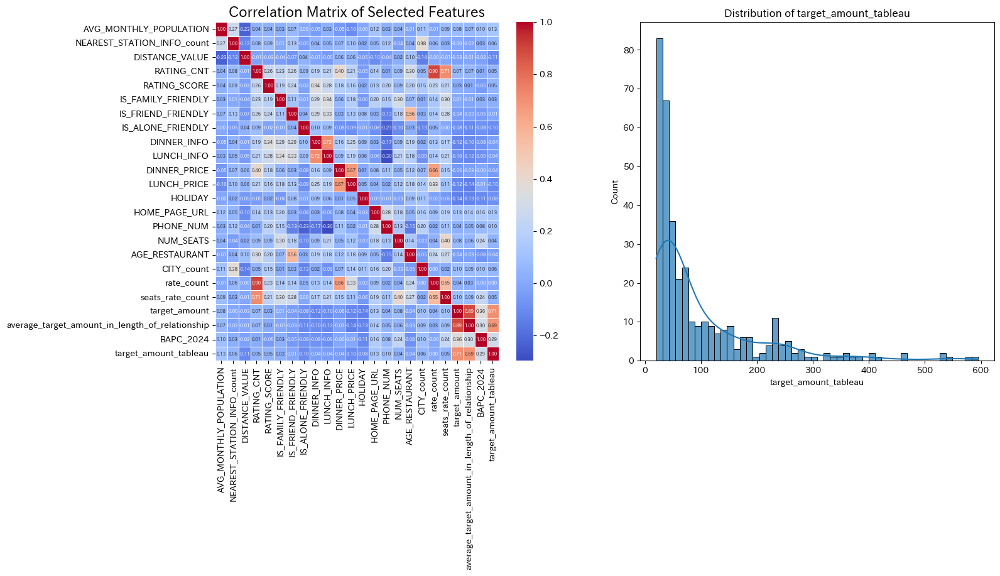

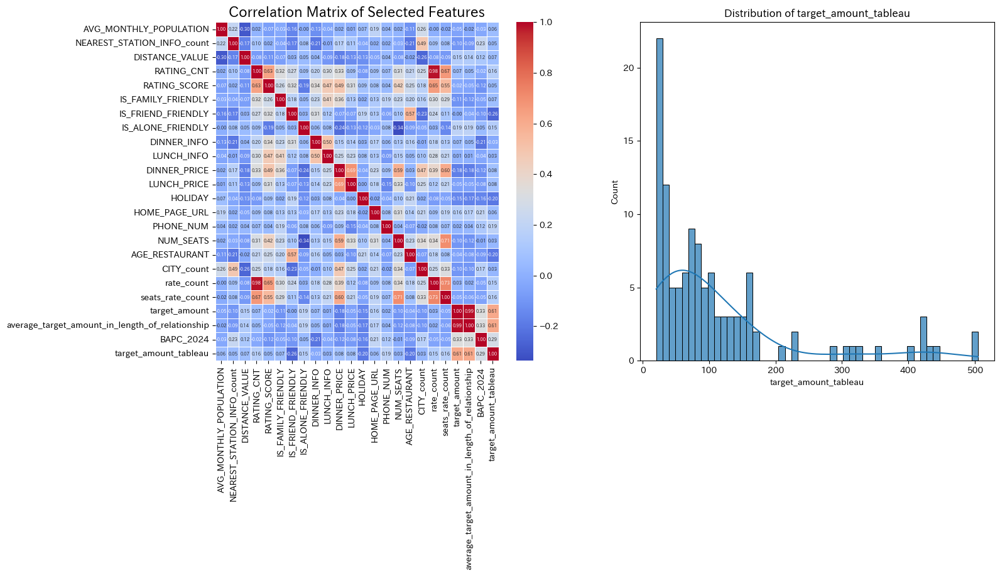

In [37]:
for cuisine in cuisine_cat:
    print("----------------------------------------------------------")
    html_string = f"<h2><span style='font-size:20px; font-weight:bold;'>{cuisine}</span></h2>"
    display(HTML(html_string))
    calc_corr(aggregated_df[aggregated_df[cuisine]==1])

## オリジナルカテゴリごとの分析

----------------------------------------------------------


num of data =  1648
RATING_CNT                    0.187938
NUM_SEATS                     0.178029
seats_rate_count              0.177233
rate_count                    0.176403
NEAREST_STATION_INFO_count    0.120919
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  864
RATING_CNT          0.196312
HOME_PAGE_URL       0.187447
NUM_SEATS           0.183923
rate_count          0.170663
seats_rate_count    0.165548
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  553
AVG_MONTHLY_POPULATION        0.300536
NEAREST_STATION_INFO_count    0.237535
seats_rate_count              0.208726
CITY_count                    0.192614
RATING_CNT                    0.154219
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  443
NUM_SEATS                 0.209350
seats_rate_count          0.180522
LUNCH_PRICE               0.075284
LUNCH_INFO                0.074555
AVG_MONTHLY_POPULATION    0.072564
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  395
NEAREST_STATION_INFO_count    0.306711
RATING_CNT                    0.213738
rate_count                    0.184955
seats_rate_count              0.119559
AVG_MONTHLY_POPULATION        0.111090
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  370
NEAREST_STATION_INFO_count    0.161234
IS_ALONE_FRIENDLY             0.140015
seats_rate_count              0.137320
AVG_MONTHLY_POPULATION        0.134475
NUM_SEATS                     0.127345
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  335
NEAREST_STATION_INFO_count    0.193180
AVG_MONTHLY_POPULATION        0.192972
seats_rate_count              0.141019
RATING_CNT                    0.140647
CITY_count                    0.140591
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  304
RATING_SCORE         0.156674
LUNCH_INFO           0.151918
DINNER_INFO          0.132074
IS_ALONE_FRIENDLY    0.105578
DINNER_PRICE         0.090853
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  288
seats_rate_count    0.345886
NUM_SEATS           0.248761
HOME_PAGE_URL       0.210486
DINNER_PRICE        0.203185
RATING_CNT          0.188481
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  207
seats_rate_count          0.226662
RATING_CNT                0.205348
NUM_SEATS                 0.194738
rate_count                0.186580
AVG_MONTHLY_POPULATION    0.184431
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  148
RATING_SCORE          0.338623
AGE_RESTAURANT        0.287980
IS_FRIEND_FRIENDLY    0.270143
RATING_CNT            0.260094
IS_FAMILY_FRIENDLY    0.241038
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  137
rate_count                0.242190
RATING_CNT                0.229533
AVG_MONTHLY_POPULATION    0.190441
DINNER_PRICE              0.184803
seats_rate_count          0.131467
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  135
seats_rate_count    0.292960
HOME_PAGE_URL       0.232176
RATING_CNT          0.209341
rate_count          0.205251
DINNER_INFO         0.196945
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  130
HOLIDAY           0.143390
LUNCH_INFO        0.138563
RATING_CNT        0.125307
rate_count        0.121849
AGE_RESTAURANT    0.113157
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  123
NUM_SEATS                 0.364273
HOME_PAGE_URL             0.199400
DISTANCE_VALUE            0.178493
LUNCH_INFO                0.174559
AVG_MONTHLY_POPULATION    0.132442
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  113
DISTANCE_VALUE            0.188052
IS_FRIEND_FRIENDLY        0.169680
AGE_RESTAURANT            0.129393
AVG_MONTHLY_POPULATION    0.127021
IS_FAMILY_FRIENDLY        0.124223
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  108
NEAREST_STATION_INFO_count    0.327614
HOME_PAGE_URL                 0.223796
AVG_MONTHLY_POPULATION        0.205093
LUNCH_PRICE                   0.194908
DINNER_PRICE                  0.155121
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  107
IS_FRIEND_FRIENDLY    0.226744
PHONE_NUM             0.216974
HOLIDAY               0.202020
AGE_RESTAURANT        0.179195
seats_rate_count      0.167721
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  104
RATING_SCORE          0.407002
LUNCH_INFO            0.296392
HOLIDAY               0.206506
DINNER_PRICE          0.205279
IS_FAMILY_FRIENDLY    0.142771
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  102
DINNER_INFO               0.189763
IS_FAMILY_FRIENDLY        0.175074
AVG_MONTHLY_POPULATION    0.165626
LUNCH_INFO                0.154048
HOLIDAY                   0.153759
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  93
CITY_count                    0.201109
seats_rate_count              0.186552
LUNCH_INFO                    0.171337
NEAREST_STATION_INFO_count    0.160341
RATING_CNT                    0.150801
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  87
rate_count          0.367618
RATING_CNT          0.339410
seats_rate_count    0.298536
PHONE_NUM           0.237369
RATING_SCORE        0.178694
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  77
RATING_CNT                0.270236
rate_count                0.268771
seats_rate_count          0.266887
AVG_MONTHLY_POPULATION    0.174993
HOME_PAGE_URL             0.171255
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  73
seats_rate_count      0.572482
NUM_SEATS             0.535746
IS_FAMILY_FRIENDLY    0.470314
CITY_count            0.447367
RATING_CNT            0.399069
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  73
RATING_CNT      0.273824
rate_count      0.262064
LUNCH_INFO      0.232782
RATING_SCORE    0.226169
HOLIDAY         0.200383
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  69
seats_rate_count          0.425320
AVG_MONTHLY_POPULATION    0.388316
RATING_CNT                0.356751
rate_count                0.344921
NUM_SEATS                 0.314648
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  67
AVG_MONTHLY_POPULATION    0.461700
NUM_SEATS                 0.449287
seats_rate_count          0.299143
DISTANCE_VALUE            0.218970
HOME_PAGE_URL             0.213519
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  64
NUM_SEATS           0.542881
seats_rate_count    0.479414
RATING_SCORE        0.272381
AGE_RESTAURANT      0.263098
RATING_CNT          0.230370
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  63
AVG_MONTHLY_POPULATION    0.273720
LUNCH_INFO                0.246189
seats_rate_count          0.228633
RATING_CNT                0.212903
rate_count                0.203660
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  62
NUM_SEATS                 0.482159
seats_rate_count          0.348502
AVG_MONTHLY_POPULATION    0.327647
HOME_PAGE_URL             0.315378
DINNER_PRICE              0.277656
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  60
seats_rate_count    0.229379
LUNCH_PRICE         0.169577
RATING_CNT          0.156529
DINNER_INFO         0.150511
rate_count          0.132673
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  57
NEAREST_STATION_INFO_count    0.448219
HOLIDAY                       0.199356
IS_ALONE_FRIENDLY             0.187274
CITY_count                    0.144706
PHONE_NUM                     0.139926
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  56
RATING_CNT            0.397921
rate_count            0.387927
seats_rate_count      0.358106
AGE_RESTAURANT        0.295619
IS_FRIEND_FRIENDLY    0.249598
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  52
seats_rate_count    0.411933
RATING_CNT          0.306676
HOME_PAGE_URL       0.256303
DINNER_PRICE        0.252385
AGE_RESTAURANT      0.234345
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  50
RATING_SCORE              0.341562
PHONE_NUM                 0.213994
AVG_MONTHLY_POPULATION    0.188755
NUM_SEATS                 0.151338
seats_rate_count          0.148797
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  49
NUM_SEATS                     0.630896
seats_rate_count              0.584155
NEAREST_STATION_INFO_count    0.374249
AVG_MONTHLY_POPULATION        0.339397
LUNCH_INFO                    0.240592
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  49
PHONE_NUM             0.404907
LUNCH_PRICE           0.338239
IS_FAMILY_FRIENDLY    0.322923
DINNER_INFO           0.247672
DISTANCE_VALUE        0.219253
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  48
AVG_MONTHLY_POPULATION    0.487354
DINNER_PRICE              0.342654
HOLIDAY                   0.250032
RATING_CNT                0.249070
seats_rate_count          0.238418
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  48
IS_FRIEND_FRIENDLY        0.372906
NUM_SEATS                 0.311907
AVG_MONTHLY_POPULATION    0.278773
AGE_RESTAURANT            0.278126
IS_FAMILY_FRIENDLY        0.253339
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  44
AVG_MONTHLY_POPULATION    0.248778
CITY_count                0.248345
LUNCH_INFO                0.211551
PHONE_NUM                 0.184778
IS_FAMILY_FRIENDLY        0.172938
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  43
seats_rate_count     0.476004
NUM_SEATS            0.386476
IS_ALONE_FRIENDLY    0.303787
RATING_CNT           0.289776
DISTANCE_VALUE       0.287130
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  43
NUM_SEATS                     0.401414
seats_rate_count              0.346541
NEAREST_STATION_INFO_count    0.272223
DINNER_PRICE                  0.199615
LUNCH_PRICE                   0.185875
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  42
AVG_MONTHLY_POPULATION    0.241420
PHONE_NUM                 0.192295
CITY_count                0.185488
RATING_CNT                0.185329
seats_rate_count          0.182586
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  41
CITY_count        0.514796
AGE_RESTAURANT    0.446630
NUM_SEATS         0.428719
LUNCH_PRICE       0.412727
DINNER_PRICE      0.395886
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  39
IS_FAMILY_FRIENDLY    0.371490
HOME_PAGE_URL         0.356488
RATING_CNT            0.353074
IS_FRIEND_FRIENDLY    0.319695
AGE_RESTAURANT        0.313044
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  39
NUM_SEATS                 0.442052
seats_rate_count          0.422427
AVG_MONTHLY_POPULATION    0.417911
RATING_CNT                0.355657
rate_count                0.342283
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  39
seats_rate_count              0.743375
RATING_CNT                    0.734473
rate_count                    0.685278
NEAREST_STATION_INFO_count    0.610751
DISTANCE_VALUE                0.543490
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  37
DISTANCE_VALUE    0.336695
CITY_count        0.306777
HOLIDAY           0.192034
AGE_RESTAURANT    0.154566
LUNCH_INFO        0.136877
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  33
IS_ALONE_FRIENDLY         0.365137
AVG_MONTHLY_POPULATION    0.306674
IS_FRIEND_FRIENDLY        0.277885
DISTANCE_VALUE            0.220452
PHONE_NUM                 0.219803
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  32
rate_count                    0.551207
RATING_CNT                    0.539565
NEAREST_STATION_INFO_count    0.477492
seats_rate_count              0.347581
RATING_SCORE                  0.263949
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  31
NUM_SEATS             0.251670
IS_FRIEND_FRIENDLY    0.216943
LUNCH_INFO            0.213293
IS_FAMILY_FRIENDLY    0.194846
IS_ALONE_FRIENDLY     0.193680
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  30
LUNCH_INFO     0.445301
NUM_SEATS      0.418396
DINNER_INFO    0.415798
PHONE_NUM      0.365901
CITY_count     0.275674
Name: target_amount_tableau, dtype: float64


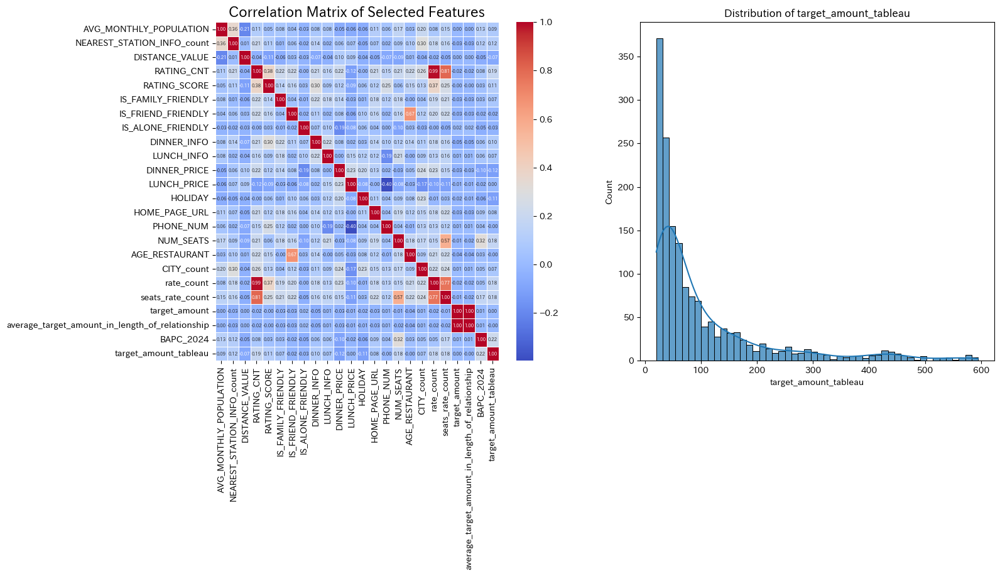

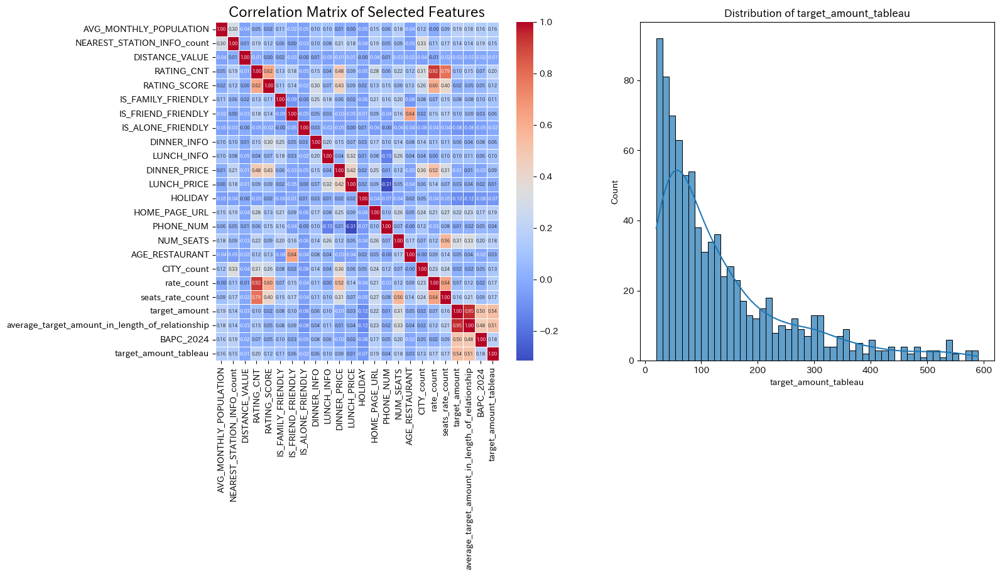

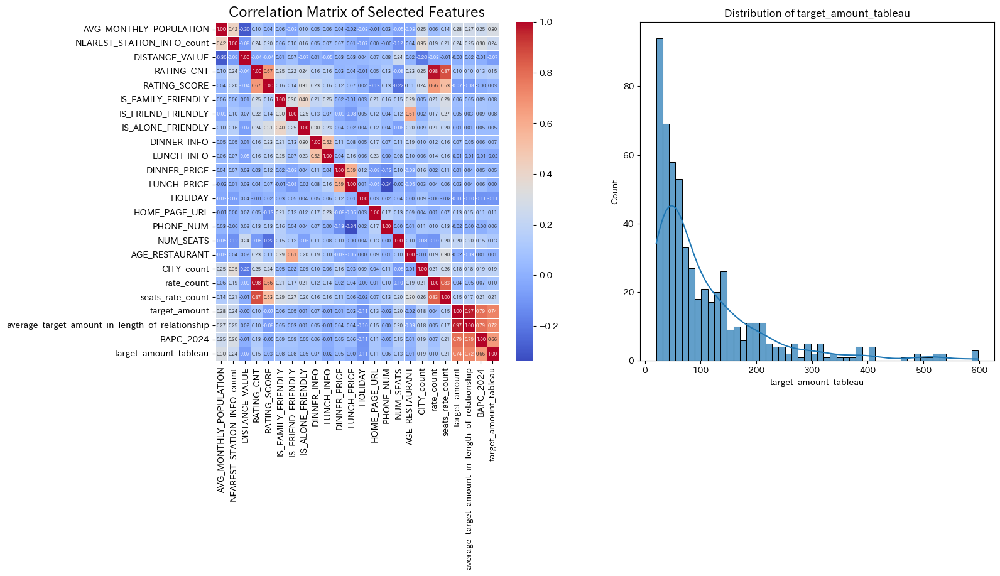

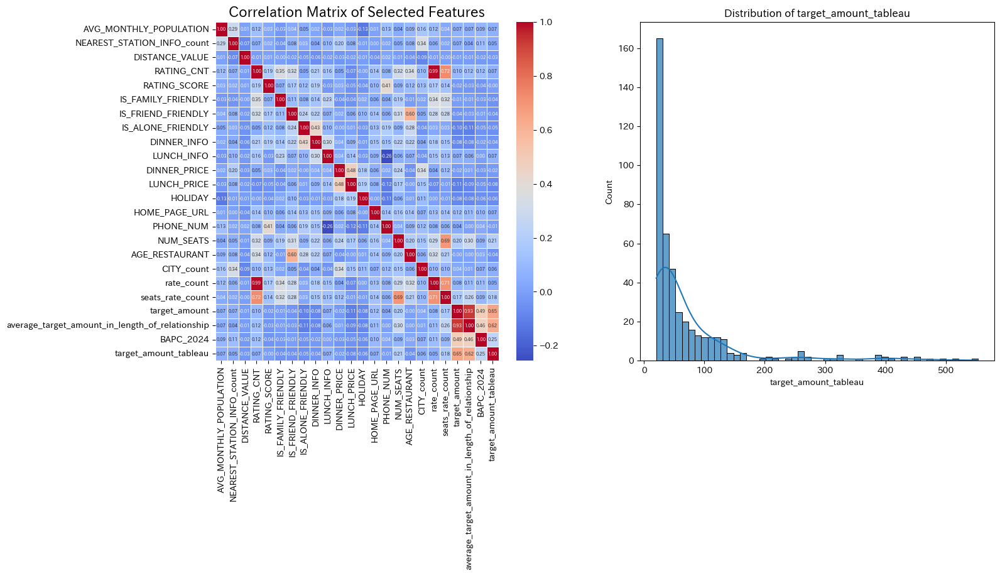

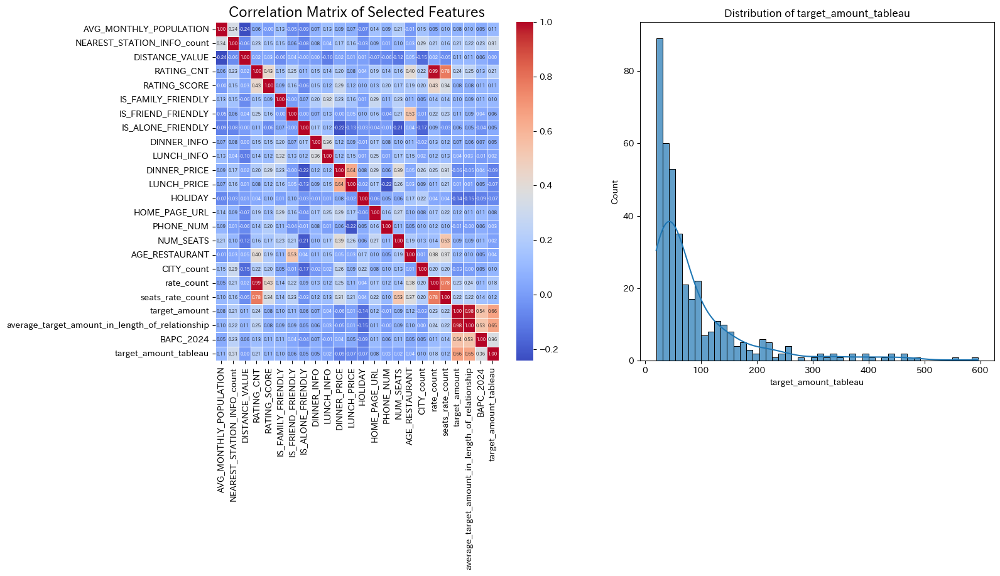

...

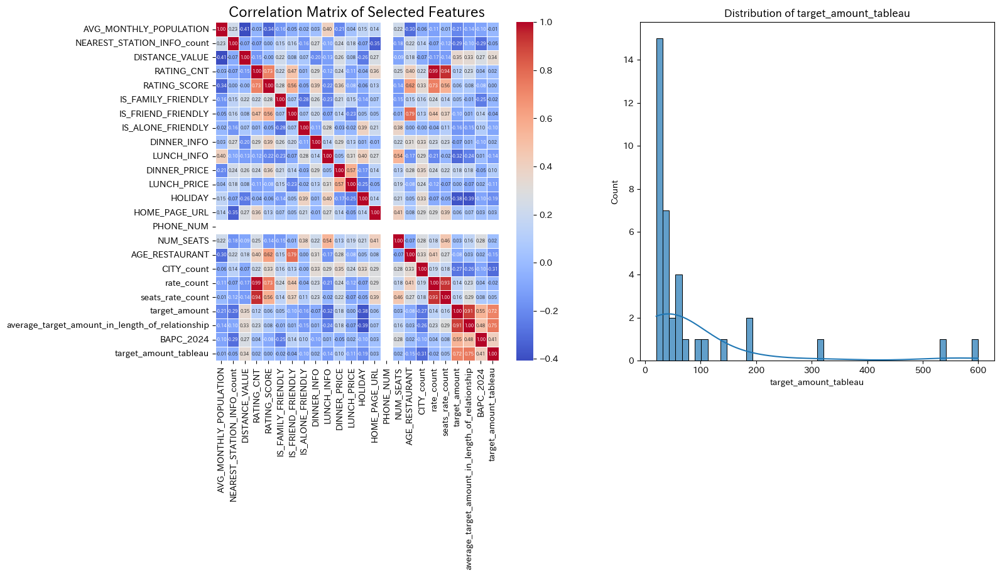

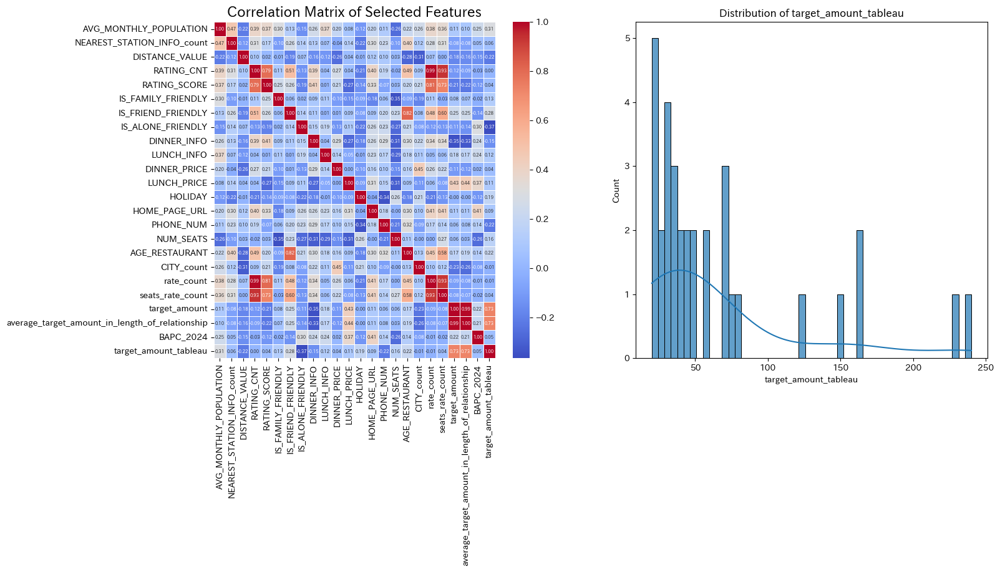

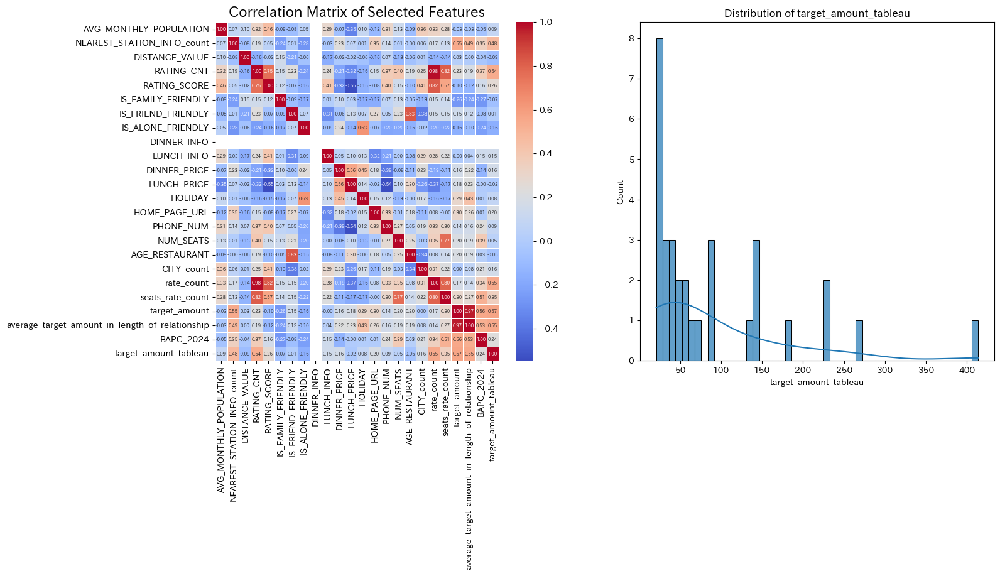

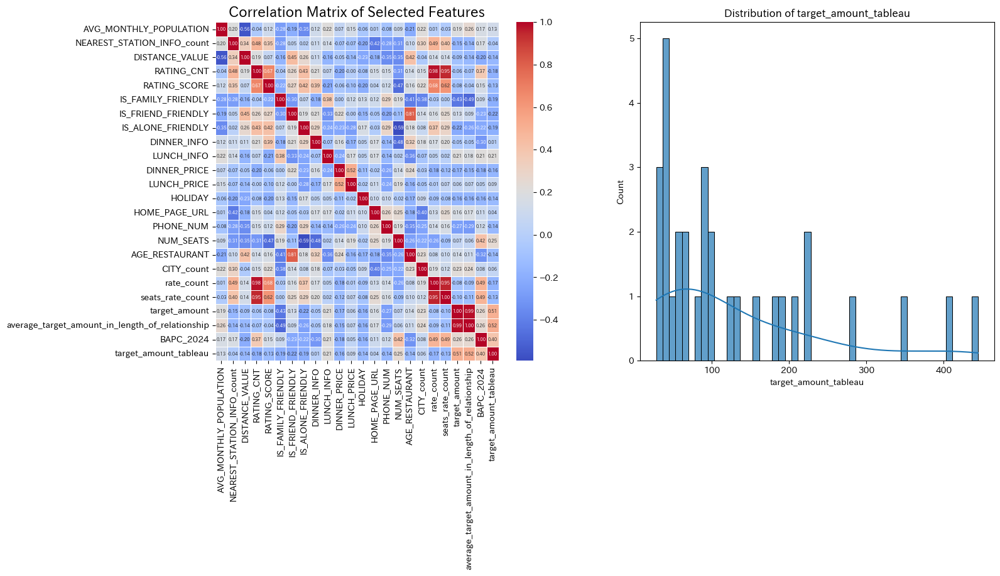

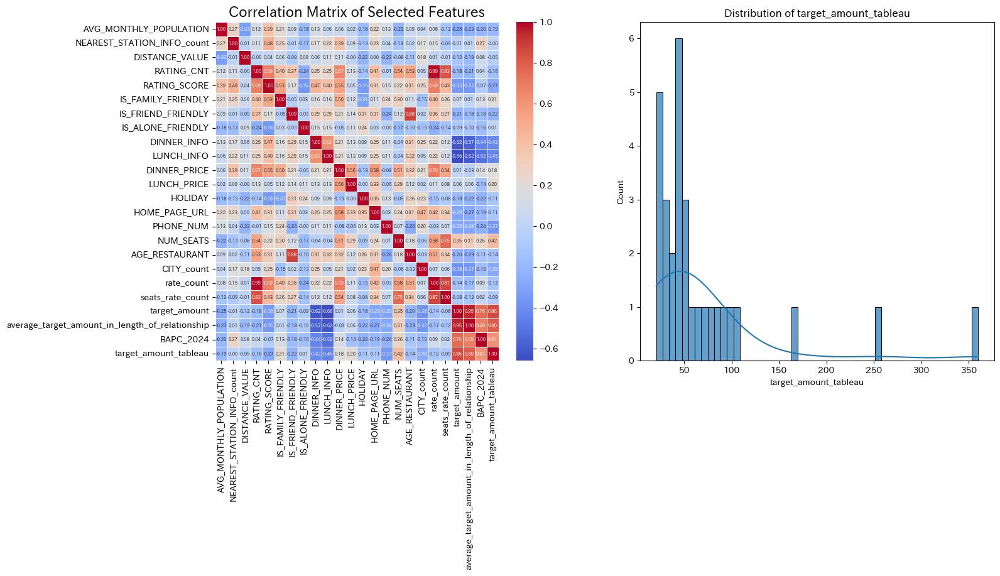

In [38]:
for cuisine in cuisine_cat_origin:
    print("----------------------------------------------------------")
    html_string = f"<h2><span style='font-size:20px; font-weight:bold;'>{cuisine}</span></h2>"
    display(HTML(html_string))
    calc_corr(aggregated_df[aggregated_df["CUISINE_CAT_origin"]==cuisine])

In [39]:
## クラスターごとの分析

In [58]:
aggregated_df[aggregated_df["CLUSTER_all"]==3].sort_values(by="target_amount_tableau",ascending=False)

,KEY,target_amount,target_amount_tableau,AVG_MONTHLY_POPULATION,TABELOG_ID,SAKAYA_DEALER_NAME,RST_TITLE,NEAREST_STATION_INFO,NEAREST_STATION_INFO_count,DISTANCE_VALUE,RATING_CNT,RATING_SCORE,IS_FAMILY_FRIENDLY,IS_FRIEND_FRIENDLY,IS_ALONE_FRIENDLY,DINNER_INFO,LUNCH_INFO,DINNER_PRICE,LUNCH_PRICE,HOLIDAY,HOME_PAGE_URL,PHONE_NUM,NUM_SEATS,AGE_RESTAURANT,CITY,CITY_count,CUISINE_CAT_origin,menu,average_target_amount_in_length_of_relationship,BAPC_2024,CUISINE_CAT,CUISINE_CAT_1_bread and desert,CUISINE_CAT_1_cafe and coffee shop,CUISINE_CAT_1_cafeteria,CUISINE_CAT_1_chinese cuisine,CUISINE_CAT_1_convenience store,CUISINE_CAT_1_family restaurant,CUISINE_CAT_1_fastfood light meal,CUISINE_CAT_1_foreign ethnic cuisine,CUISINE_CAT_1_hotel and ryokan,CUISINE_CAT_1_italian cuisine,CUISINE_CAT_1_izakaya,CUISINE_CAT_1_japanese cuisine,CUISINE_CAT_1_noodles,CUISINE_CAT_1_other,CUISINE_CAT_1_restaurant,rate_count,seats_rate_count,CUISINE_CAT_num,CUISINE_CAT_origin_num,y_class,CLUSTER_all
20871,2100118-3949,1459.0,598.000000,2901.280713,13168762.0,富士らーめん,富士らーめん,浅草（つくばＥＸＰ）,1393,160.0,288.0,3.48,0.0,1.0,1.0,1.0,0.0,1499.5,749.25,0.0,0.0,1,10.0,11.0,台東区,5889.0,ラーメン,NaN,121.583333,126.083333,noodles,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,146990.310565,2880.0,13,139,high,3
15298,2100026-2495,3000.0,595.000000,4459.609149,13200737.0,シャルロッテ,シャルロッテ,蓮沼,203,133.0,4.0,3.04,0.0,0.0,0.0,0.0,0.0,1499.5,999.00,0.0,1.0,0,23.0,1.0,墨田区,3096.0,その他,"""Hot"",""ホットコーヒー"",""ホットティー"",""Cold"",""アイスコーヒー"",""アイス...",600.000000,231.750000,other,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1038.551194,92.0,14,20,high,3
19951,2100062-2528,961.0,594.833333,2904.857709,13045847.0,成城裏市場萬福c,成城裏市場 萬福,成城学園前,221,400.0,41.0,3.26,1.0,1.0,0.0,1.0,0.0,3499.5,1499.50,0.0,1.0,1,40.0,17.0,世田谷区,6748.0,居酒屋,NaN,80.083333,40.041667,izakaya,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,15096.346556,1640.0,11,178,high,3
8895,2100014-5600219,1015.0,594.333333,3333.811417,13237810.0,めぐろの安兵衛(目黒)◆,めぐろの安兵衛,目黒,606,400.0,251.0,3.50,1.0,0.0,1.0,1.0,0.0,1499.5,1499.50,0.0,1.0,1,30.0,6.0,目黒区,3306.0,居酒屋,NaN,84.583333,42.041667,izakaya,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,131829.906250,7530.0,11,178,high,3
16129,2100039-71056,1016.0,590.333333,3864.323359,13198865.0,kabun-chika,KABUN-CHIKA,赤坂,830,240.0,153.0,3.53,0.0,0.0,0.0,1.0,0.0,8999.5,1499.50,0.0,0.0,1,40.0,9.0,港区,11198.0,焼肉,"""WHISKY"",""角ハイボール"",""コーラハイボール"",""ジンジャーハイボール"",""JAP...",84.666667,68.958333,japanese cuisine,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,83861.950220,6120.0,12,212,high,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1623,2100008-661584,236.0,20.083333,3834.432752,13224316.0,太子堂 イサーンキッチン,タイ東北料理 イサーン・キッチン,三軒茶屋,812,160.0,259.0,3.47,0.0,0.0,0.0,1.0,1.0,2499.5,749.25,0.0,0.0,1,26.0,7.0,世田谷区,6748.0,タイ料理,NaN,19.666667,13.958333,foreign ethnic cuisine,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,130300.816773,6734.0,8,88,low,3
17473,2100044-6422,219.0,20.083333,3851.315323,13231957.0,★◆銀座ローマイヤ,ローマイヤレストラン 銀座店,銀座,1859,160.0,87.0,3.44,1.0,0.0,1.0,1.0,1.0,5499.5,1499.50,1.0,1.0,1,30.0,6.0,中央区,8669.0,ダイニングバー,"""◆◇◆ 種類豊富なドイツビール ◆◇◆"",""ソムリエ厳選！相性抜群ドイツビール！"",""◆◇...",19.909091,13.625000,bar,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,41909.402144,2610.0,0,91,low,3
1925,2100008-668102,238.0,20.083333,2736.521437,13186225.0,東昇餃子楼 市谷店,中国料理 東昇餃子楼 市ヶ谷店,市ケ谷,327,260.0,24.0,3.08,0.0,0.0,0.0,1.0,1.0,3499.5,749.25,0.0,1.0,1,46.0,9.0,新宿区,10057.0,餃子,"""ビール"",""生ビール（中）"",""小生ビール"",""瓶ビール"",""ドライゼロ"",""紹興酒"",""...",19.833333,9.458333,chinese cuisine,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,6652.192744,1104.0,4,248,low,3
4949,2100008-722170,200.0,20.083333,3857.276604,13265623.0,三崎町炭焼き和ビストロだいご家,炭焼き和ビストロ だいご家,水道橋,543,160.0,40.0,3.26,1.0,0.0,0.0,1.0,1.0,4499.5,749.25,0.0,0.0,1,30.0,3.0,千代田区,7395.0,ビストロ,"""ビール"",""サッポロ黒ラベル 中"",""サッポロ黒ラベル 大"",""樽詰！ホワイトベルグ"",""...",16.666667,37.541667,italian cuisine,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,14728.142982,1200.0,10,119,low,3


----------------------------------------------------------


num of data =  1426
HOLIDAY                       0.128313
RATING_CNT                    0.086312
seats_rate_count              0.083604
NEAREST_STATION_INFO_count    0.083587
NUM_SEATS                     0.075430
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  511
seats_rate_count    0.107561
HOLIDAY             0.104559
LUNCH_INFO          0.103569
RATING_SCORE        0.097163
RATING_CNT          0.091436
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  5453
AVG_MONTHLY_POPULATION    0.105238
seats_rate_count          0.104671
RATING_CNT                0.097759
NUM_SEATS                 0.095235
HOLIDAY                   0.088001
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  219
HOLIDAY                       0.170089
IS_FRIEND_FRIENDLY            0.151916
PHONE_NUM                     0.127308
DINNER_PRICE                  0.094568
NEAREST_STATION_INFO_count    0.091354
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  1678
RATING_CNT                    0.161372
seats_rate_count              0.138795
rate_count                    0.131870
HOLIDAY                       0.100002
NEAREST_STATION_INFO_count    0.094348
Name: target_amount_tableau, dtype: float64
----------------------------------------------------------


num of data =  4
AGE_RESTAURANT                0.902930
RATING_SCORE                  0.777640
LUNCH_PRICE                   0.776164
DINNER_PRICE                  0.749321
NEAREST_STATION_INFO_count    0.651728
Name: target_amount_tableau, dtype: float64


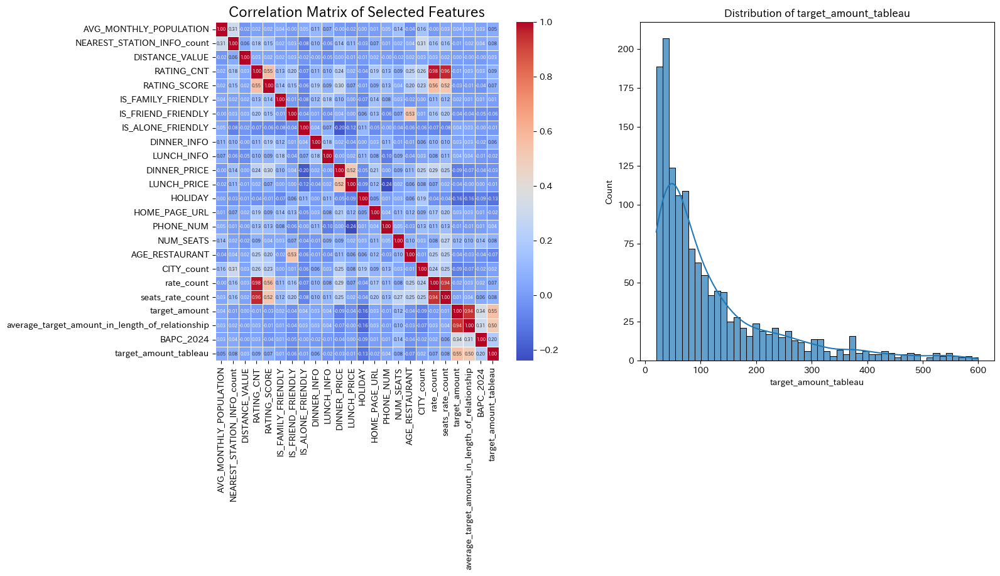

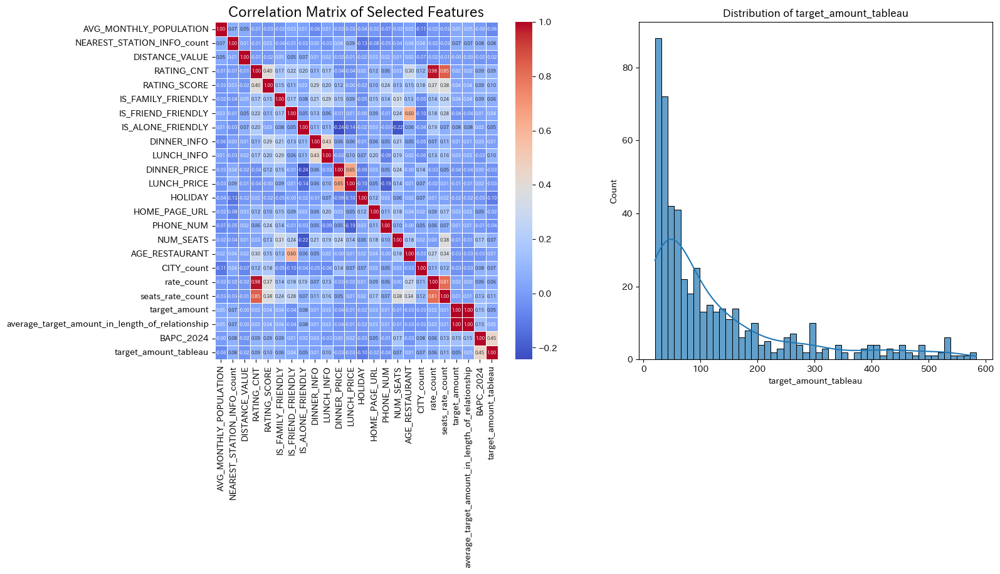

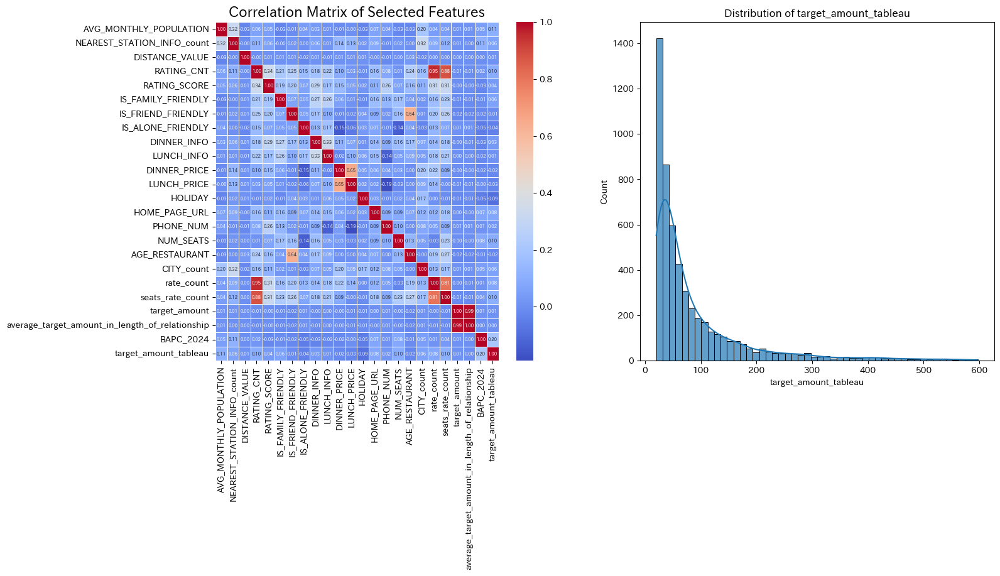

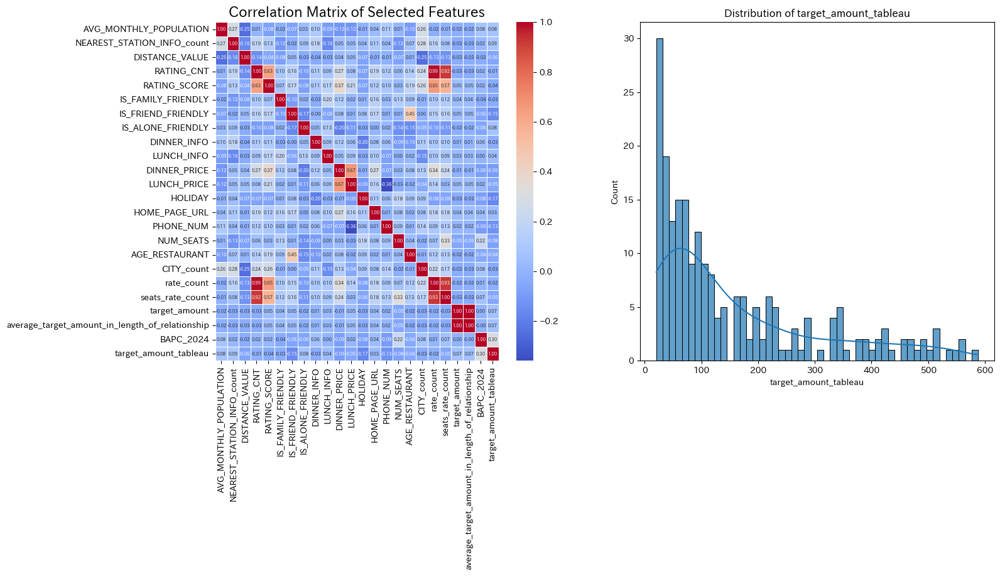

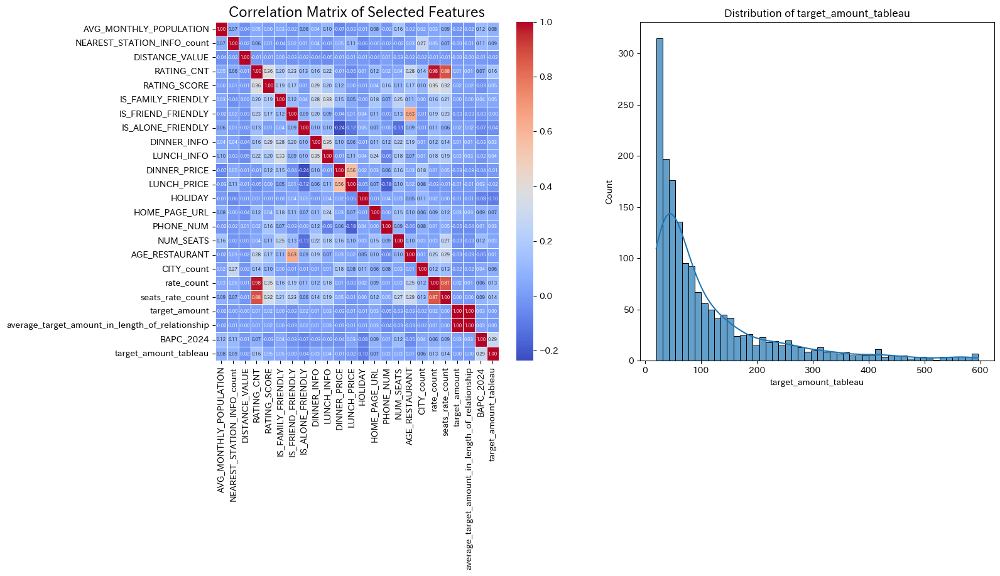

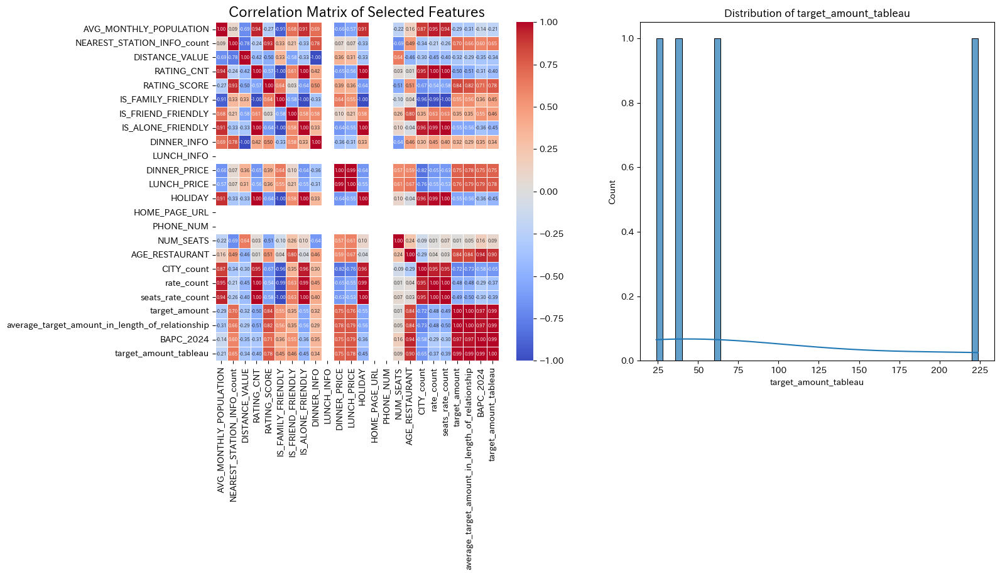

In [40]:
cluster = aggregated_df["CLUSTER_all"].unique()
for clstr in cluster:
    print("----------------------------------------------------------")
    html_string = f"<h2><span style='font-size:20px; font-weight:bold;'>CLUSTER{clstr}</span></h2>"
    display(HTML(html_string))
    calc_corr(aggregated_df[aggregated_df["CLUSTER_all"]==clstr])

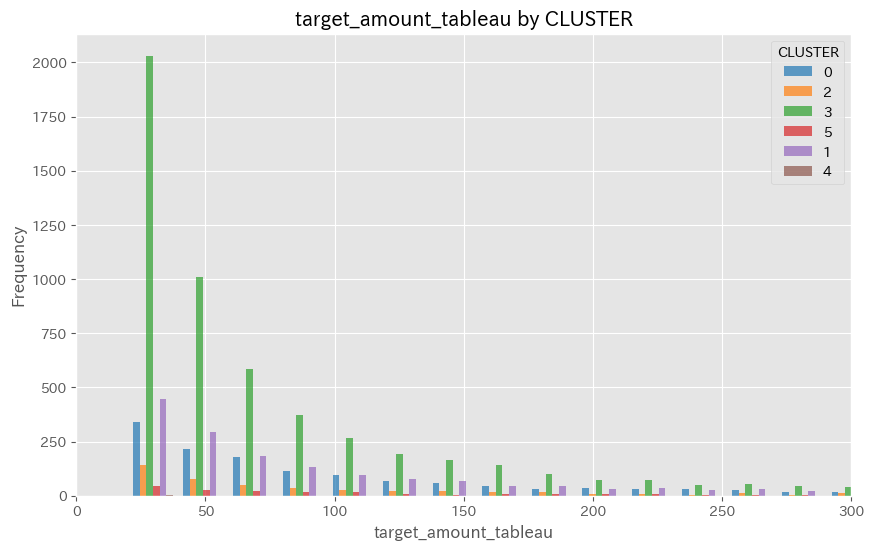

In [41]:
# スタイル設定
plt.style.use('ggplot')
sns.set_palette("tab10") # Seabornのカラーパレットを使用

# クラスターごとのデータのリストを作成
clusters = aggregated_df["CLUSTER_all"].unique()
data_by_cluster = [aggregated_df[aggregated_df["CLUSTER_all"] == c]["target_amount_tableau"] for c in clusters]

# ヒストグラムの描画
plt.figure(figsize=(10, 6))
plt.hist(data_by_cluster,
         bins=30, # ビンの数を設定
         label=clusters,
         alpha=0.7, # 透過度
         rwidth=0.8) # ビンの幅を調整

# 凡例、タイトル、ラベルを追加
plt.legend(title="CLUSTER")
plt.title("target_amount_tableau by CLUSTER")
plt.xlabel("target_amount_tableau")
plt.ylabel("Frequency")
plt.xlim(0, 300)
# グラフを表示
plt.show()

In [42]:
# 特徴量のクラスタリング
# print("\n=== 特徴量のクラスタリング ===")
# clustering_features = ['AVG_MONTHLY_POPULATION', 'RATING_CNT', 'RATING_SCORE', 'NUM_SEATS']
# X_for_clustering = aggregated_df[clustering_features]

# # クラスタリング用のデータを標準化
# scaler_clustering = StandardScaler()
# X_scaled_clustering = scaler_clustering.fit_transform(X_for_clustering)

# # === クラスタリングのハイパーパラメータチューニング ===
# print("\n=== クラスタリングのハイパーパラメータチューニング ===")

# def objective_kmeans(trial, data):
#     n_clusters = trial.suggest_int('n_clusters', 2, 10)
#     model = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
#     labels = model.fit_predict(data)
#     if len(np.unique(labels)) < 2:
#         return -1.0
#     return silhouette_score(data, labels)

# def objective_dbscan(trial, data):
#     eps = trial.suggest_float('eps', 0.1, 2.0)
#     min_samples = trial.suggest_int('min_samples', 2, 20)
#     model = DBSCAN(eps=eps, min_samples=min_samples)
#     labels = model.fit_predict(data)
#     # クラスタ数が1以下（すべてノイズなど）の場合はスコアを-1とする
#     unique_labels = np.unique(labels)
#     if len(unique_labels) < 2:
#         return -1.0
#     # ノイズポイントを除外して評価
#     if -1 in unique_labels:
#         filtered_indices = labels != -1
#         # ノイズ除去後にクラスタが1つ以下になる場合
#         if len(np.unique(labels[filtered_indices])) < 2:
#             return -1.0
#         return silhouette_score(data[filtered_indices], labels[filtered_indices])
#     return silhouette_score(data, labels)

# def objective_hdbscan(trial, data):
#     min_cluster_size = trial.suggest_int('min_cluster_size', 5, 200)
#     min_samples = trial.suggest_int('min_samples', 1, 20)
#     cluster_selection_epsilon = trial.suggest_float('cluster_selection_epsilon', 0.0, 1.0)
#     model = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size, min_samples=min_samples, cluster_selection_epsilon=cluster_selection_epsilon, gen_min_span_tree=False)
#     labels = model.fit_predict(data)
#     unique_labels = np.unique(labels)
#     if len(unique_labels) < 2:
#         return -1.0
#     if -1 in unique_labels:
#         filtered_indices = labels != -1
#         if len(np.unique(labels[filtered_indices])) < 2:
#             return -1.0
#         return silhouette_score(data[filtered_indices], labels[filtered_indices])
#     return silhouette_score(data, labels)

# def objective_gaussian_mixture(trial, data):
#     n_components = trial.suggest_int('n_components', 2, 10)
#     covariance_type = trial.suggest_categorical('covariance_type', ['full', 'tied', 'diag', 'spherical'])
#     model = GaussianMixture(n_components=n_components, covariance_type=covariance_type, random_state=42)
#     labels = model.fit_predict(data)
#     if len(np.unique(labels)) < 2:
#         return -1.0
#     return silhouette_score(data, labels)

# def objective_agglomerative(trial, data):
#     n_clusters = trial.suggest_int('n_clusters', 2, 10)
#     linkage = trial.suggest_categorical('linkage', ['ward', 'complete', 'average', 'single'])
#     model = AgglomerativeClustering(n_clusters=n_clusters, linkage=linkage)
#     labels = model.fit_predict(data)
#     if len(np.unique(labels)) < 2:
#         return -1.0
#     return silhouette_score(data, labels)

# def objective_birch(trial, data):
#     n_clusters = trial.suggest_int('n_clusters', 2, 10)
#     threshold = trial.suggest_float('threshold', 0.1, 1.0)
#     branching_factor = trial.suggest_int('branching_factor', 20, 100)
#     model = Birch(n_clusters=n_clusters, threshold=threshold, branching_factor=branching_factor)
#     labels = model.fit_predict(data)
#     if len(np.unique(labels)) < 2:
#         return -1.0
#     return silhouette_score(data, labels)

# def objective_meanshift(trial, data):
#     bandwidth_estimate = estimate_bandwidth(data, quantile=0.2, n_samples=500)
#     bandwidth = trial.suggest_float('bandwidth', bandwidth_estimate * 0.5, bandwidth_estimate * 1.5)
#     model = MeanShift(bandwidth=bandwidth)
#     labels = model.fit_predict(data)
#     if len(np.unique(labels)) < 2:
#         return -1.0
#     return silhouette_score(data, labels)


# # チューニングの実行とアルゴリズムのインスタンス化
# print("\n=== チューニングされたパラメータでクラスタリングモデルを準備 ===")
# tuned_clustering_algorithms = {}
# n_trials = 10 # チューニングの試行回数を10に減らす

# def run_study(objective_func, data, n_trials):
#     study = optuna.create_study(direction='maximize')
#     for _ in tqdm(range(n_trials), desc=f"Tuning {objective_func.__name__}"):
#         study.optimize(lambda trial: objective_func(trial, data), n_trials=1)
#     return study

# # KMeans
# study_kmeans = run_study(objective_kmeans, X_scaled_clustering, n_trials)
# best_params_kmeans = study_kmeans.best_params
# tuned_clustering_algorithms['KMeans'] = KMeans(**best_params_kmeans, random_state=42, n_init=10)
# print(f"  Best params: {best_params_kmeans}, Silhouette: {study_kmeans.best_value:.4f}")

# # DBSCAN
# study_dbscan = run_study(objective_dbscan, X_scaled_clustering, n_trials)
# best_params_dbscan = study_dbscan.best_params
# tuned_clustering_algorithms['DBSCAN'] = DBSCAN(**best_params_dbscan)
# print(f"  Best params: {best_params_dbscan}, Silhouette: {study_dbscan.best_value:.4f}")

# # HDBSCAN
# study_hdbscan = run_study(objective_hdbscan, X_scaled_clustering, n_trials)
# best_params_hdbscan = study_hdbscan.best_params
# tuned_clustering_algorithms['HDBSCAN'] = hdbscan.HDBSCAN(**best_params_hdbscan, gen_min_span_tree=True)
# print(f"  Best params: {best_params_hdbscan}, Silhouette: {study_hdbscan.best_value:.4f}")

# # GaussianMixture
# study_gm = run_study(objective_gaussian_mixture, X_scaled_clustering, n_trials)
# best_params_gm = study_gm.best_params
# tuned_clustering_algorithms['GaussianMixture'] = GaussianMixture(**best_params_gm, random_state=42)
# print(f"  Best params: {best_params_gm}, Silhouette: {study_gm.best_value:.4f}")

# # AgglomerativeClustering
# study_agg = run_study(objective_agglomerative, X_scaled_clustering, n_trials)
# best_params_agg = study_agg.best_params
# tuned_clustering_algorithms['AgglomerativeClustering'] = AgglomerativeClustering(**best_params_agg)
# print(f"  Best params: {best_params_agg}, Silhouette: {study_agg.best_value:.4f}")

# # MeanShift
# study_ms = run_study(objective_meanshift, X_scaled_clustering, n_trials)
# best_params_ms = study_ms.best_params
# tuned_clustering_algorithms['MeanShift'] = MeanShift(**best_params_ms)
# print(f"  Best params: {best_params_ms}, Silhouette: {study_ms.best_value:.4f}")

# # Birch
# study_birch = run_study(objective_birch, X_scaled_clustering, n_trials)
# best_params_birch = study_birch.best_params
# tuned_clustering_algorithms['Birch'] = Birch(**best_params_birch)
# print(f"  Best params: {best_params_birch}, Silhouette: {study_birch.best_value:.4f}")




In [43]:
# evaluation_results = {}
# print("\n=== 全てのクラスタリングアルゴリズムを実行し、特徴量として追加 ===")
# for name, algorithm in tqdm(tuned_clustering_algorithms.items(), desc="クラスタリング実行と評価"):
#     column_name = f'cluster_{name.lower()}'
#     print(f"\n--- クラスタリング手法: {name} (カラム名: {column_name}) ---")
    
#     # クラスタリングの実行とカラム追加
#     labels = algorithm.fit_predict(X_scaled_clustering)
#     aggregated_df[column_name] = labels
    
#     # ノイズポイント（-1）を除外して評価
#     if -1 in np.unique(labels):
#         filtered_indices = labels != -1
#         X_eval = X_scaled_clustering[filtered_indices]
#         labels_eval = labels[filtered_indices]
#     else:
#         X_eval = X_scaled_clustering
#         labels_eval = labels

#     # クラスタ数が2以上の場合のみ評価指標を計算
#     if len(np.unique(labels_eval)) > 1:
#         silhouette = silhouette_score(X_eval, labels_eval)
#         calinski = calinski_harabasz_score(X_eval, labels_eval)
#         davies = davies_bouldin_score(X_eval, labels_eval)
#         evaluation_results[name] = {
#             'Silhouette Score': silhouette,
#             'Calinski-Harabasz Score': calinski,
#             'Davies-Bouldin Score': davies
#         }
#         print(f"  シルエットスコア: {silhouette:.4f}")
#         print(f"  Calinski-Harabaszスコア: {calinski:.4f}")
#         print(f"  Davies-Bouldinスコア: {davies:.4f}")
#     else:
#         print("  クラスタ数が1のため評価指標は計算しません。")
#         evaluation_results[name] = {
#             'Silhouette Score': 'N/A',
#             'Calinski-Harabasz Score': 'N/A',
#             'Davies-Bouldin Score': 'N/A'
#         }
    
#     print(f"  各クラスタのサンプル数:\n{aggregated_df[column_name].value_counts().sort_index()}")
    
#     # クラスタリング結果の可視化
#     sns.pairplot(aggregated_df, vars=clustering_features, hue=column_name, palette='viridis', plot_kws={'alpha': 0.6})
#     plt.suptitle(f'Clustering Results Pair Plot ({name})', y=1.02)
#     plt.savefig(f'clustering_results_{name}.png', dpi=300, bbox_inches='tight')
#     plt.show()


# # 評価結果のサマリー
# print("\n=== 全クラスタリング手法の評価結果サマリー ===")
# evaluation_df = pd.DataFrame(evaluation_results).T
# print(evaluation_df)

In [44]:
# # === クラスター別の目的変数ヒストグラムの作成 ===
# print("\n=== クラスター別の目的変数ヒストグラムの作成 ===")
# target_column_hist = 'average_target_amount_in_length_of_relationship'
# cluster_columns_for_hist = [col for col in aggregated_df.columns if col.startswith('cluster_')]

# for col_name in cluster_columns_for_hist:
#     print(f"--- {col_name} のヒストグラムを作成中 ---")
    
#     # ノイズポイント(-1)を除外したデータフレームを作成
#     plot_df = aggregated_df[aggregated_df[col_name] != -1].copy()
    
#     if plot_df.empty or plot_df[col_name].nunique() == 0:
#         print(f"  {col_name} には有効なクラスターがありません。スキップします。")
#         continue

#     plt.figure(figsize=(12, 8))
    
#     # 各クラスターのヒストグラムを重ねて描画
#     clusters = sorted(plot_df[col_name].unique())
#     # 凡例が多すぎると見づらくなるため、20個までに制限
#     if len(clusters) > 20:
#         print(f"  警告: {col_name} のクラスター数が多すぎるため ({len(clusters)}個)、凡例は表示しません。")
#         legend = False
#     else:
#         legend = True

#     palette = sns.color_palette("viridis", n_colors=len(clusters))
    
#     for i, cluster_id in enumerate(clusters):
#         cluster_data = plot_df[plot_df[col_name] == cluster_id]
#         sns.histplot(cluster_data[target_column_hist], kde=True, label=f'Cluster {cluster_id}' if legend else None, alpha=0.6, color=palette[i])
        
#     plt.title(f'Distribution of Target Amount by Cluster ({col_name})')
#     plt.xlabel('Target Amount')
#     plt.ylabel('Frequency')
#     if legend:
#         plt.legend()
#     plt.grid(axis='y', linestyle='--', alpha=0.7)
#     plt.tight_layout()
#     plt.savefig(f'histogram_target_by_cluster_{col_name}.png', dpi=300, bbox_inches='tight')
#     plt.show()

# print("\nヒストグラムの作成が完了しました。")

In [45]:
#cluster_cols = [c for c in aggregated_df.columns if c.startswith('cluster_')]
#aggregated_df = pd.get_dummies(aggregated_df, columns=cluster_cols, prefix=cluster_cols, dtype=float)

In [46]:
#aggregated_df.filter(like='cluster')

In [47]:
# # スタイル設定
# plt.style.use('ggplot')
# sns.set_palette("tab10") # Seabornのカラーパレットを使用

# # クラスターごとのデータのリストを作成
# clusters = aggregated_df["cluster_meanshift"].unique()
# data_by_cluster = [aggregated_df[aggregated_df["cluster_meanshift"] == c]["target_amount_tableau"] for c in clusters]

# # ヒストグラムの描画
# plt.figure(figsize=(10, 6))
# plt.hist(data_by_cluster,
#          bins=30, # ビンの数を設定
#          label=clusters,
#          alpha=0.7, # 透過度
#          rwidth=0.8) # ビンの幅を調整

# # 凡例、タイトル、ラベルを追加
# plt.legend(title="CLUSTER")
# plt.title("target_amount_tableau by CLUSTER")
# plt.xlabel("target_amount_tableau")
# plt.ylabel("Frequency")

# # グラフを表示
# plt.show()

In [ ]:
import lightgbm as lgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
import optuna
import warnings
warnings.filterwarnings('ignore')
np.random.seed(42)

def train_test_model(df, target_column):
    cat_list = []
    # 特徴量の定義
    feature_columns = df.columns.drop(['target_amount','target_amount_tableau','average_target_amount_in_length_of_relationship',"BAPC_2024","y_class" # ターゲット系
                                       "KEY",'TABELOG_ID','SAKAYA_DEALER_NAME', 'RST_TITLE', # 店舗を一意に指定する変数
                                       'CUISINE_CAT', 'CUISINE_CAT_origin', "CITY", "NEAREST_STATION_INFO","menu" # その他、使用しない文字列データ
                                      ])
    #print(feature_columns)
    # 標準化する特徴量
    standardize_columns = [
        'AVG_MONTHLY_POPULATION', 'DISTANCE_VALUE',"rate_count","seats_rate_count","DINNER_PRICE","LUNCH_PRICE",
        'NUM_SEATS','AGE_RESTAURANT', "CITY_count", "NEAREST_STATION_INFO_count",'RATING_CNT', 'RATING_SCORE',
    ]

    #print(f"\n=== 特徴量の標準化 ===")
    #print(f"標準化対象: {standardize_columns}")
    
    # 標準化処理
    scaler = StandardScaler()
    df_scaled = df.copy()
    df_scaled[standardize_columns] = scaler.fit_transform(df[standardize_columns])
    
    print("標準化完了")
    #print(f"標準化後の統計:\n{df_scaled[standardize_columns].describe()}")
    
    # データの分割
    #print(f"\n=== データの分割 ===")
    X = df_scaled[feature_columns]
    y = np.log1p(df_scaled[target_column])
    #y = df_scaled[target_column]
    
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.2, random_state=42
    )
    
    print(f"訓練データ: {X_train.shape}")
    print(f"テストデータ: {X_test.shape}")
    
    # ハイパーパラメータチューニング
    print(f"\n=== ハイパーパラメータチューニング ===")
    print("Optunaを使用してハイパーパラメータを最適化中...")

    # 訓練・検証データの分割
    X_train_opt, X_val_opt, y_train_opt, y_val_opt = train_test_split(
        X_train, y_train, test_size=0.2, random_state=42
    )
    
    def objective_lightGBM(trial):
        """Optunaの目的関数"""
        params = {
            'objective': 'regression',
            'metric': 'rmse',
            # 'objective': 'quantile',
            # 'metric': 'quantile',
            'alpha':0.95,
            'boosting_type': 'gbdt',
            'num_leaves': trial.suggest_int('num_leaves', 10, 300),
            'max_depth': trial.suggest_int('max_depth', 3, 20),
            'learning_rate': trial.suggest_float('learning_rate', 0.0001, 0.1, log=True),
            'feature_fraction': trial.suggest_float('feature_fraction', 0.4, 1.0),
            'bagging_fraction': trial.suggest_float('bagging_fraction', 0.4, 1.0),
            'bagging_freq': trial.suggest_int('bagging_freq', 1, 10),
            'min_child_samples': trial.suggest_int('min_child_samples', 10, 1000),
            'min_gain_to_split': trial.suggest_float('min_gain_to_split', 0.0, 0.5), 
            'reg_alpha': trial.suggest_float('reg_alpha', 1e-10, 10.0, log=True),
            'reg_lambda': trial.suggest_float('reg_lambda', 1e-10, 10.0, log=True),
            'verbose': -1,
            'random_state': 42
        }
        
        # LightGBMデータセットの作成
        train_data = lgb.Dataset(X_train_opt, label=y_train_opt,categorical_feature=cat_list)
        val_data = lgb.Dataset(X_val_opt, label=y_val_opt, reference=train_data, categorical_feature = cat_list)
        
        # モデルの訓練
        model = lgb.train(
            params,
            train_data,
            valid_sets=[val_data],
            num_boost_round=200,
            callbacks=[lgb.early_stopping(stopping_rounds=50, verbose=False), lgb.log_evaluation(period=0)]
        )
        
        # 予測と評価
        y_pred = model.predict(X_val_opt, num_iteration=model.best_iteration)
        rmse = np.sqrt(mean_squared_error(y_val_opt, y_pred))
        mape = mean_absolute_percentage_error(y_val_opt, y_pred)
        max_absolute_error = np.max(np.abs(y_val_opt - y_pred))

        alpha = params['alpha']
        errors = y_val_opt - y_pred
        quantile_loss = np.mean(np.maximum(alpha * errors, (alpha - 1) * errors))
        
        return rmse #max_absolute_error#quantile_loss

    # def objective_ridge(trial, X_train_opt, y_train_opt, X_val_opt, y_val_opt):
    #     """Optunaの目的関数 for Ridge"""
    #     alpha = trial.suggest_float('alpha', 1e-8, 10.0, log=True)
    #     model = Ridge(alpha=alpha, random_state=42)
    
    #     model.fit(X_train_opt, y_train_opt)
    #     y_pred = model.predict(X_val_opt)
    #     rmse = np.sqrt(mean_squared_error(y_val_opt, y_pred))
    #     return rmse

    # def objective_catboost(trial, X_train_opt, y_train_opt, X_val_opt, y_val_opt):
    #     """Optunaの目的関数 for CatBoost"""
    #     params = {
    #         'objective': 'RMSE',
    #         'iterations': trial.suggest_int('iterations', 100, 1000),
    #         'depth': trial.suggest_int('depth', 4, 10),
    #         'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3),
    #         'l2_leaf_reg': trial.suggest_float('l2_leaf_reg', 1e-8, 10.0, log=True),
    #         'border_count': trial.suggest_int('border_count', 32, 255),
    #         'verbose': 0,
    #         'random_state': 42
    #     }
    
    #     model = CatBoostRegressor(**params)
    #     model.fit(X_train_opt, y_train_opt,
    #               eval_set=[(X_val_opt, y_val_opt)],
    #               early_stopping_rounds=50,
    #               verbose=False)
    
    #     y_pred = model.predict(X_val_opt)
    #     rmse = np.sqrt(mean_squared_error(y_val_opt, y_pred))
    #     return rmse

    # def objective_xgb(trial, X_train_opt, y_train_opt, X_val_opt, y_val_opt):
    #     """Optunaの目的関数 for XGBoost"""
    #     params = {
    #         'objective': 'reg:squarederror',
    #         'eval_metric': 'rmse',
    #         'booster': 'gbtree',
    #         'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
    #         'max_depth': trial.suggest_int('max_depth', 3, 10),
    #         'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3),
    #         'subsample': trial.suggest_float('subsample', 0.5, 1.0),
    #         'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
    #         'gamma': trial.suggest_float('gamma', 0, 5),
    #         'reg_alpha': trial.suggest_float('reg_alpha', 1e-8, 1.0, log=True),
    #         'reg_lambda': trial.suggest_float('reg_lambda', 1e-8, 1.0, log=True),
    #         'random_state': 42
    #     }
    
    #     model = XGBRegressor(**params)
    #     model.fit(X_train_opt, y_train_opt,
    #               eval_set=[(X_val_opt, y_val_opt)],
    #               verbose=False)
    
    #     y_pred = model.predict(X_val_opt)
    #     rmse = np.sqrt(mean_squared_error(y_val_opt, y_pred))
    #     return rmse
        
    # Optunaでハイパーパラメータ最適化
    print("\n--- lightGBM ---")
    study = optuna.create_study(direction='minimize')
    study.optimize(objective_lightGBM, n_trials=400)
    print(f"最適化完了!")
    print(f"最適なRMSE: {study.best_value:.4f}")
    print(f"最適なパラメータ: {study.best_params}")
    
    # 最適なパラメータでモデルを訓練
    print(f"\n=== 最適なパラメータでモデル訓練 ===")
    best_params = study.best_params
    best_params.update({
        'objective': 'regression',
        'metric': 'rmse',
        'boosting_type': 'gbdt',
        'verbose': -1,
        'random_state': 42
    })
    
    # LightGBMデータセットの作成
    train_data = lgb.Dataset(X_train,
                             label=y_train, categorical_feature = cat_list)
    test_data = lgb.Dataset(X_test,
                             label=y_test, reference=train_data, categorical_feature = cat_list)
    
    # 最終モデルの訓練
    final_model = lgb.train(
        best_params,
        train_data,
        valid_sets=[test_data],
        num_boost_round=1000,
        callbacks=[lgb.early_stopping(stopping_rounds=50), lgb.log_evaluation(period=0)]
    )
    
    # 予測
    y_pred = final_model.predict(X_test, num_iteration=final_model.best_iteration)
    
    # 評価指標の計算
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    mae = mean_absolute_error(y_test, y_pred)
    mape = mean_absolute_percentage_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    
    print(f"\n=== 最終モデルの評価結果 （対数変換後）===")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE: {mae:.4f}")
    print(f"MAPE: {mape:.4f}")
    print(f"R² Score: {r2:.4f}")

    # 評価指標の計算
    y_test_original = np.exp(y_test)-1
    y_pred_original = np.exp(y_pred)-1
    
    rmse_original = np.sqrt(mean_squared_error(y_test_original, y_pred_original))
    mae_original = mean_absolute_error(y_test_original, y_pred_original)
    mape_original = mean_absolute_percentage_error(y_test_original, y_pred_original)
    r2_original = r2_score(y_test_original, y_pred_original)
    
    print(f"\n=== 最終モデルの評価結果 （オリジナル）===")
    print(f"RMSE: {rmse_original:.4f}")
    print(f"MAE: {mae_original:.4f}")
    print(f"MAPE: {mape_original:.4f}")
    print(f"R² Score: {r2_original:.4f}")
    
    #分析用にデータを結合しておく
    # 1. X_test は既にDataFrameなのでそのまま
    # 2. y_test をDataFrameに変換 (列名をつける)
    y_test_df = y_test.to_frame(name='average_target_amount_in_length_of_relationship')
    
    # 3. y_pred をDataFrameに変換 (列名をつける)
    # y_pred はNumPy配列の場合があるので、Pandas Seriesを経由すると良い
    y_pred_df = pd.DataFrame(y_pred, index=X_test.index, columns=['ML_prediction_average_target_amount_in_length_of_relationship'])
    
    # X_test, y_test_df, y_pred_df を横方向に結合 (axis=1)
    combined_df = pd.concat([X_test, y_test_df, y_pred_df], axis=1).reset_index()

    # combined_df["absolute_error"] = np.abs(combined_df["average_target_amount_in_length_of_relationship"] - combined_df["ML_prediction_average_target_amount_in_length_of_relationship"])
    # combined_df["squared_error"] = (combined_df["average_target_amount_in_length_of_relationship"] - combined_df["ML_prediction_average_target_amount_in_length_of_relationship"])**2
    # combined_df["absolute_percentage_error"] = np.divide(combined_df["absolute_error"],combined_df['average_target_amount_in_length_of_relationship'])*100
    # combined_df.to_csv(f"accuracy_test_data_{target_column}.csv")

    # 特徴量重要度の可視化
    print(f"\n=== 特徴量重要度の可視化 ===")
    importance = final_model.feature_importance(importance_type='gain')
    importance_df = pd.DataFrame({
        'feature': feature_columns,
        'importance': importance
    }).sort_values('importance', ascending=False)
    
    plt.figure(figsize=(10, 8))
    sns.barplot(data=importance_df, x='importance', y='feature')
    plt.title('feature importance')
    plt.xlabel('importance')
    plt.tight_layout()
    plt.savefig('feature_importance.png', dpi=300, bbox_inches='tight')
    plt.show()

    # SHAPの計算と可視化 (XGBoostモデルに対して)
    print(f"\n=== SHAP値の計算と可視化 ")
    explainer = shap.TreeExplainer(final_model)
    shap_values = explainer.shap_values(X_test)
    
    # SHAPサマリープロット
    shap.summary_plot(shap_values, X_test, plot_type="bar", show=False)
    plt.title('SHAP Feature Importance')
    plt.tight_layout()
    plt.savefig('shap_summary_bar.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    shap.summary_plot(shap_values, X_test, show=False)
    plt.title('SHAP Summary Plot (XGBoost)')
    plt.tight_layout()
    plt.savefig('shap_summary_dot.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    print("特徴量重要度（上位10個）:")
    print(importance_df.head(10))

    # print("\n--- Ridge ---")
    # study_ridge = optuna.create_study(direction='minimize')
    # study_ridge.optimize(lambda trial: objective_ridge(trial, X_train_opt, y_train_opt, X_val_opt, y_val_opt), n_trials=400)    
    
    # print("\n--- XGBoost ---")
    # study_xgb = optuna.create_study(direction='minimize')
    # study_xgb.optimize(lambda trial: objective_xgb(trial, X_train_opt, y_train_opt, X_val_opt, y_val_opt), n_trials=400)
    
    # print("\n--- CatBoost ---")
    # study_catboost = optuna.create_study(direction='minimize')
    # study_catboost.optimize(lambda trial: objective_catboost(trial, X_train_opt, y_train_opt, X_val_opt, y_val_opt), n_trials=400)

    # print(f"Ridge 最適なRMSE: {study_ridge.best_value:.4f}, パラメータ: {study_ridge.best_params}")
    # print(f"XGBoost 最適なRMSE: {study_xgb.best_value:.4f}, パラメータ: {study_xgb.best_params}")
    # print(f"CatBoost 最適なRMSE: {study_catboost.best_value:.4f}, パラメータ: {study_catboost.best_params}")    
    
    # 予測結果の可視化
    def visualize_results(y_test, y_pred):    
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        mae = mean_absolute_error(y_test, y_pred)
        r2 = r2_score(y_test, y_pred)
        mape = np.mean(np.abs((y_test - y_pred) / y_test)) * 100
        results= {'RMSE': rmse, 'MAE': mae, 'MAPE': mape, 'R2': r2}
        print(f"RMSE: {rmse:.4f}, MAE: {mae:.4f}, MAPE: {mape:.2f}%, R²: {r2:.4f}")        

        print(f"\n=== 予測結果の可視化 ===")
        plt.figure(figsize=(12, 5))
        # 予測値 vs 実際値
        plt.subplot(1, 2, 1)
        plt.scatter(y_test, y_pred, alpha=0.1)
        plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
        plt.xlabel('Actual')
        plt.ylabel('Prediction')
        plt.title('Pred vs Actual')
        
        # 残差プロット
        plt.subplot(1, 2, 2)
        residuals = y_test - y_pred
        plt.scatter(y_pred, residuals, alpha=0.1)
        plt.axhline(y=0, color='r', linestyle='--')
        plt.xlabel('Prediction')
        plt.ylabel('Residual')
        plt.title('Residual Plot')
        
        plt.tight_layout()
        plt.savefig('prediction_results.png', dpi=300, bbox_inches='tight')
        plt.show()
    
        print(f"\n=== error vs actual ===")
        plt.figure(figsize=(12, 5))
        # absolute percentage error vs 実際値
        plt.subplot(1, 2, 1)
        ape = np.abs(y_test - y_pred) / y_test
        plt.scatter(y_test, ape, alpha=0.1)
        plt.axhline(y=0, color='r', linestyle='--')
        plt.xlabel('Actual')
        plt.ylabel('Absolute Percentage Error')
        plt.title('Residual Plot')
    
        # グラフを作成
        plt.figure(figsize=(10, 6))
        # y_predのヒストグラムを描画
        plt.hist(y_pred, bins=30, alpha=0.5, label='y_pred', color='skyblue', edgecolor='black')
        # y_testのヒストグラムを描画
        plt.hist(y_test, bins=60, alpha=0.5, label='y_test', color='lightgreen', edgecolor='black')
        # グラフのタイトルとラベルを設定
        plt.title('y_pred vs y_test Histogram')
        plt.xlabel('Value')
        plt.ylabel('Frequency')
        # 凡例を表示
        plt.legend()
        # グラフを表示
        plt.grid(True, linestyle='--', alpha=0.6) # グリッド線を追加
        plt.show()

    print("model:lightGBM")
    visualize_results(np.exp(y_test) - 1, np.exp(y_pred) - 1)

    
    # モデルの保存
    print(f"\n=== モデルの保存 ===")
    final_model.save_model('lightgbm_sales_model.txt')
    print("モデルを保存しました: lightgbm_sales_model.txt")
    
    # 最適化結果の可視化
    print(f"\n=== 最適化結果の可視化 ===")
    plt.figure(figsize=(10, 6))
    plt.plot(range(len(study.trials)), [trial.value for trial in study.trials])
    plt.xlabel('num of trial')
    plt.ylabel('RMSE')
    plt.title('tunning of hyperparameter')
    plt.grid(True)
    plt.savefig('optimization_progress.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    print("\n=== 完了 ===")
    print("LightGBM回帰モデルの作成とハイパーパラメータチューニングが完了しました。")
    print("生成されたファイル:")
    print("- lightgbm_sales_model.txt: 訓練済みモデル")
    print("- feature_importance.png: 特徴量重要度")
    print("- prediction_results.png: 予測結果")
    print("- optimization_progress.png: 最適化の進行") 
    

    # models = {
    #     'Ridge': Ridge(**study_ridge.best_params, random_state=42),
    #     'XGBoost': XGBRegressor(**study_xgb.best_params, random_state=42),
    #     'CatBoost': CatBoostRegressor(**study_catboost.best_params, random_state=42, verbose=0)
    # }

    # for name, model in models.items():
    #     print(f"\n--- {name} ---")
    #     model.fit(X_train, y_train)
    #     y_pred = model.predict(X_test)

    #     print(f"model:{name}")
    #     visualize_results(np.exp(y_test) - 1, np.exp(y_pred) - 1)
    
    return final_model

In [ ]:
final_model = train_test_model(aggregated_df, 'target_amount_tableau')

----------------------------------------------------------
low
標準化完了
訓練データ: (4422, 39)
テストデータ: (1106, 39)

=== ハイパーパラメータチューニング ===
Optunaを使用してハイパーパラメータを最適化中...

--- lightGBM ---
最適化完了!
最適なRMSE: 0.3626
最適なパラメータ: {'num_leaves': 212, 'max_depth': 19, 'learning_rate': 0.08557813990505139, 'feature_fraction': 0.760714132514856, 'bagging_fraction': 0.964280199257242, 'bagging_freq': 6, 'min_child_samples': 639, 'min_gain_to_split': 0.028931517714822393, 'reg_alpha': 8.916619670872577e-07, 'reg_lambda': 1.3357981882509587e-06}

=== 最適なパラメータでモデル訓練 ===
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[59]	valid_0's rmse: 0.358907

=== 最終モデルの評価結果 （対数変換後）===
RMSE: 0.3589
MAE: 0.3085
MAPE: 0.0854
R² Score: 0.0234

=== 最終モデルの評価結果 （オリジナル）===
RMSE: 15.0446
MAE: 12.4082
MAPE: 0.3265
R² Score: -0.0120

=== 特徴量重要度の可視化 ===


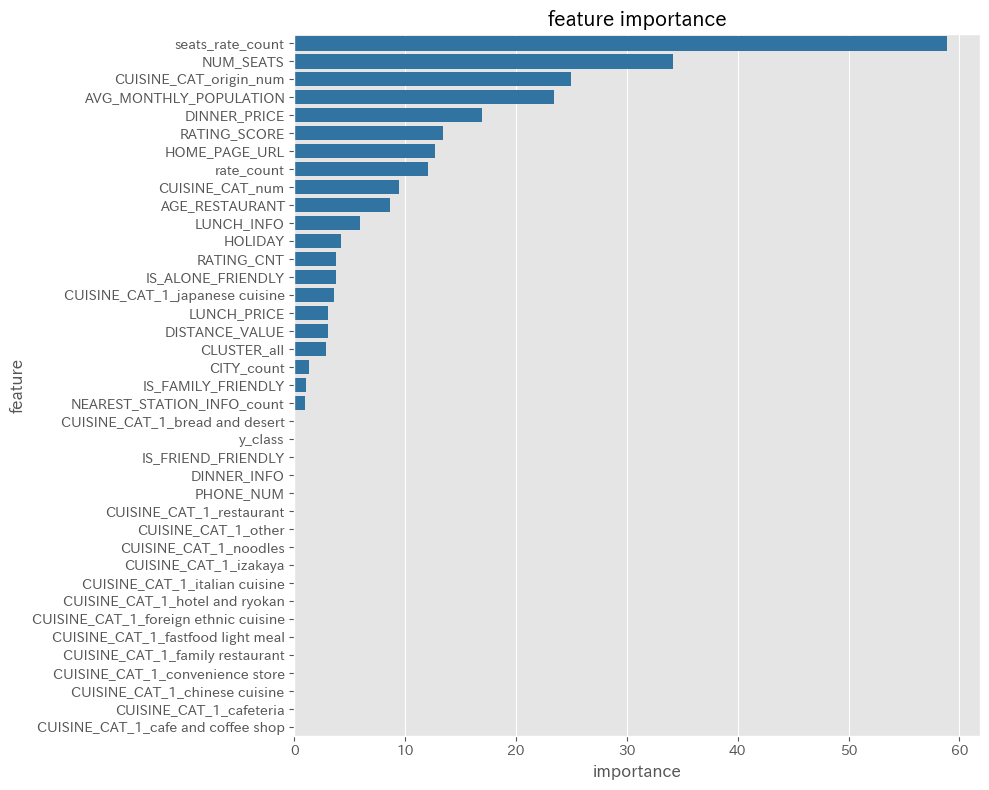


=== SHAP値の計算と可視化 


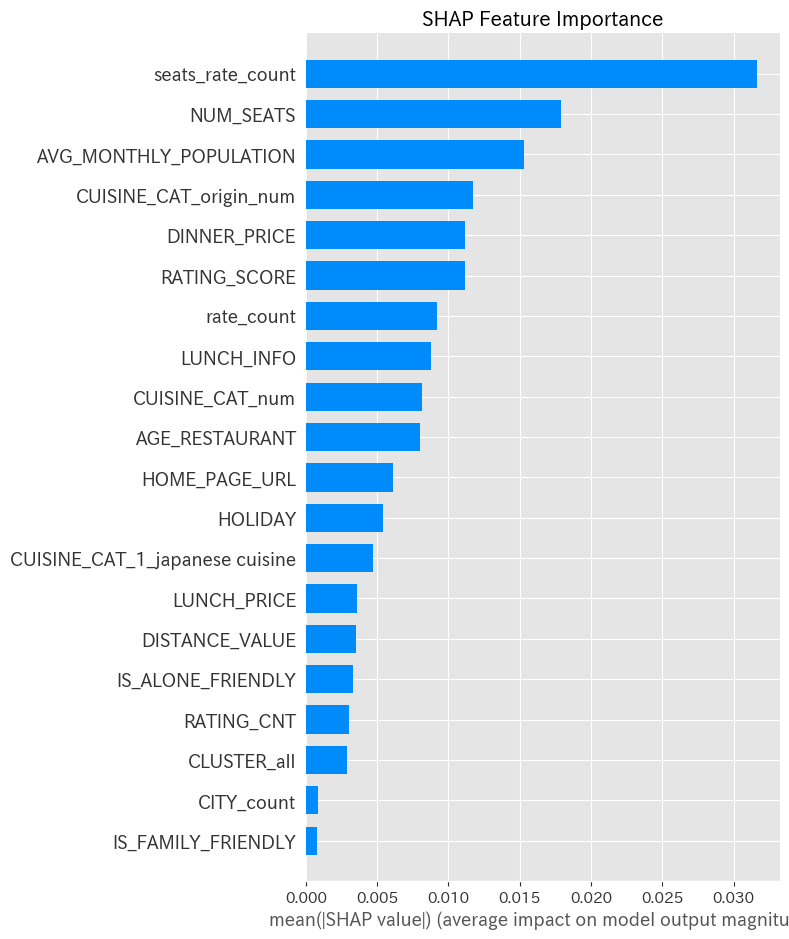

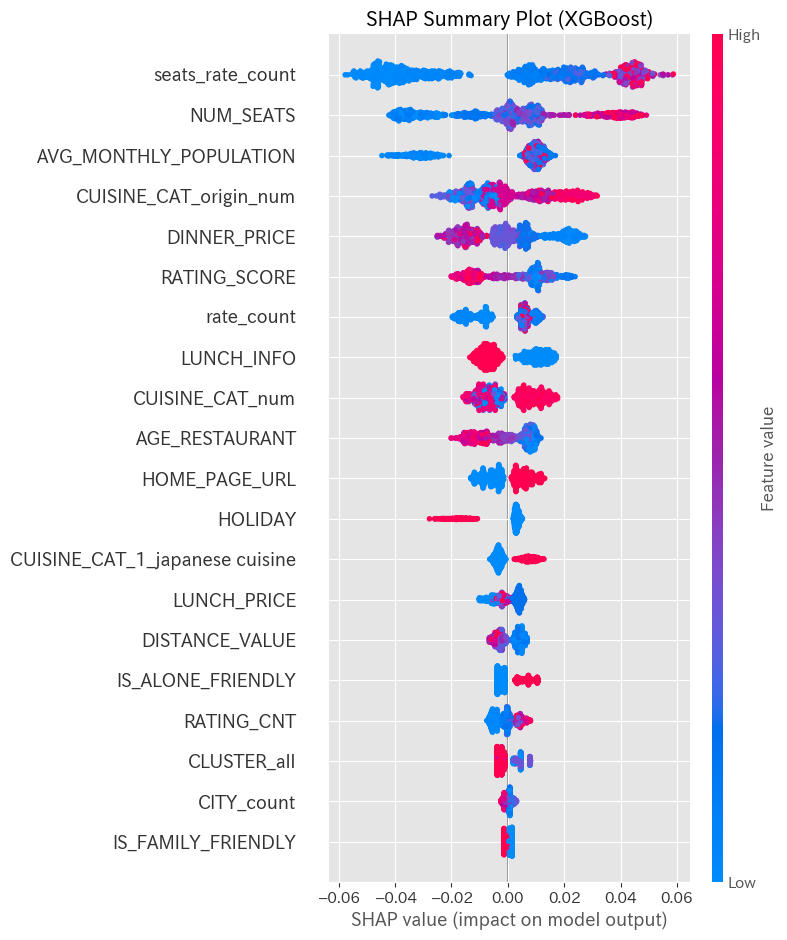

特徴量重要度（上位10個）:
                   feature  importance
34        seats_rate_count   58.905069
15               NUM_SEATS   34.186954
36  CUISINE_CAT_origin_num   24.916459
0   AVG_MONTHLY_POPULATION   23.390909
10            DINNER_PRICE   16.959185
4             RATING_SCORE   13.403518
13           HOME_PAGE_URL   12.728341
33              rate_count   12.014409
35         CUISINE_CAT_num    9.430688
16          AGE_RESTAURANT    8.615400
model:lightGBM
RMSE: 15.0446, MAE: 12.4082, MAPE: 32.65%, R²: -0.0120

=== 予測結果の可視化 ===


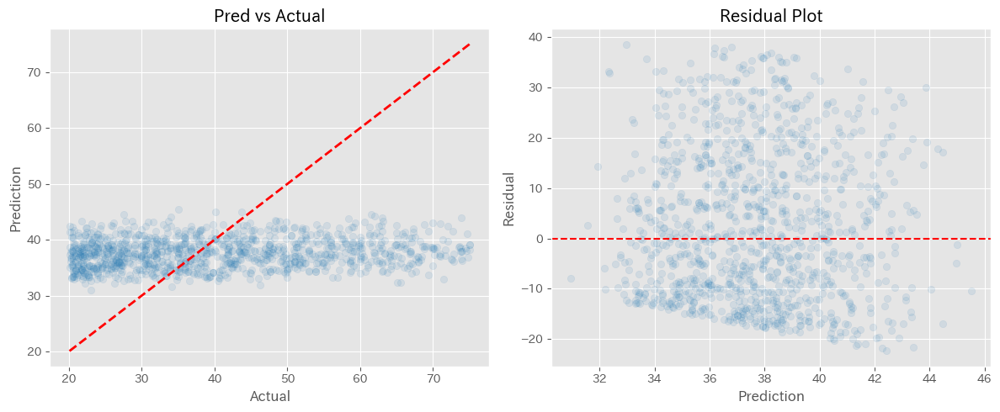


=== error vs actual ===


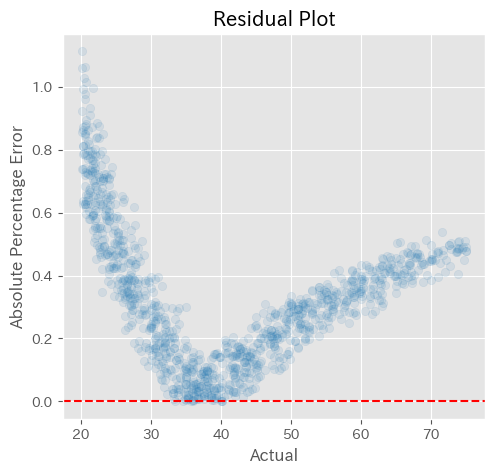

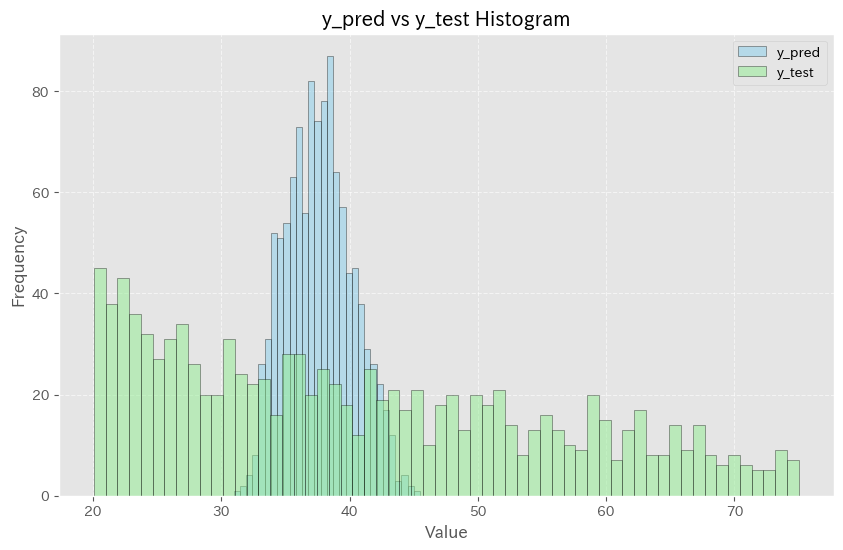


=== モデルの保存 ===
モデルを保存しました: lightgbm_sales_model.txt

=== 最適化結果の可視化 ===


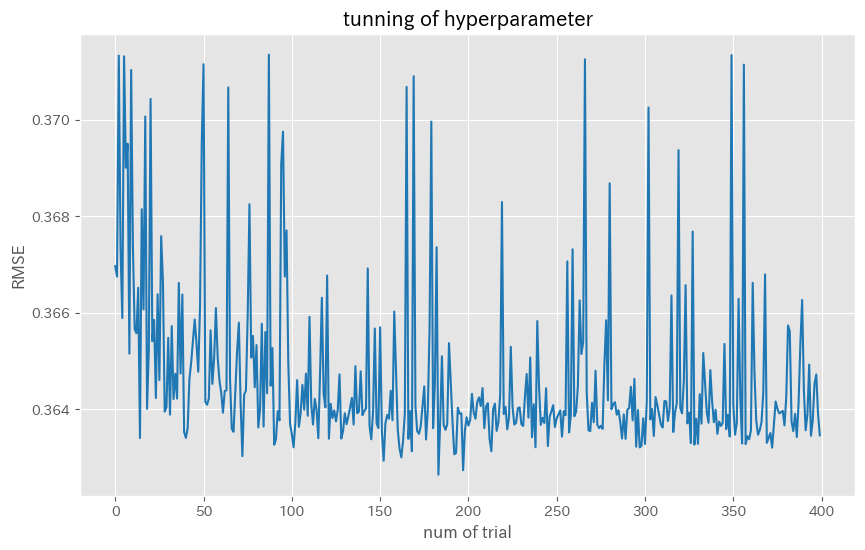


=== 完了 ===
LightGBM回帰モデルの作成とハイパーパラメータチューニングが完了しました。
生成されたファイル:
- lightgbm_sales_model.txt: 訓練済みモデル
- feature_importance.png: 特徴量重要度
- prediction_results.png: 予測結果
- optimization_progress.png: 最適化の進行
----------------------------------------------------------
middle
標準化完了
訓練データ: (1526, 39)
テストデータ: (382, 39)

=== ハイパーパラメータチューニング ===
Optunaを使用してハイパーパラメータを最適化中...

--- lightGBM ---
最適化完了!
最適なRMSE: 0.1906
最適なパラメータ: {'num_leaves': 248, 'max_depth': 16, 'learning_rate': 0.020018992499773448, 'feature_fraction': 0.8993588938688475, 'bagging_fraction': 0.9464219913276467, 'bagging_freq': 3, 'min_child_samples': 570, 'min_gain_to_split': 0.00029483895996875766, 'reg_alpha': 0.2698375301822532, 'reg_lambda': 0.0002678981161069235}

=== 最適なパラメータでモデル訓練 ===
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[5]	valid_0's rmse: 0.193696

=== 最終モデルの評価結果 （対数変換後）===
RMSE: 0.1937
MAE: 0.1674
MAPE: 0.0360
R² Score: -0.0003

=== 最終モデルの評価結果 （オリジナル）===
RMSE: 20.955

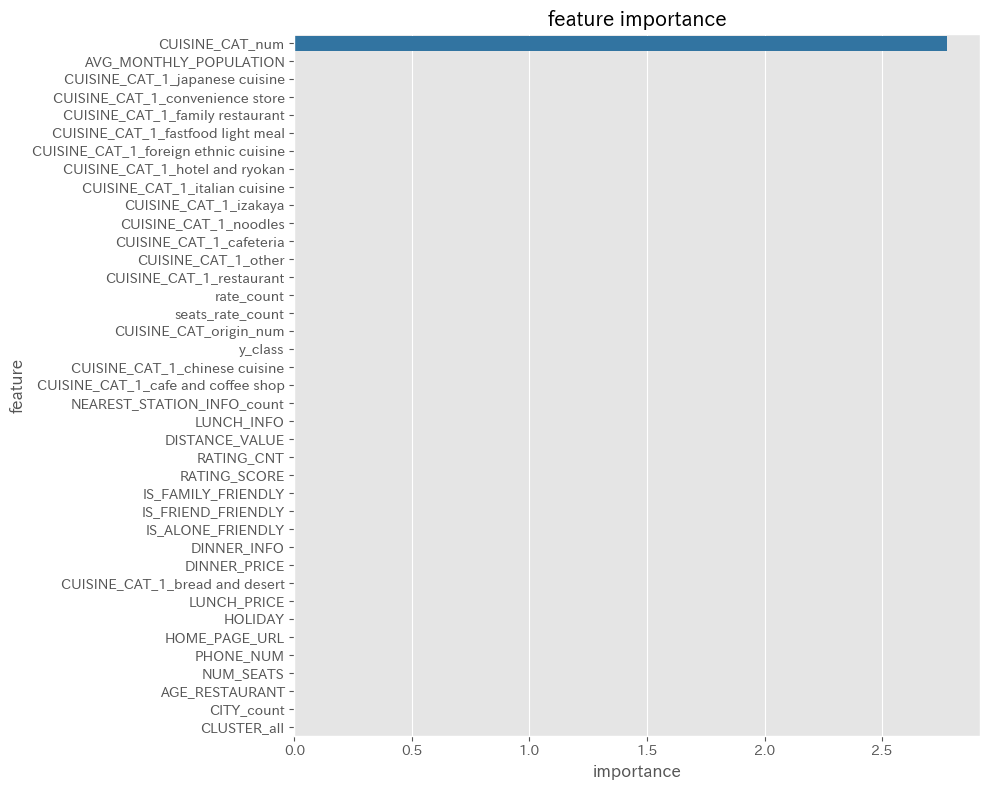


=== SHAP値の計算と可視化 


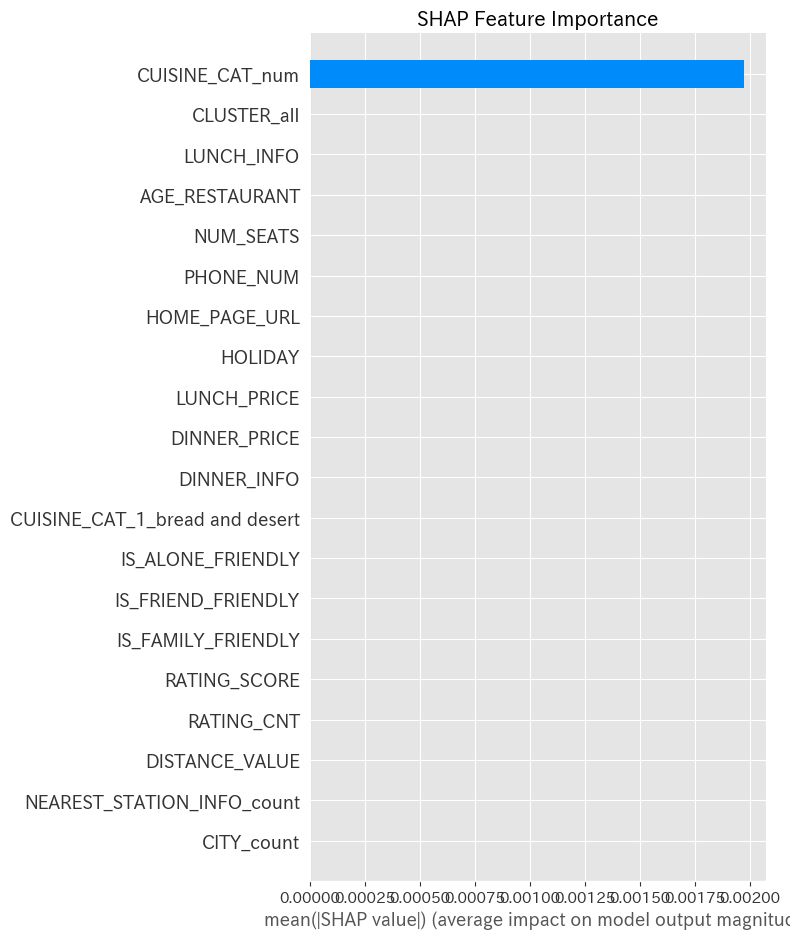

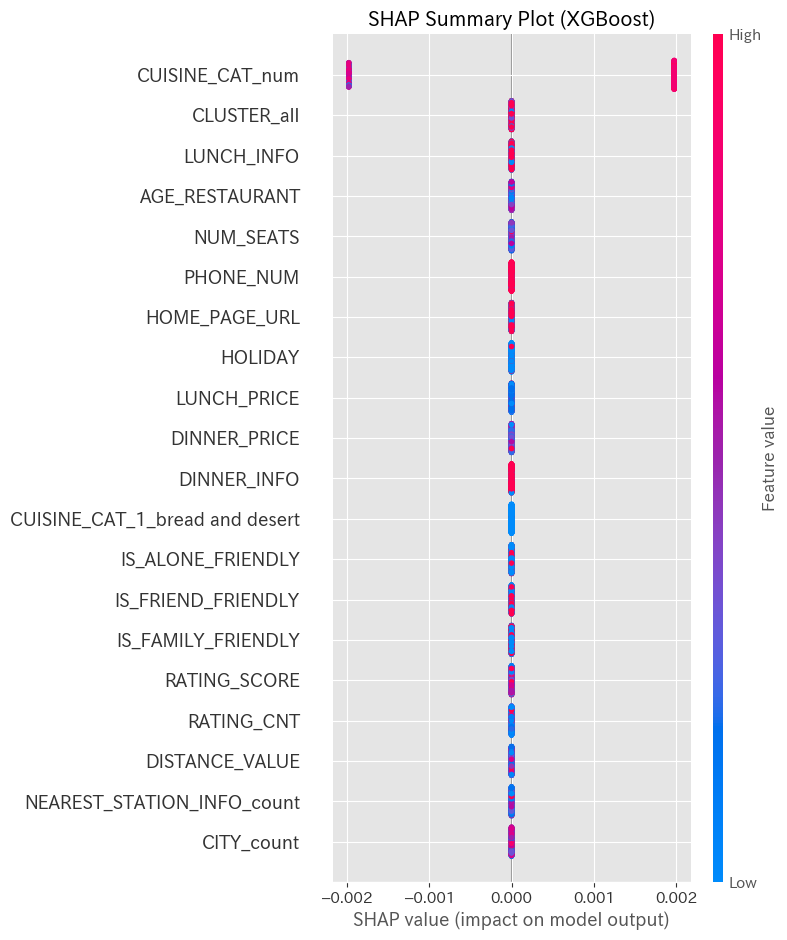

特徴量重要度（上位10個）:
                                 feature  importance
35                       CUISINE_CAT_num    2.777859
0                 AVG_MONTHLY_POPULATION    0.000000
29        CUISINE_CAT_1_japanese cuisine    0.000000
22       CUISINE_CAT_1_convenience store    0.000000
23       CUISINE_CAT_1_family restaurant    0.000000
24     CUISINE_CAT_1_fastfood light meal    0.000000
25  CUISINE_CAT_1_foreign ethnic cuisine    0.000000
26        CUISINE_CAT_1_hotel and ryokan    0.000000
27         CUISINE_CAT_1_italian cuisine    0.000000
28                 CUISINE_CAT_1_izakaya    0.000000
model:lightGBM
RMSE: 20.9559, MAE: 17.8142, MAPE: 17.06%, R²: -0.0055

=== 予測結果の可視化 ===


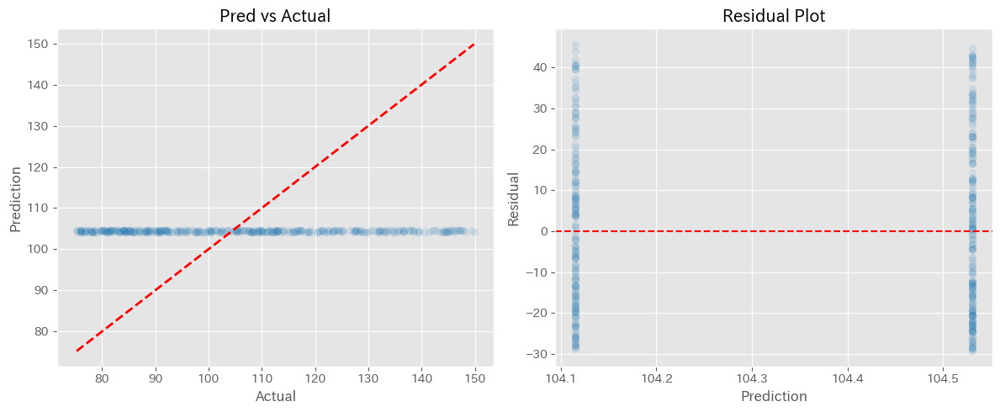


=== error vs actual ===


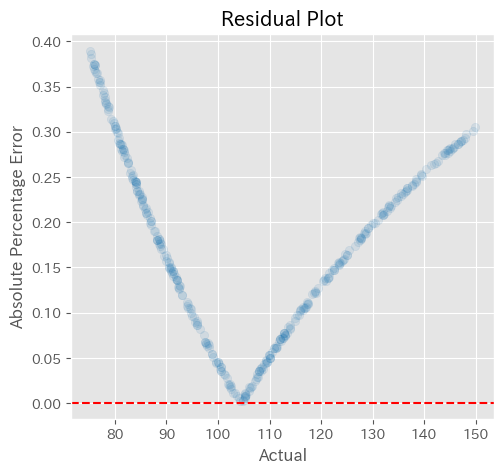

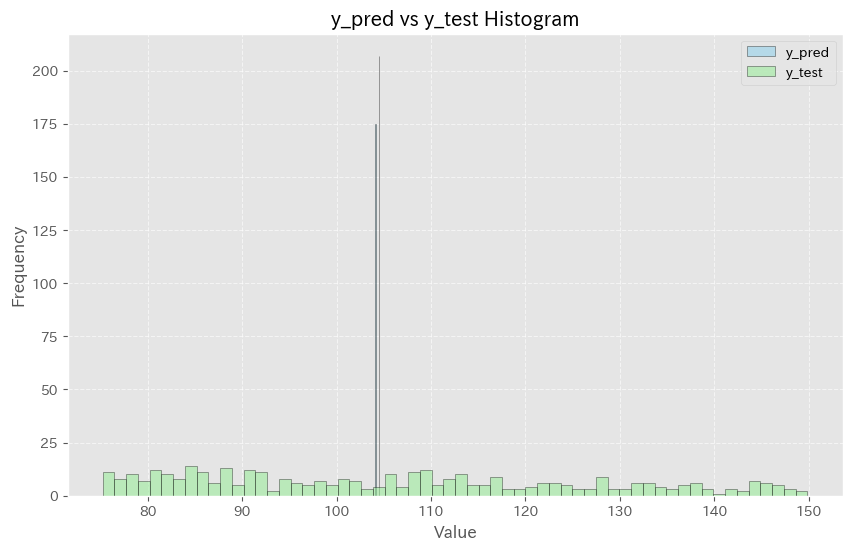


=== モデルの保存 ===
モデルを保存しました: lightgbm_sales_model.txt

=== 最適化結果の可視化 ===


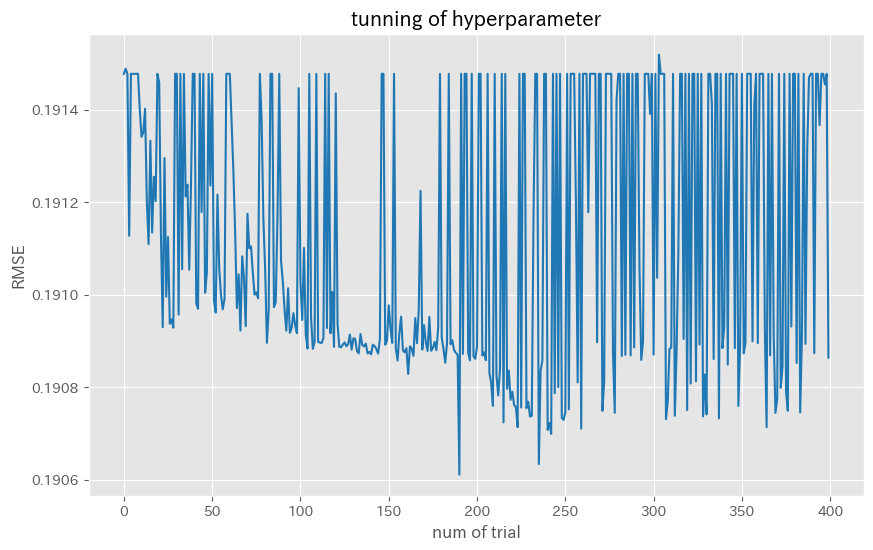


=== 完了 ===
LightGBM回帰モデルの作成とハイパーパラメータチューニングが完了しました。
生成されたファイル:
- lightgbm_sales_model.txt: 訓練済みモデル
- feature_importance.png: 特徴量重要度
- prediction_results.png: 予測結果
- optimization_progress.png: 最適化の進行
----------------------------------------------------------
high
標準化完了
訓練データ: (1484, 39)
テストデータ: (371, 39)

=== ハイパーパラメータチューニング ===
Optunaを使用してハイパーパラメータを最適化中...

--- lightGBM ---
最適化完了!
最適なRMSE: 0.3531
最適なパラメータ: {'num_leaves': 122, 'max_depth': 14, 'learning_rate': 0.0408141927445325, 'feature_fraction': 0.6016472816782553, 'bagging_fraction': 0.7630399669061795, 'bagging_freq': 3, 'min_child_samples': 26, 'min_gain_to_split': 0.16806389098955962, 'reg_alpha': 0.0006849390882914512, 'reg_lambda': 0.011463383364963766}

=== 最適なパラメータでモデル訓練 ===
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[20]	valid_0's rmse: 0.38246

=== 最終モデルの評価結果 （対数変換後）===
RMSE: 0.3825
MAE: 0.3255
MAPE: 0.0582
R² Score: 0.0182

=== 最終モデルの評価結果 （オリジナル）===
RMSE: 118.1625
MAE:

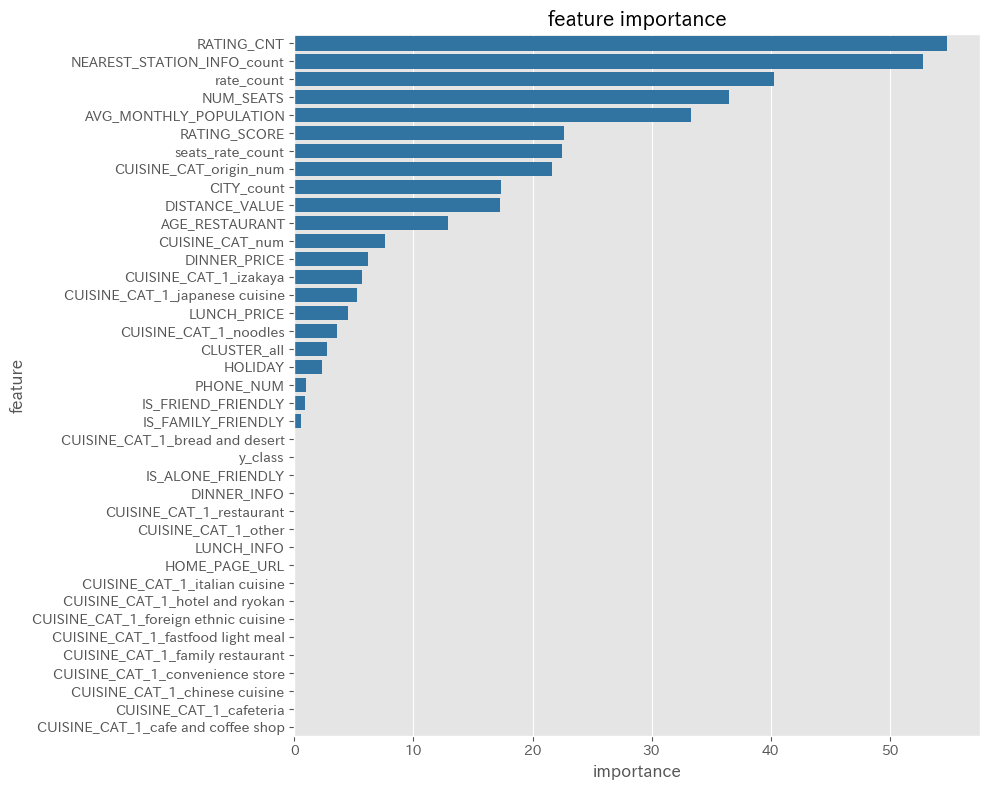


=== SHAP値の計算と可視化 


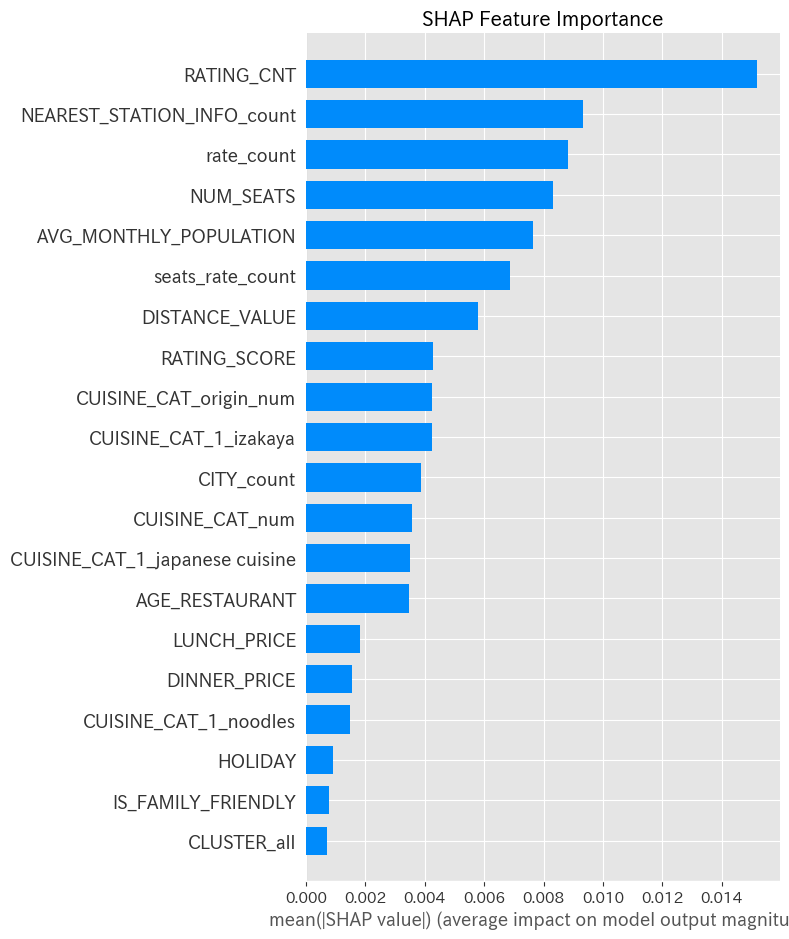

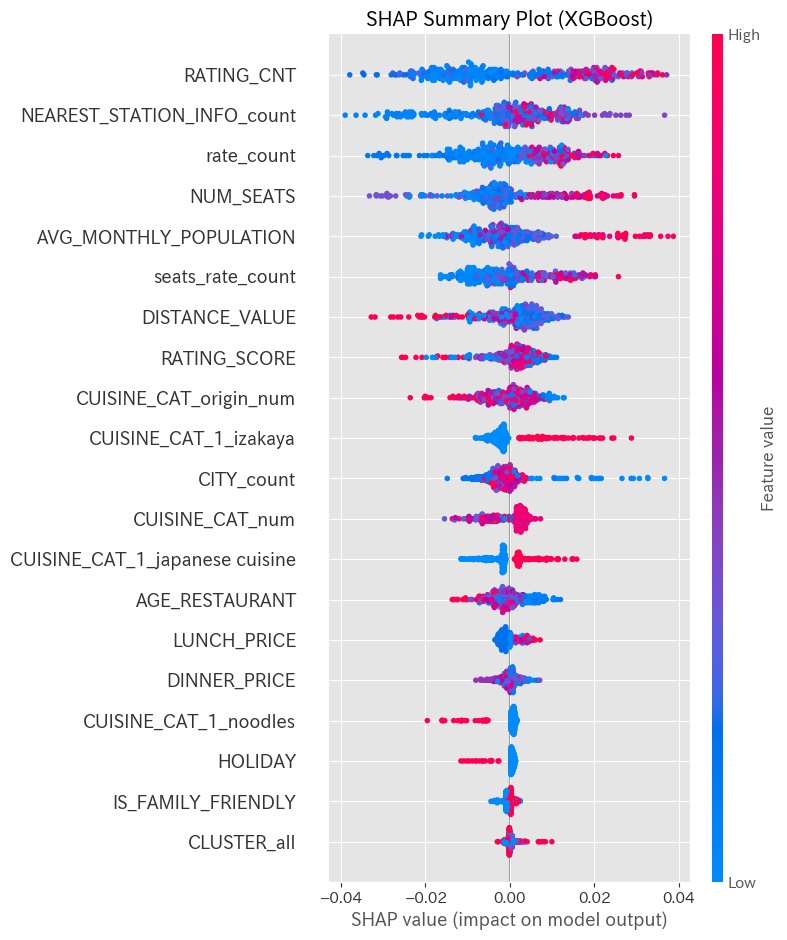

特徴量重要度（上位10個）:
                       feature  importance
3                   RATING_CNT   54.845939
1   NEAREST_STATION_INFO_count   52.773473
33                  rate_count   40.291569
15                   NUM_SEATS   36.490330
0       AVG_MONTHLY_POPULATION   33.330504
4                 RATING_SCORE   22.633183
34            seats_rate_count   22.483641
36      CUISINE_CAT_origin_num   21.630343
17                  CITY_count   17.378471
2               DISTANCE_VALUE   17.290075
model:lightGBM
RMSE: 118.1625, MAE: 92.0954, MAPE: 32.84%, R²: -0.0114

=== 予測結果の可視化 ===


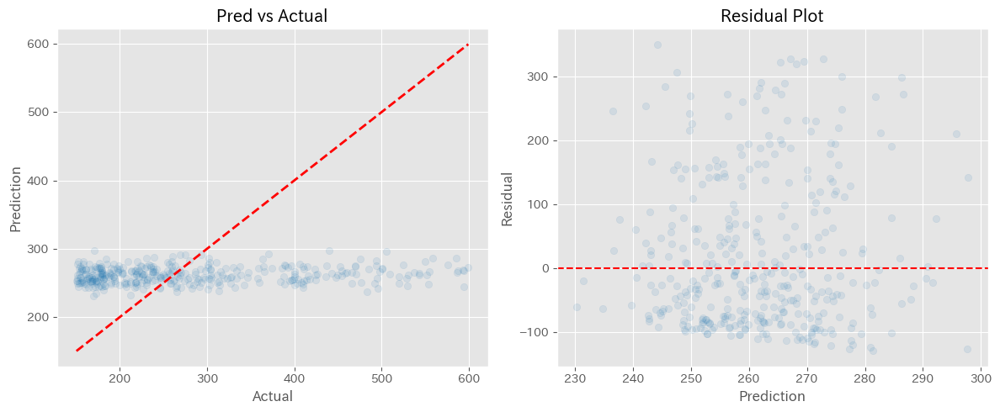


=== error vs actual ===


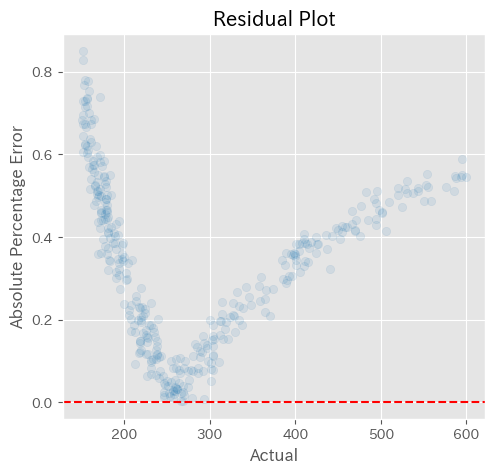

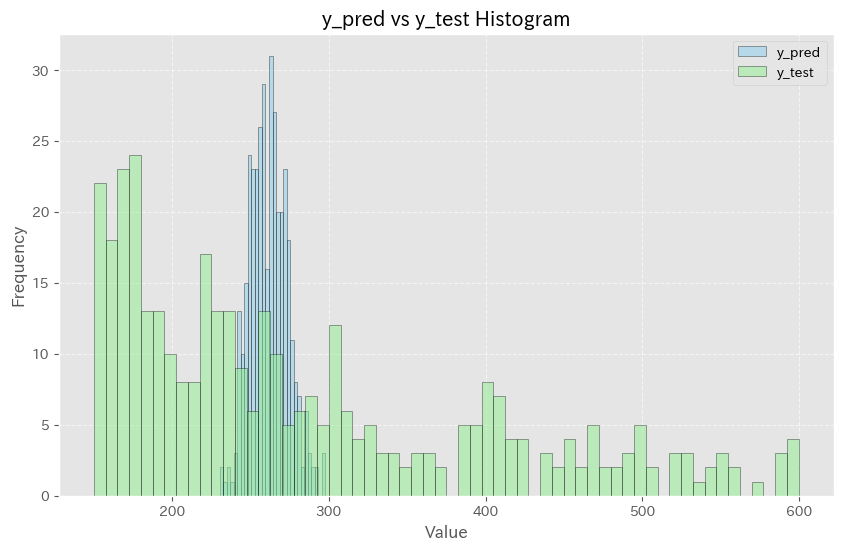


=== モデルの保存 ===
モデルを保存しました: lightgbm_sales_model.txt

=== 最適化結果の可視化 ===


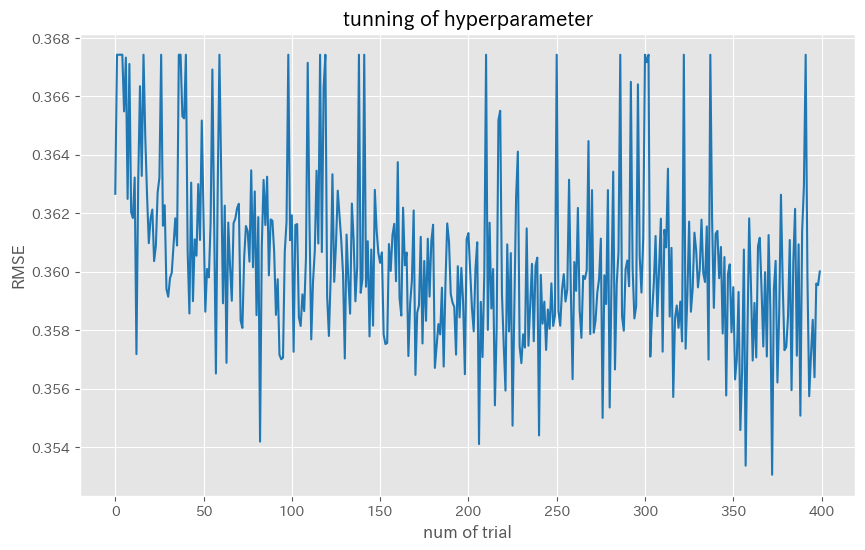


=== 完了 ===
LightGBM回帰モデルの作成とハイパーパラメータチューニングが完了しました。
生成されたファイル:
- lightgbm_sales_model.txt: 訓練済みモデル
- feature_importance.png: 特徴量重要度
- prediction_results.png: 予測結果
- optimization_progress.png: 最適化の進行


In [50]:
for y_class in ["low", "middle", "high"]:
    print("----------------------------------------------------------")
    print(y_class)
    final_model = train_test_model(aggregated_df[aggregated_df["y_class"]==y_class], 'target_amount_tableau')

----------------------------------------------------------
CUISINE_CAT_1_bread and desert
標準化完了
訓練データ: (28, 39)
テストデータ: (8, 39)

=== ハイパーパラメータチューニング ===
Optunaを使用してハイパーパラメータを最適化中...

--- lightGBM ---
最適化完了!
最適なRMSE: 1.1478
最適なパラメータ: {'num_leaves': 265, 'max_depth': 8, 'learning_rate': 0.035230011209852884, 'feature_fraction': 0.9577091353023715, 'bagging_fraction': 0.47460849087829526, 'bagging_freq': 9, 'min_child_samples': 750, 'min_gain_to_split': 0.2917439520944091, 'reg_alpha': 0.007930472786410677, 'reg_lambda': 0.1819089189061353}

=== 最適なパラメータでモデル訓練 ===
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[1]	valid_0's rmse: 0.73602

=== 最終モデルの評価結果 （対数変換後）===
RMSE: 0.7360
MAE: 0.6933
MAPE: 0.1604
R² Score: -0.0341

=== 最終モデルの評価結果 （オリジナル）===
RMSE: 69.0897
MAE: 59.8333
MAPE: 0.7035
R² Score: -0.2569

=== 特徴量重要度の可視化 ===


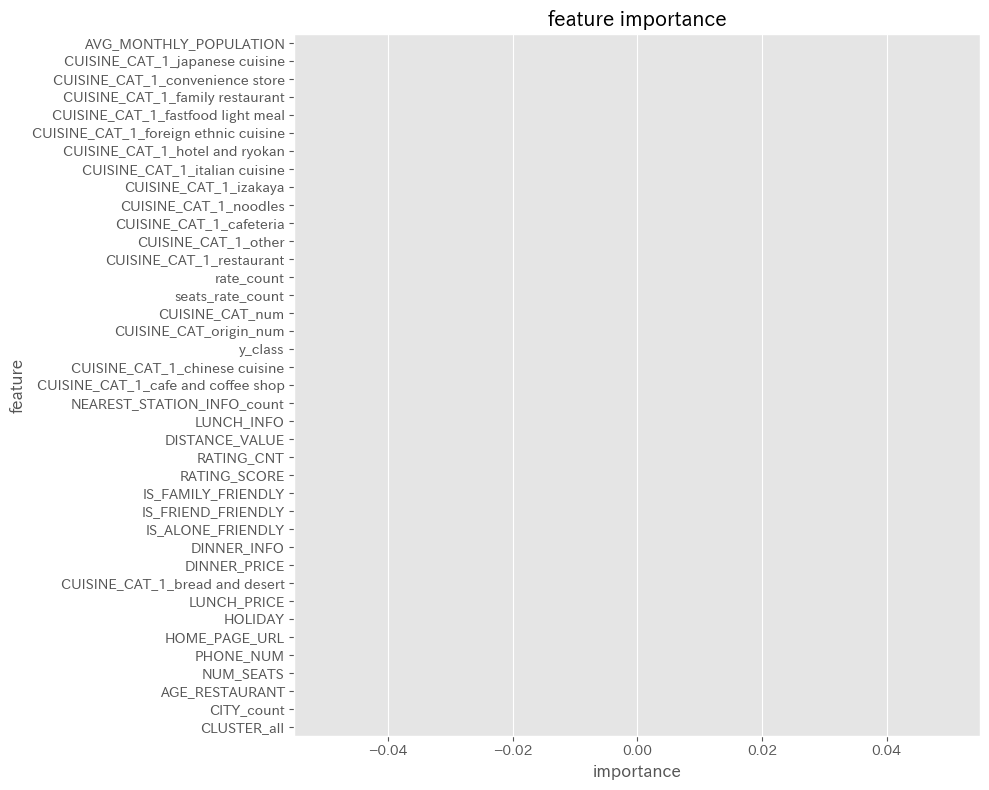


=== SHAP値の計算と可視化 


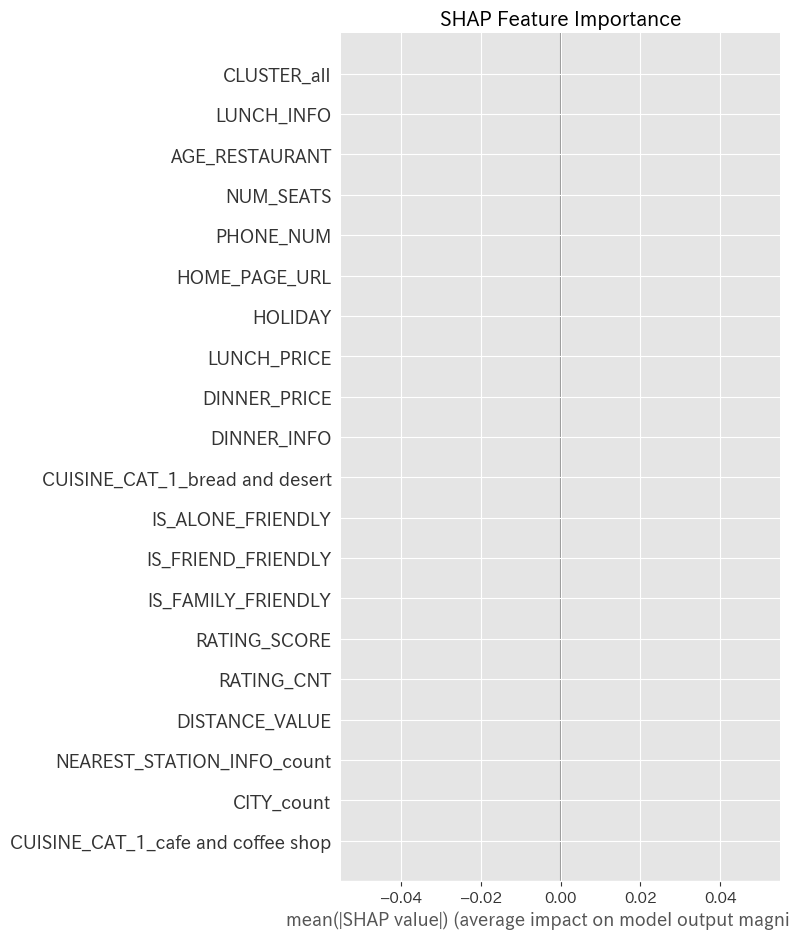

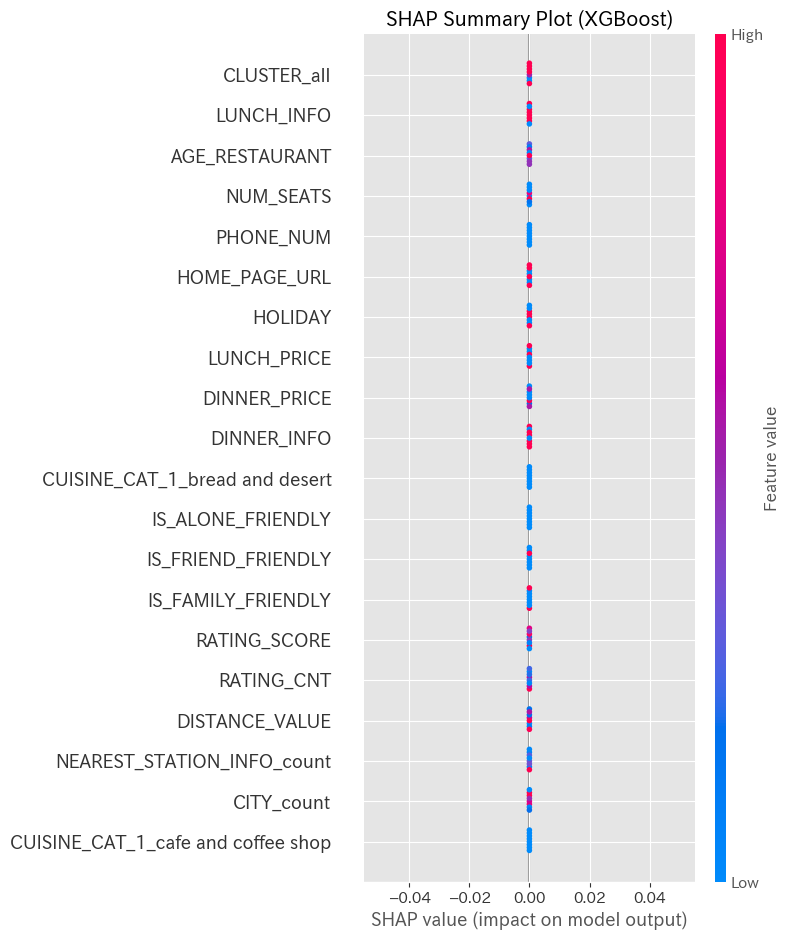

特徴量重要度（上位10個）:
                                 feature  importance
0                 AVG_MONTHLY_POPULATION         0.0
29        CUISINE_CAT_1_japanese cuisine         0.0
22       CUISINE_CAT_1_convenience store         0.0
23       CUISINE_CAT_1_family restaurant         0.0
24     CUISINE_CAT_1_fastfood light meal         0.0
25  CUISINE_CAT_1_foreign ethnic cuisine         0.0
26        CUISINE_CAT_1_hotel and ryokan         0.0
27         CUISINE_CAT_1_italian cuisine         0.0
28                 CUISINE_CAT_1_izakaya         0.0
30                 CUISINE_CAT_1_noodles         0.0
model:lightGBM
RMSE: 69.0897, MAE: 59.8333, MAPE: 70.35%, R²: -0.2569

=== 予測結果の可視化 ===


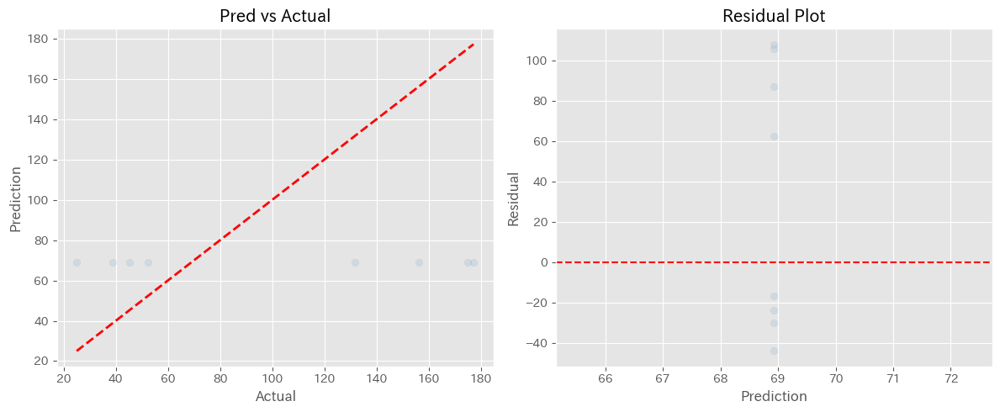


=== error vs actual ===


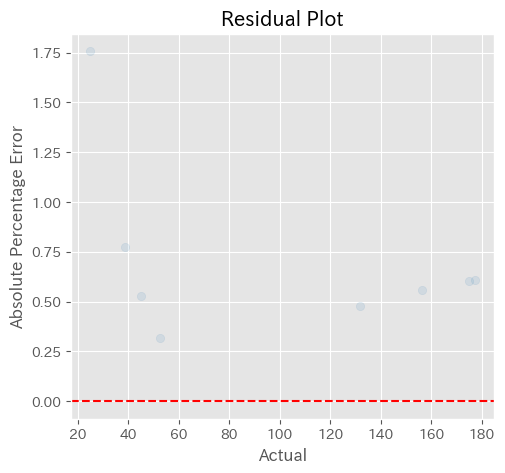

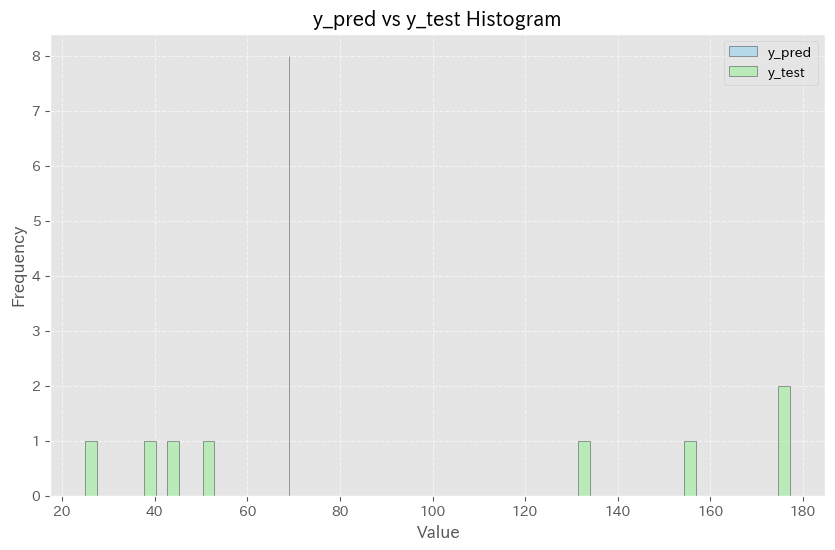


=== モデルの保存 ===
モデルを保存しました: lightgbm_sales_model.txt

=== 最適化結果の可視化 ===


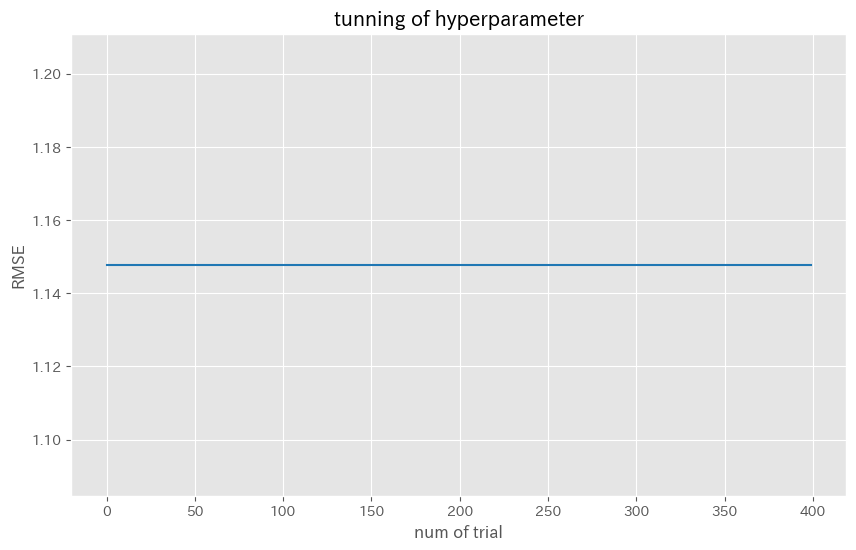


=== 完了 ===
LightGBM回帰モデルの作成とハイパーパラメータチューニングが完了しました。
生成されたファイル:
- lightgbm_sales_model.txt: 訓練済みモデル
- feature_importance.png: 特徴量重要度
- prediction_results.png: 予測結果
- optimization_progress.png: 最適化の進行
----------------------------------------------------------
CUISINE_CAT_1_cafe and coffee shop
標準化完了
訓練データ: (274, 39)
テストデータ: (69, 39)

=== ハイパーパラメータチューニング ===
Optunaを使用してハイパーパラメータを最適化中...

--- lightGBM ---
最適化完了!
最適なRMSE: 0.3060
最適なパラメータ: {'num_leaves': 61, 'max_depth': 3, 'learning_rate': 0.08658639756883454, 'feature_fraction': 0.9515341842703657, 'bagging_fraction': 0.862096298409416, 'bagging_freq': 5, 'min_child_samples': 10, 'min_gain_to_split': 0.12093969768081599, 'reg_alpha': 1.2685680343952687e-09, 'reg_lambda': 1.4311438437017518e-08}

=== 最適なパラメータでモデル訓練 ===
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[55]	valid_0's rmse: 0.35758

=== 最終モデルの評価結果 （対数変換後）===
RMSE: 0.3576
MAE: 0.2856
MAPE: 0.0726
R² Score: 0.8324

=== 最終モデルの評価結果 （

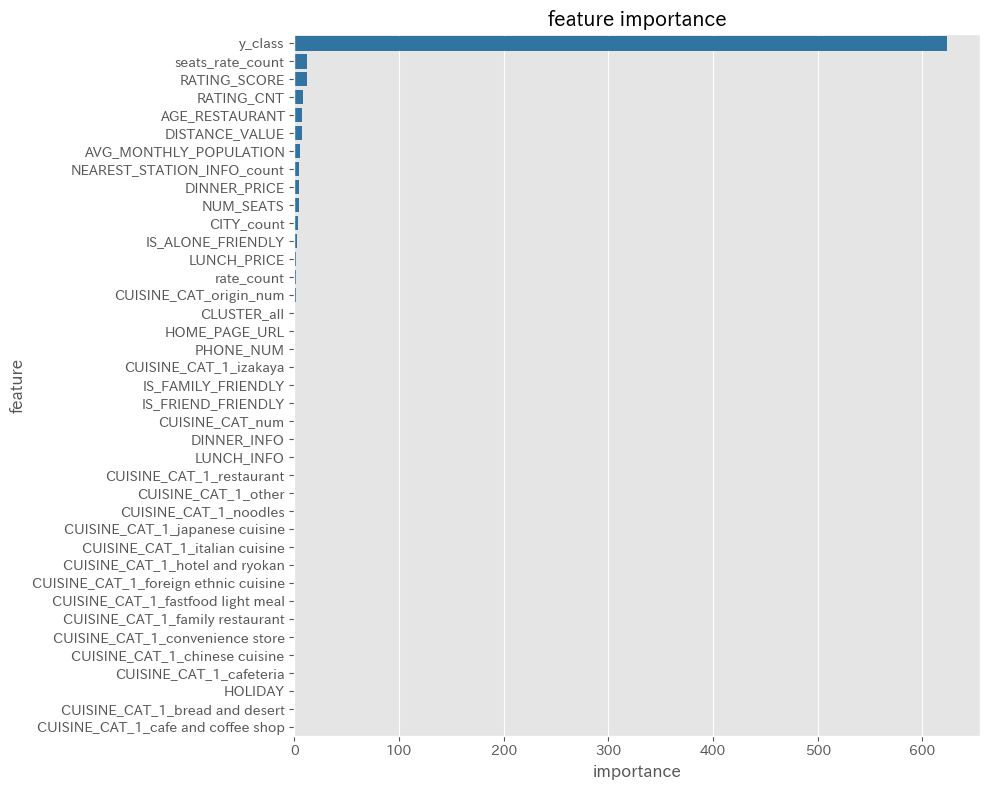


=== SHAP値の計算と可視化 


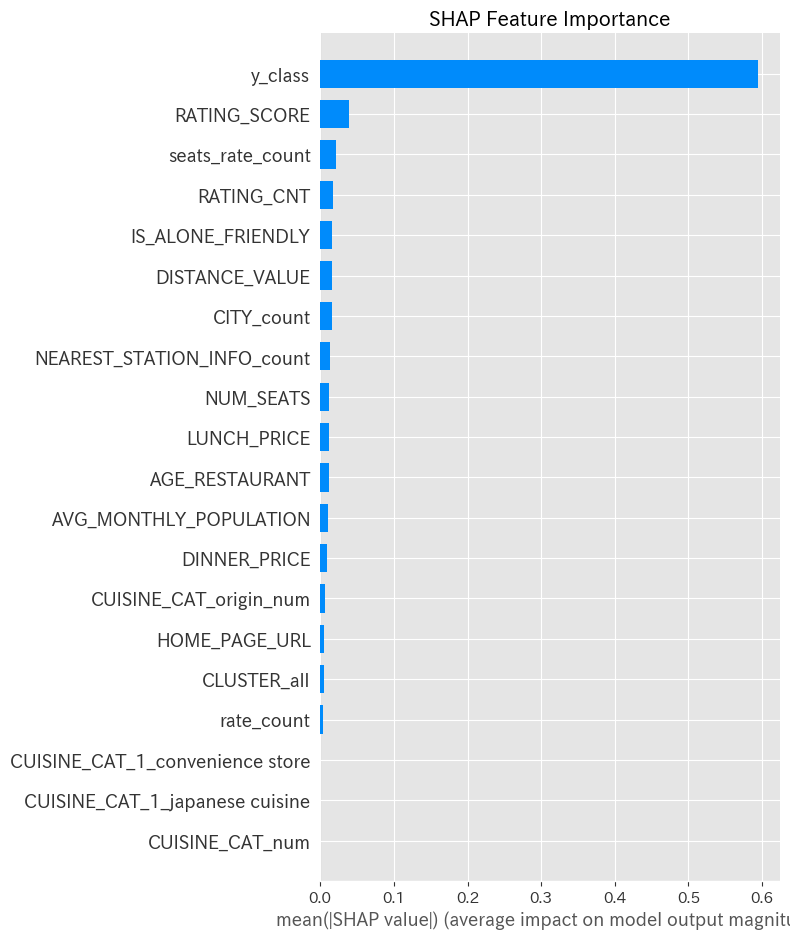

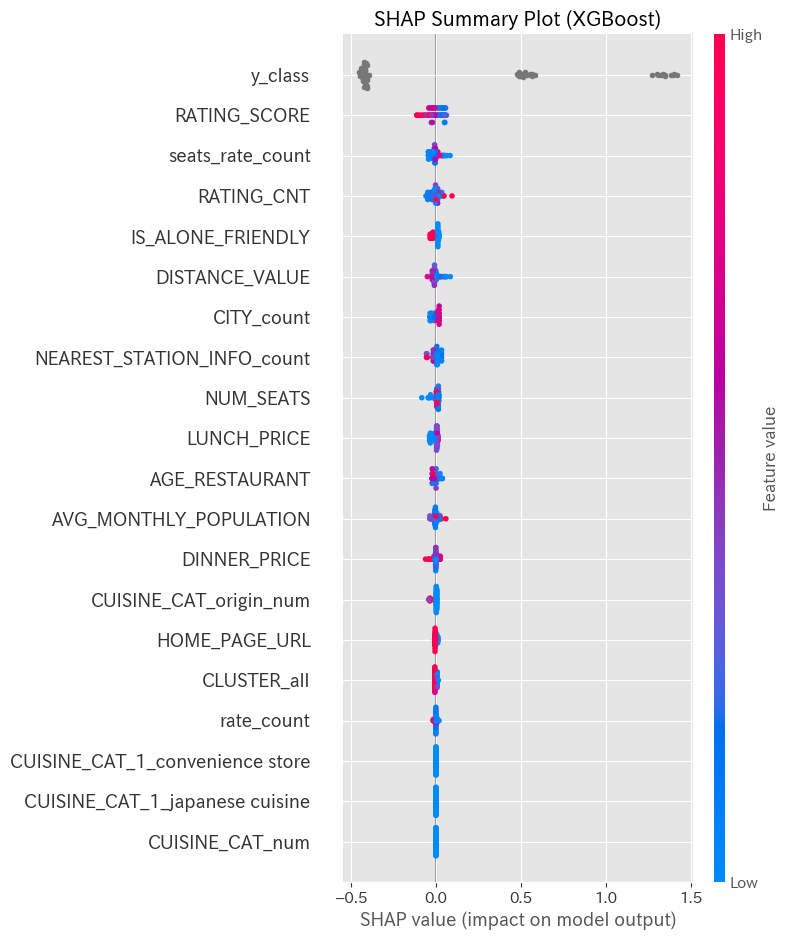

特徴量重要度（上位10個）:
                       feature  importance
37                     y_class  623.901884
34            seats_rate_count   12.244521
4                 RATING_SCORE   12.068481
3                   RATING_CNT    8.020991
16              AGE_RESTAURANT    7.623402
2               DISTANCE_VALUE    7.242717
0       AVG_MONTHLY_POPULATION    5.502222
1   NEAREST_STATION_INFO_count    4.020336
10                DINNER_PRICE    4.015567
15                   NUM_SEATS    3.983540
model:lightGBM
RMSE: 67.8749, MAE: 29.0132, MAPE: 29.53%, R²: 0.6693

=== 予測結果の可視化 ===


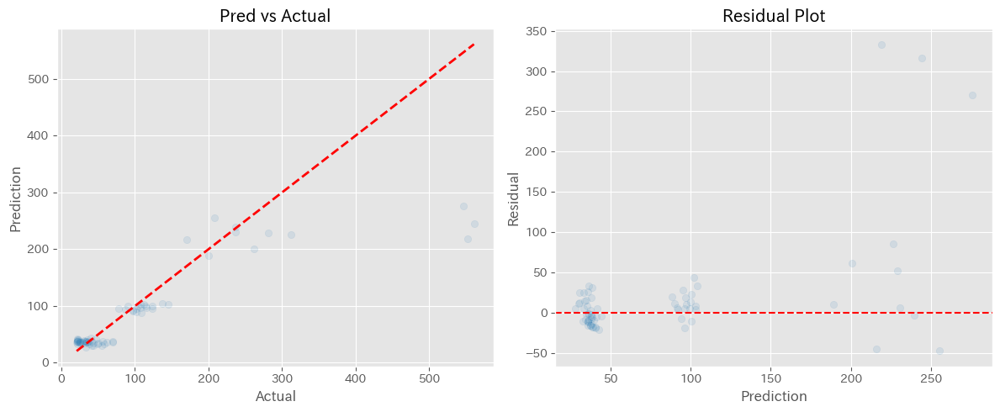


=== error vs actual ===


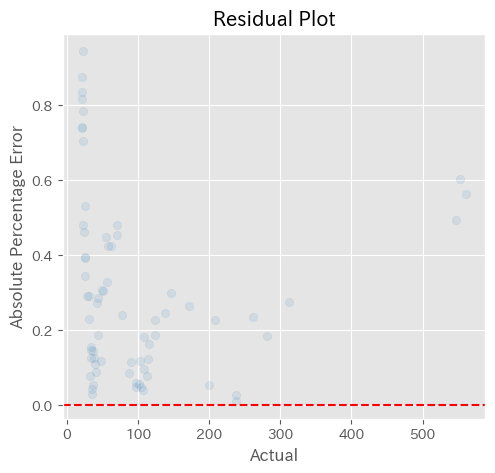

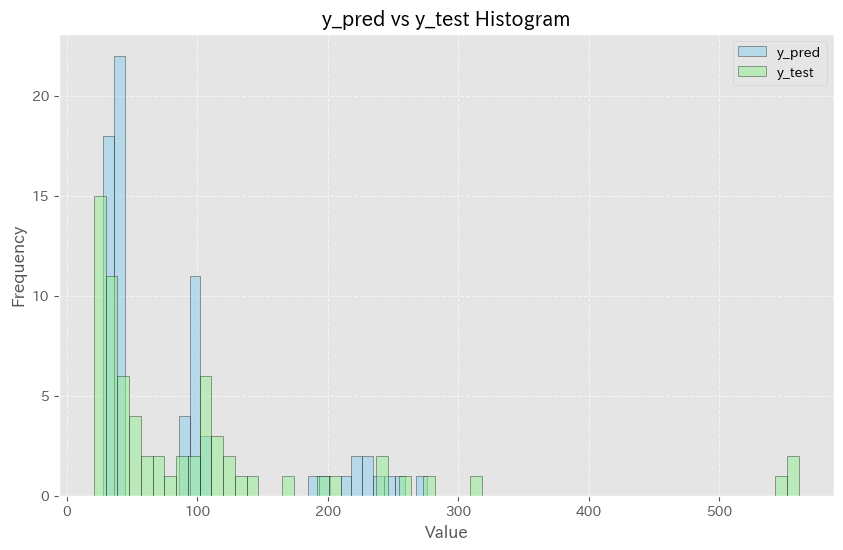


=== モデルの保存 ===
モデルを保存しました: lightgbm_sales_model.txt

=== 最適化結果の可視化 ===


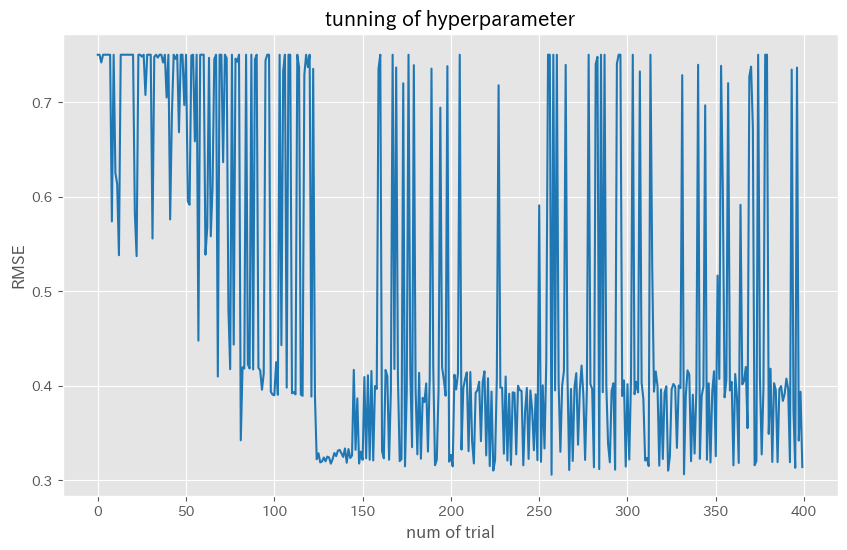


=== 完了 ===
LightGBM回帰モデルの作成とハイパーパラメータチューニングが完了しました。
生成されたファイル:
- lightgbm_sales_model.txt: 訓練済みモデル
- feature_importance.png: 特徴量重要度
- prediction_results.png: 予測結果
- optimization_progress.png: 最適化の進行
----------------------------------------------------------
CUISINE_CAT_1_cafeteria
標準化完了
訓練データ: (56, 39)
テストデータ: (14, 39)

=== ハイパーパラメータチューニング ===
Optunaを使用してハイパーパラメータを最適化中...

--- lightGBM ---
最適化完了!
最適なRMSE: 0.3972
最適なパラメータ: {'num_leaves': 197, 'max_depth': 5, 'learning_rate': 0.07789341567024187, 'feature_fraction': 0.9886540363011747, 'bagging_fraction': 0.976747050285367, 'bagging_freq': 1, 'min_child_samples': 10, 'min_gain_to_split': 0.45582435443727987, 'reg_alpha': 0.007338238794562867, 'reg_lambda': 0.0010846359799300941}

=== 最適なパラメータでモデル訓練 ===
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[42]	valid_0's rmse: 0.430991

=== 最終モデルの評価結果 （対数変換後）===
RMSE: 0.4310
MAE: 0.3797
MAPE: 0.1118
R² Score: 0.4703

=== 最終モデルの評価結果 （オリジナル）===
RMS

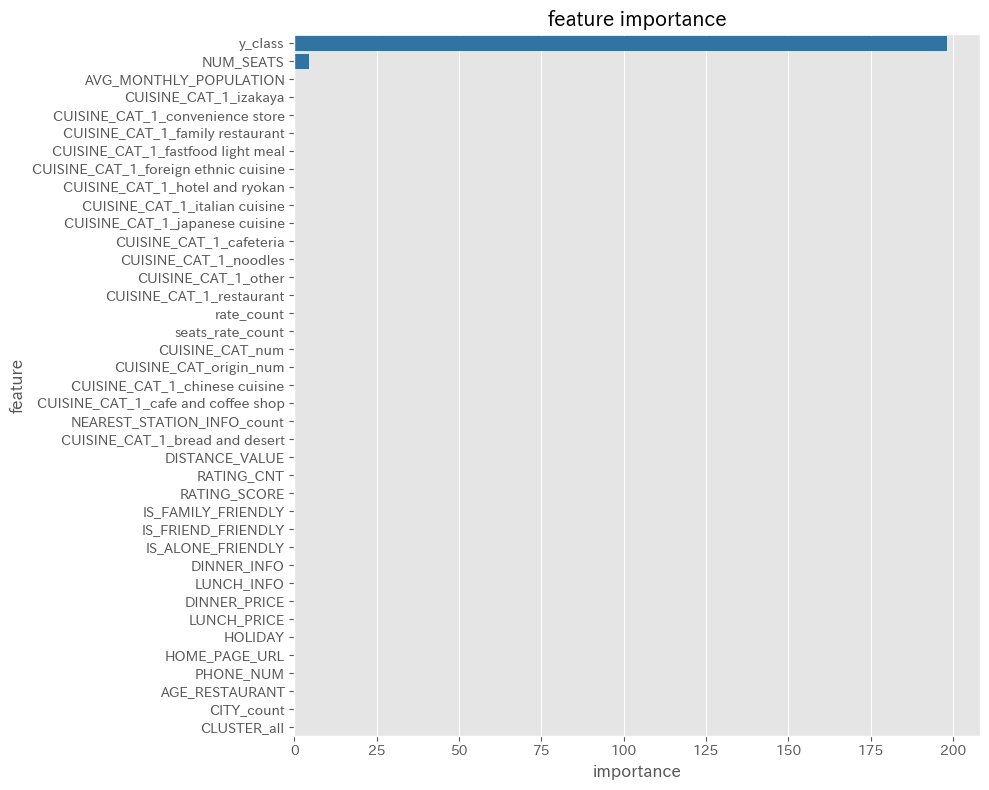


=== SHAP値の計算と可視化 


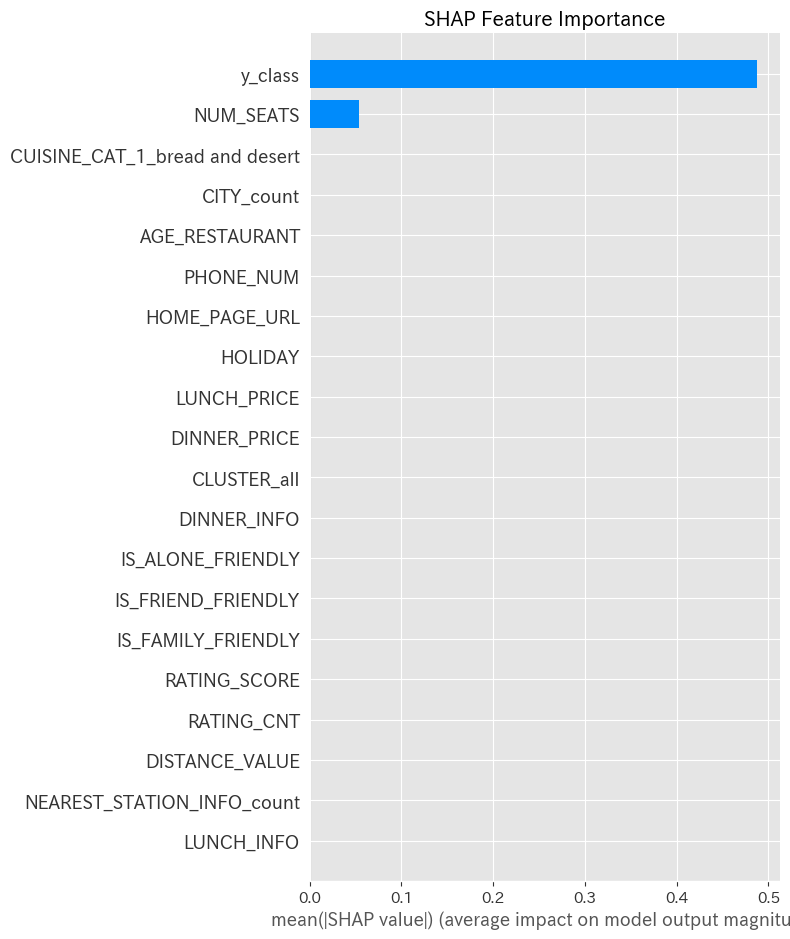

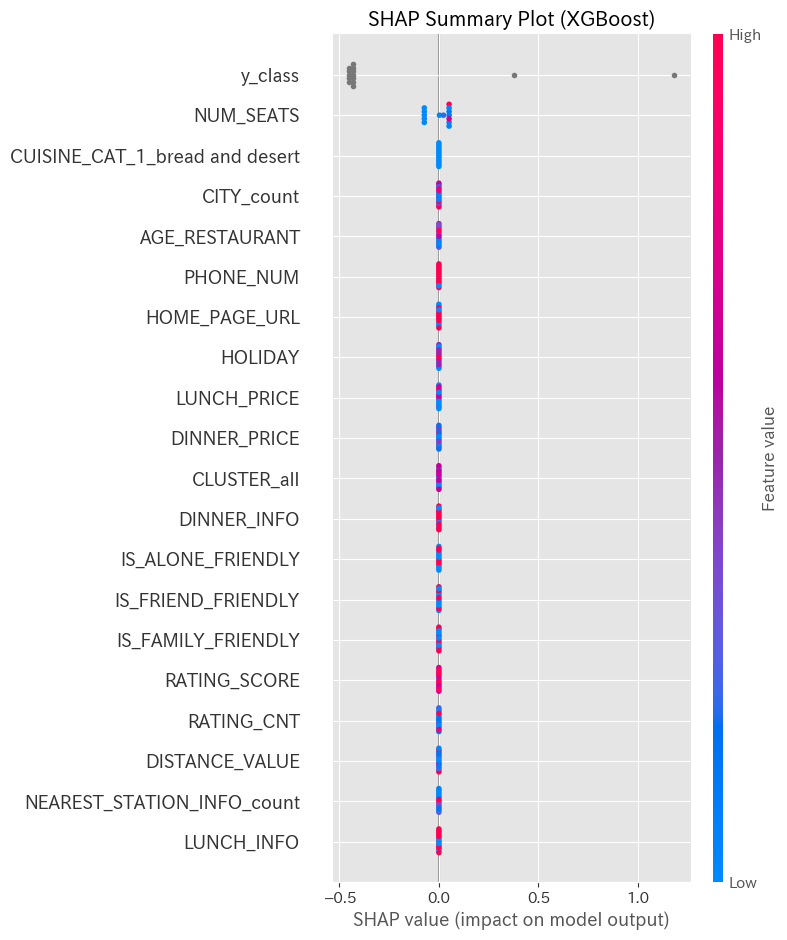

特徴量重要度（上位10個）:
                                 feature  importance
37                               y_class  198.343972
15                             NUM_SEATS    4.448022
0                 AVG_MONTHLY_POPULATION    0.000000
28                 CUISINE_CAT_1_izakaya    0.000000
22       CUISINE_CAT_1_convenience store    0.000000
23       CUISINE_CAT_1_family restaurant    0.000000
24     CUISINE_CAT_1_fastfood light meal    0.000000
25  CUISINE_CAT_1_foreign ethnic cuisine    0.000000
26        CUISINE_CAT_1_hotel and ryokan    0.000000
27         CUISINE_CAT_1_italian cuisine    0.000000
model:lightGBM
RMSE: 19.6333, MAE: 16.3108, MAPE: 48.60%, R²: 0.7638

=== 予測結果の可視化 ===


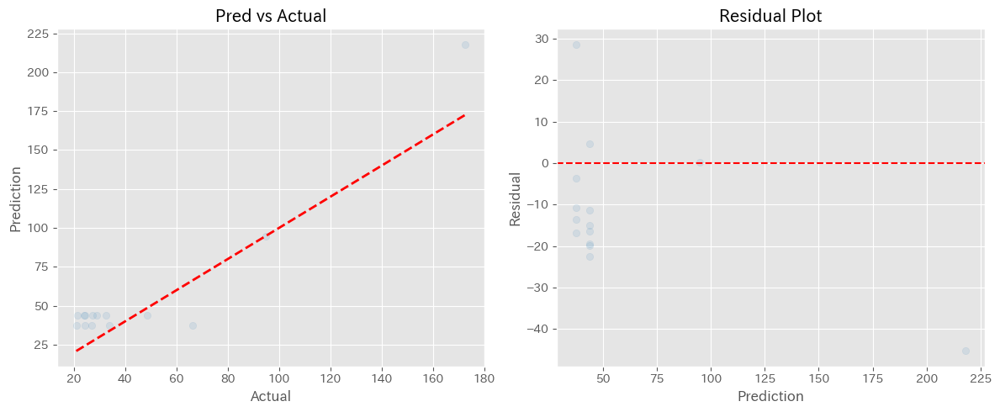


=== error vs actual ===


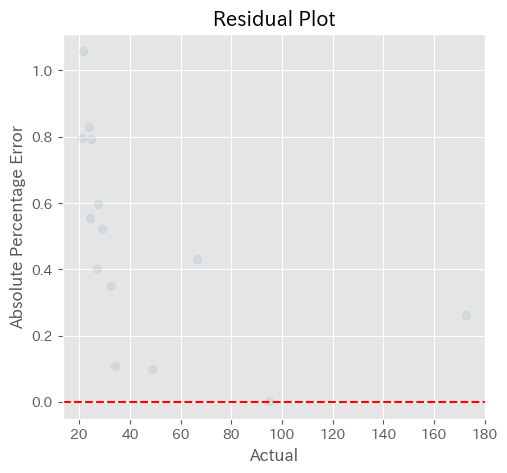

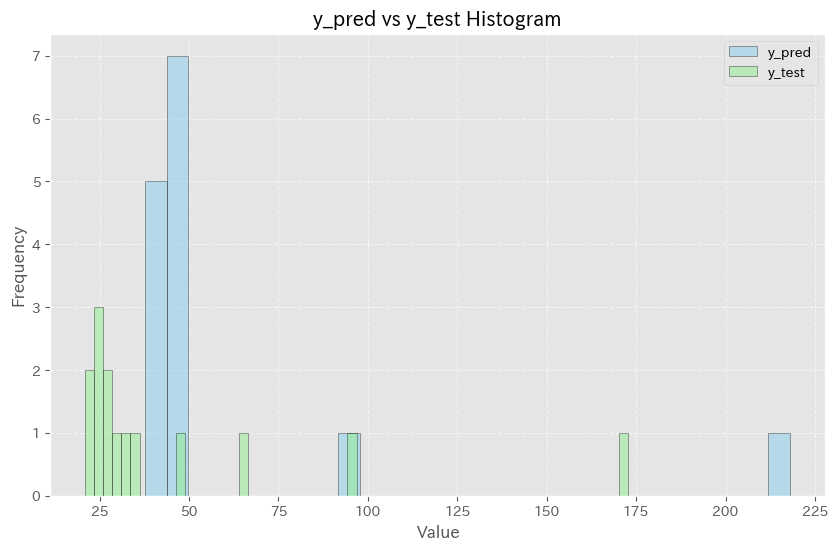


=== モデルの保存 ===
モデルを保存しました: lightgbm_sales_model.txt

=== 最適化結果の可視化 ===


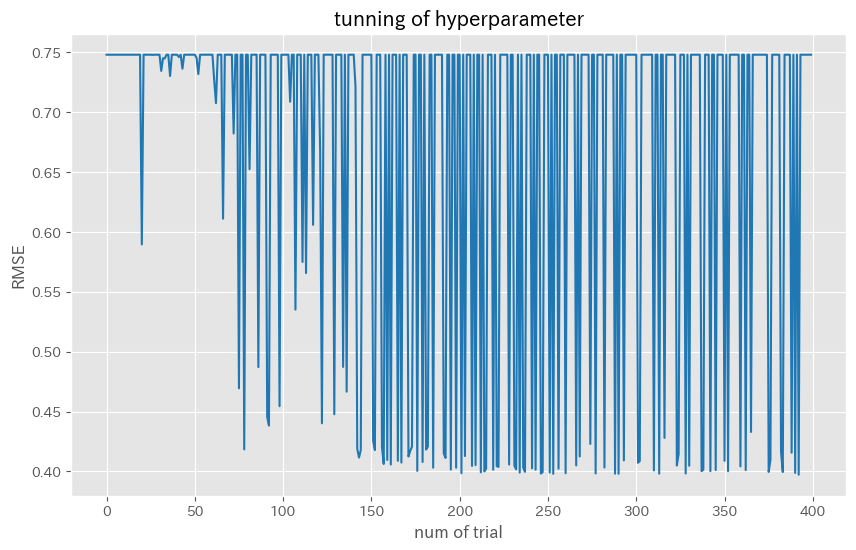


=== 完了 ===
LightGBM回帰モデルの作成とハイパーパラメータチューニングが完了しました。
生成されたファイル:
- lightgbm_sales_model.txt: 訓練済みモデル
- feature_importance.png: 特徴量重要度
- prediction_results.png: 予測結果
- optimization_progress.png: 最適化の進行
----------------------------------------------------------
CUISINE_CAT_1_chinese cuisine
標準化完了
訓練データ: (504, 39)
テストデータ: (126, 39)

=== ハイパーパラメータチューニング ===
Optunaを使用してハイパーパラメータを最適化中...

--- lightGBM ---
最適化完了!
最適なRMSE: 0.3130
最適なパラメータ: {'num_leaves': 209, 'max_depth': 15, 'learning_rate': 0.08734066916044474, 'feature_fraction': 0.915317345059397, 'bagging_fraction': 0.5217574442565865, 'bagging_freq': 8, 'min_child_samples': 26, 'min_gain_to_split': 0.15107329821729867, 'reg_alpha': 8.051614382596636e-06, 'reg_lambda': 5.7643386375886745e-08}

=== 最適なパラメータでモデル訓練 ===
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[32]	valid_0's rmse: 0.334767

=== 最終モデルの評価結果 （対数変換後）===
RMSE: 0.3348
MAE: 0.2747
MAPE: 0.0699
R² Score: 0.8367

=== 最終モデルの評価結果 （オリ

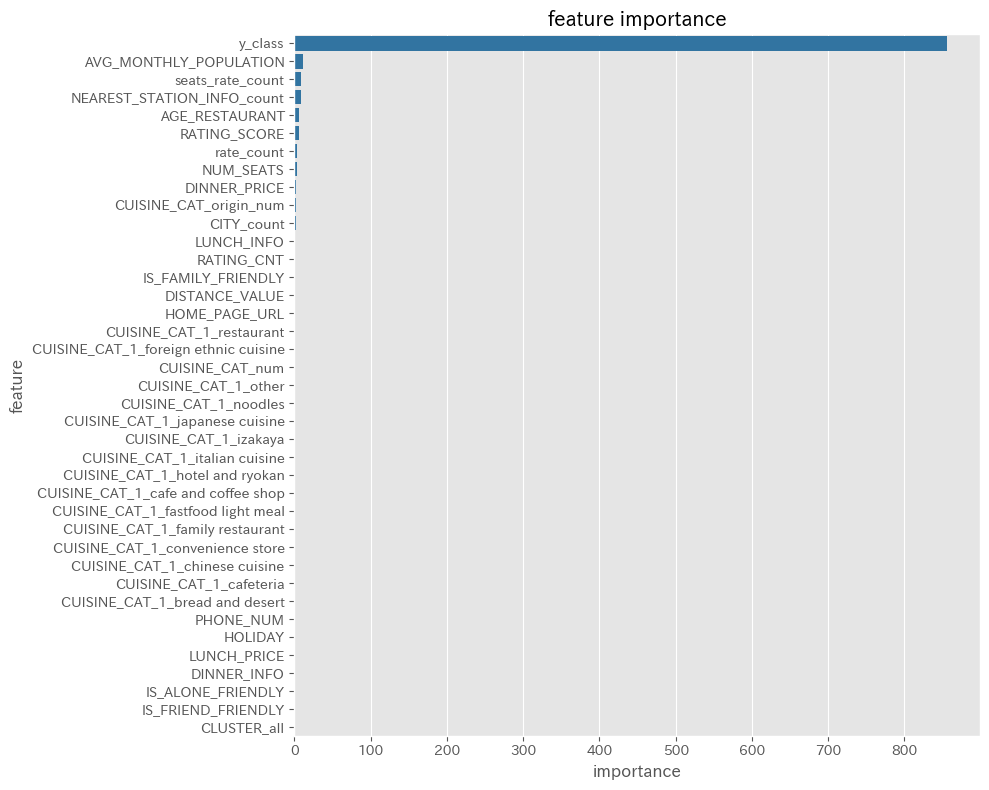


=== SHAP値の計算と可視化 


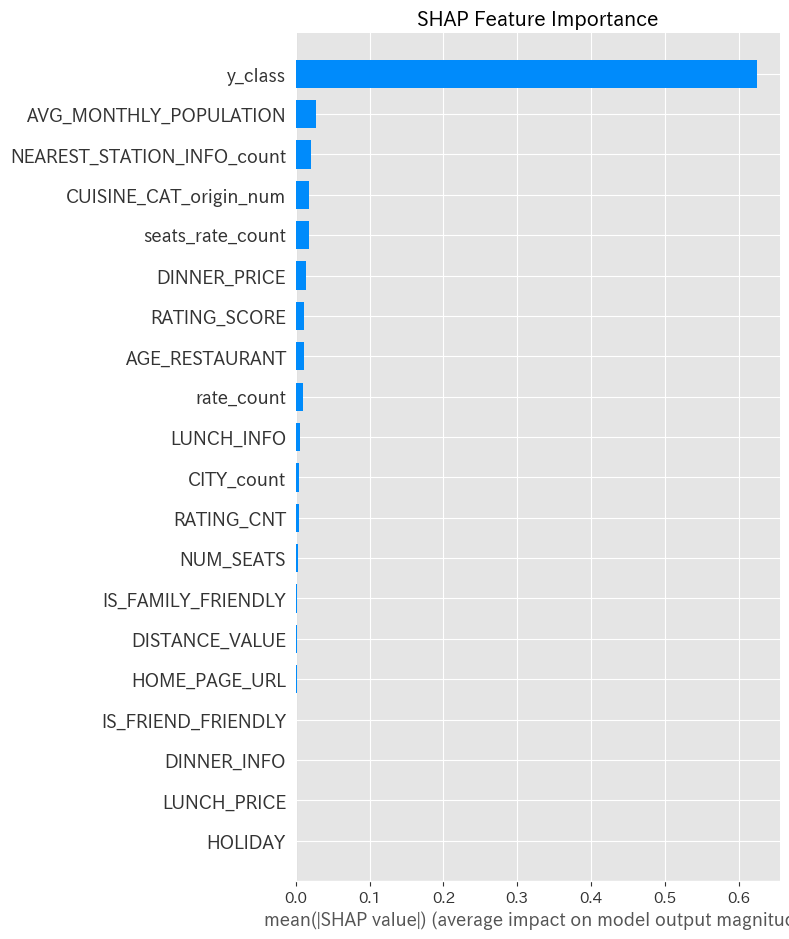

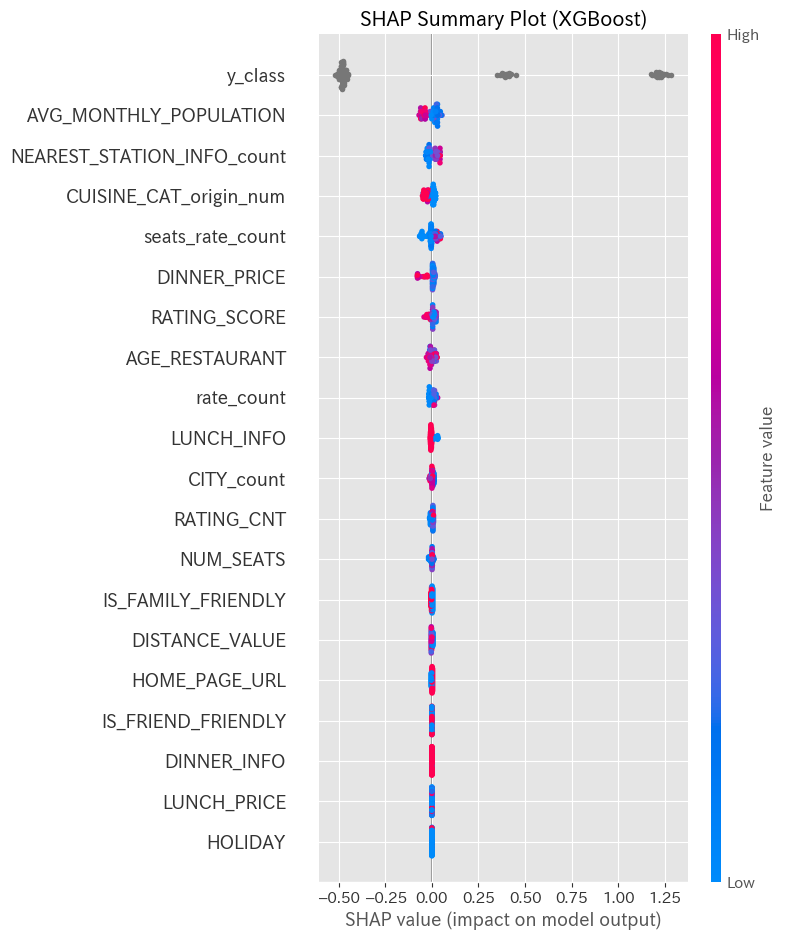

特徴量重要度（上位10個）:
                       feature  importance
37                     y_class  856.305470
0       AVG_MONTHLY_POPULATION   11.459406
34            seats_rate_count    8.395227
1   NEAREST_STATION_INFO_count    8.314585
16              AGE_RESTAURANT    5.814111
4                 RATING_SCORE    5.574619
33                  rate_count    3.236781
15                   NUM_SEATS    3.100853
10                DINNER_PRICE    2.690398
36      CUISINE_CAT_origin_num    2.385588
model:lightGBM
RMSE: 45.8146, MAE: 25.9169, MAPE: 30.20%, R²: 0.7760

=== 予測結果の可視化 ===


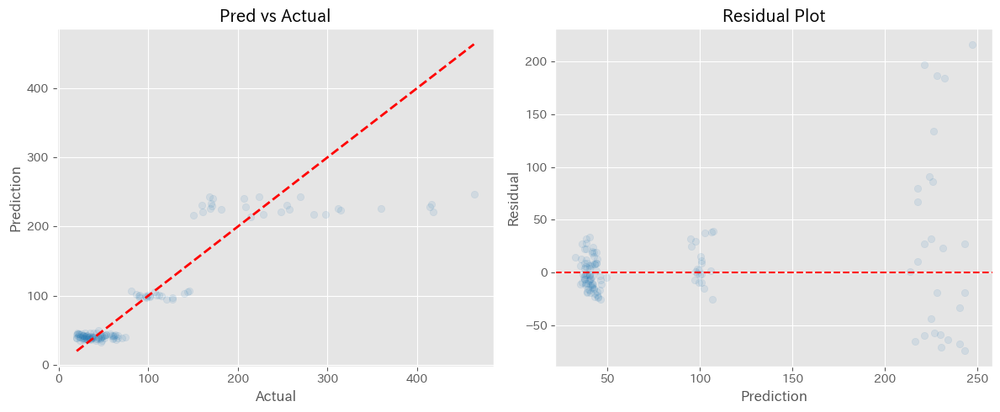


=== error vs actual ===


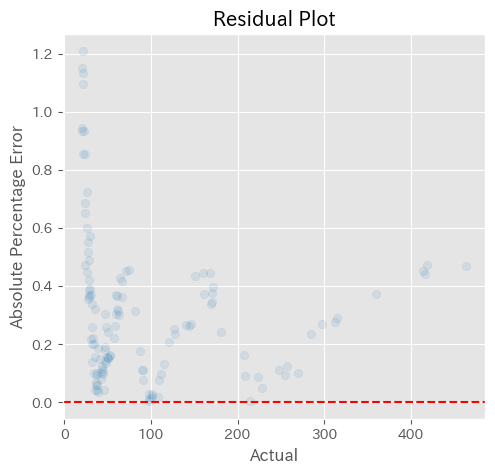

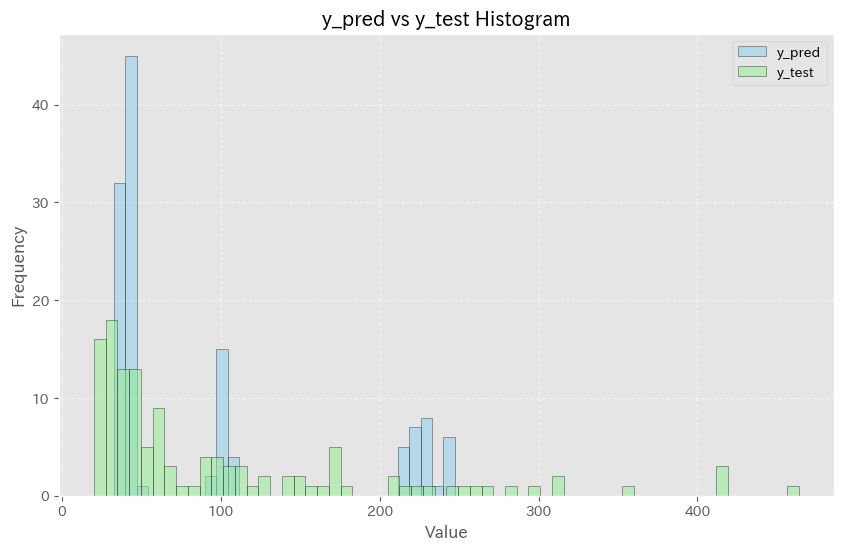


=== モデルの保存 ===
モデルを保存しました: lightgbm_sales_model.txt

=== 最適化結果の可視化 ===


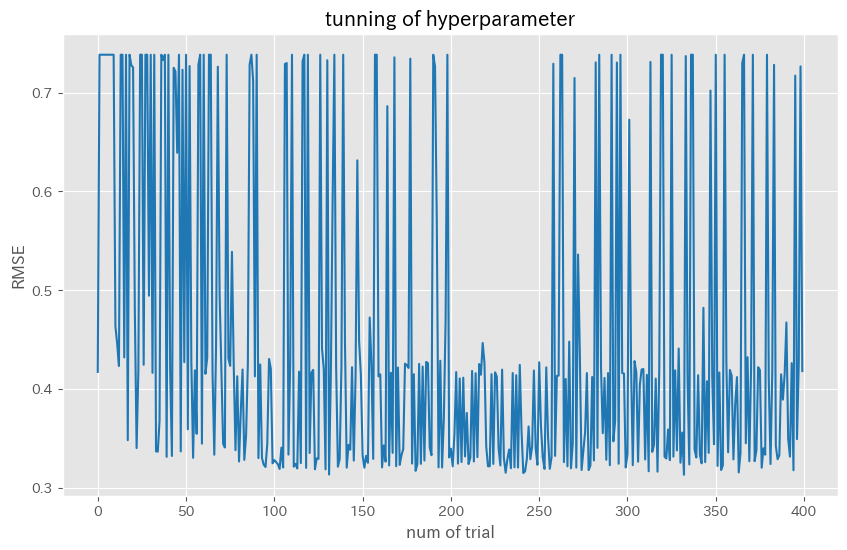


=== 完了 ===
LightGBM回帰モデルの作成とハイパーパラメータチューニングが完了しました。
生成されたファイル:
- lightgbm_sales_model.txt: 訓練済みモデル
- feature_importance.png: 特徴量重要度
- prediction_results.png: 予測結果
- optimization_progress.png: 最適化の進行
----------------------------------------------------------
CUISINE_CAT_1_fastfood light meal
標準化完了
訓練データ: (74, 39)
テストデータ: (19, 39)

=== ハイパーパラメータチューニング ===
Optunaを使用してハイパーパラメータを最適化中...

--- lightGBM ---
最適化完了!
最適なRMSE: 0.2945
最適なパラメータ: {'num_leaves': 207, 'max_depth': 11, 'learning_rate': 0.047453677944075956, 'feature_fraction': 0.8171692673533452, 'bagging_fraction': 0.49328528925777526, 'bagging_freq': 10, 'min_child_samples': 10, 'min_gain_to_split': 0.14053176147276802, 'reg_alpha': 4.372223612275976e-09, 'reg_lambda': 0.010673323137599017}

=== 最適なパラメータでモデル訓練 ===
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[87]	valid_0's rmse: 0.305309

=== 最終モデルの評価結果 （対数変換後）===
RMSE: 0.3053
MAE: 0.2666
MAPE: 0.0653
R² Score: 0.8579

=== 最終モデルの評価結果

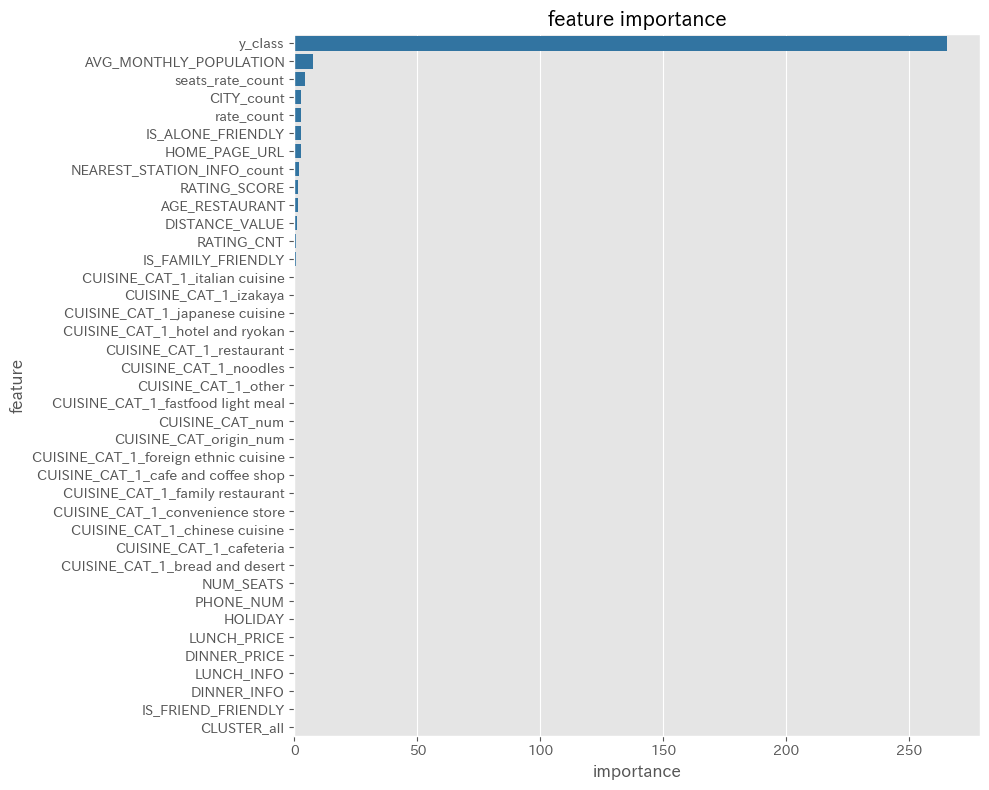


=== SHAP値の計算と可視化 


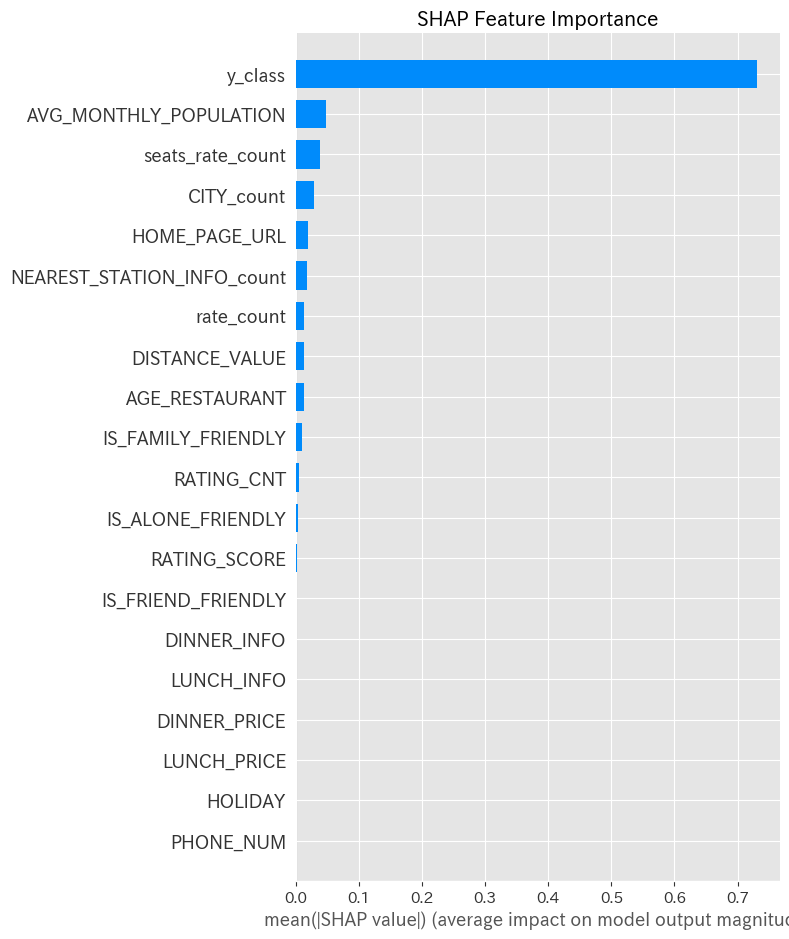

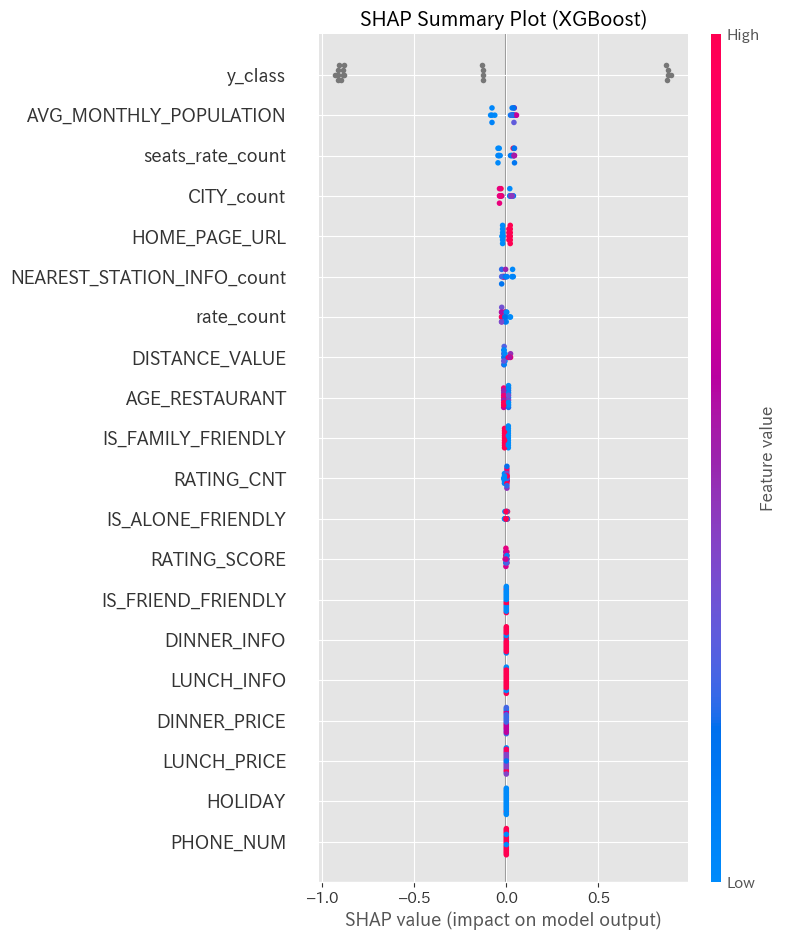

特徴量重要度（上位10個）:
                       feature  importance
37                     y_class  265.586397
0       AVG_MONTHLY_POPULATION    7.638159
34            seats_rate_count    4.459076
17                  CITY_count    2.657836
33                  rate_count    2.633479
7            IS_ALONE_FRIENDLY    2.590511
13               HOME_PAGE_URL    2.545658
1   NEAREST_STATION_INFO_count    2.052375
4                 RATING_SCORE    1.463536
16              AGE_RESTAURANT    1.314809
model:lightGBM
RMSE: 28.6107, MAE: 23.0517, MAPE: 27.15%, R²: 0.8971

=== 予測結果の可視化 ===


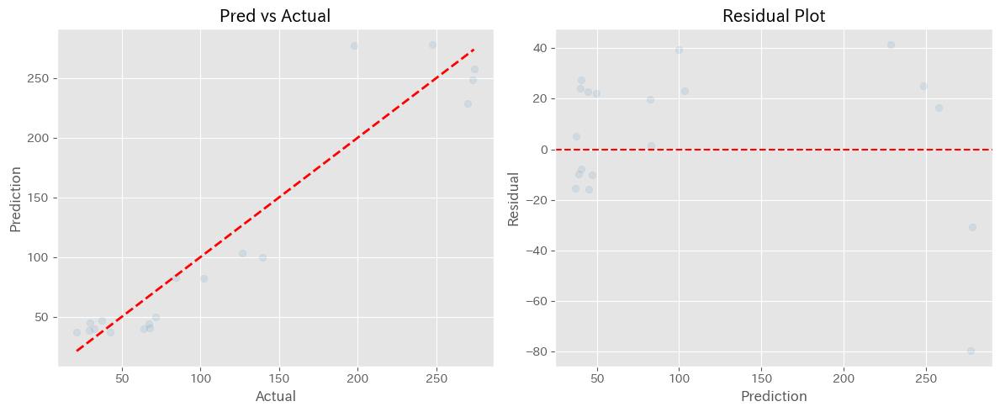


=== error vs actual ===


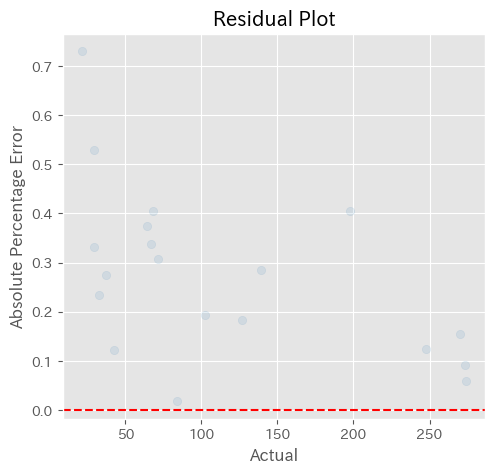

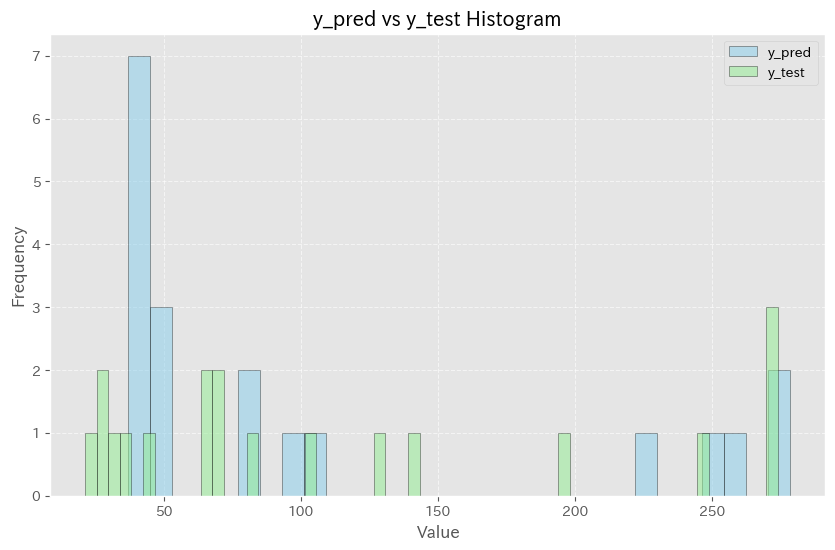


=== モデルの保存 ===
モデルを保存しました: lightgbm_sales_model.txt

=== 最適化結果の可視化 ===


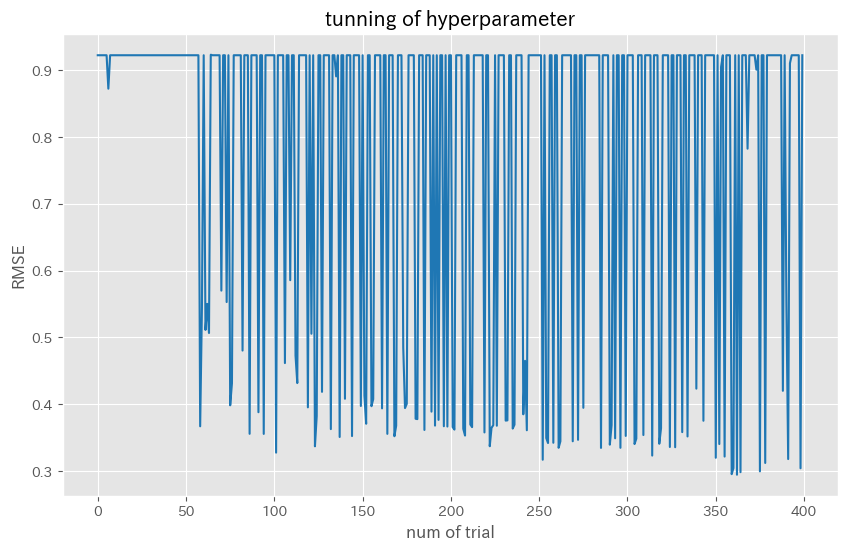


=== 完了 ===
LightGBM回帰モデルの作成とハイパーパラメータチューニングが完了しました。
生成されたファイル:
- lightgbm_sales_model.txt: 訓練済みモデル
- feature_importance.png: 特徴量重要度
- prediction_results.png: 予測結果
- optimization_progress.png: 最適化の進行
----------------------------------------------------------
CUISINE_CAT_1_foreign ethnic cuisine
標準化完了
訓練データ: (352, 39)
テストデータ: (88, 39)

=== ハイパーパラメータチューニング ===
Optunaを使用してハイパーパラメータを最適化中...

--- lightGBM ---
最適化完了!
最適なRMSE: 0.3422
最適なパラメータ: {'num_leaves': 13, 'max_depth': 20, 'learning_rate': 0.023102892792704062, 'feature_fraction': 0.9711762835557426, 'bagging_fraction': 0.4899841233651569, 'bagging_freq': 5, 'min_child_samples': 10, 'min_gain_to_split': 0.056023995338479605, 'reg_alpha': 1.2164542989021866e-05, 'reg_lambda': 3.872685789898642}

=== 最適なパラメータでモデル訓練 ===
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[198]	valid_0's rmse: 0.365535

=== 最終モデルの評価結果 （対数変換後）===
RMSE: 0.3655
MAE: 0.2875
MAPE: 0.0736
R² Score: 0.8108

=== 最終モデルの評価結

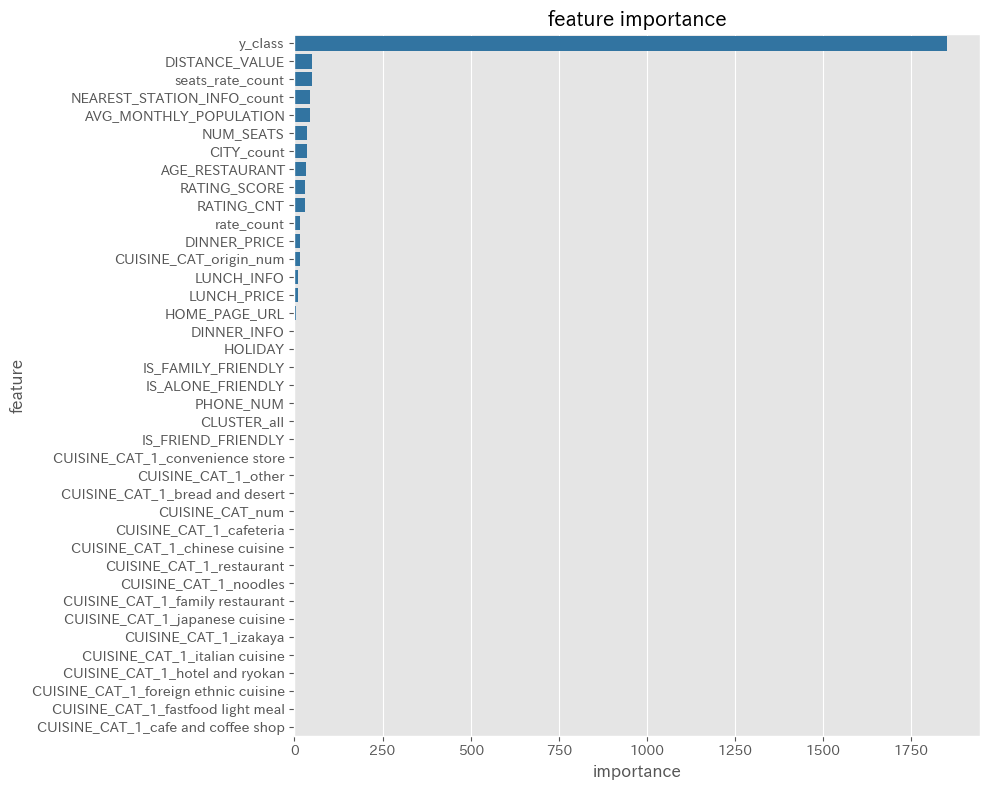


=== SHAP値の計算と可視化 


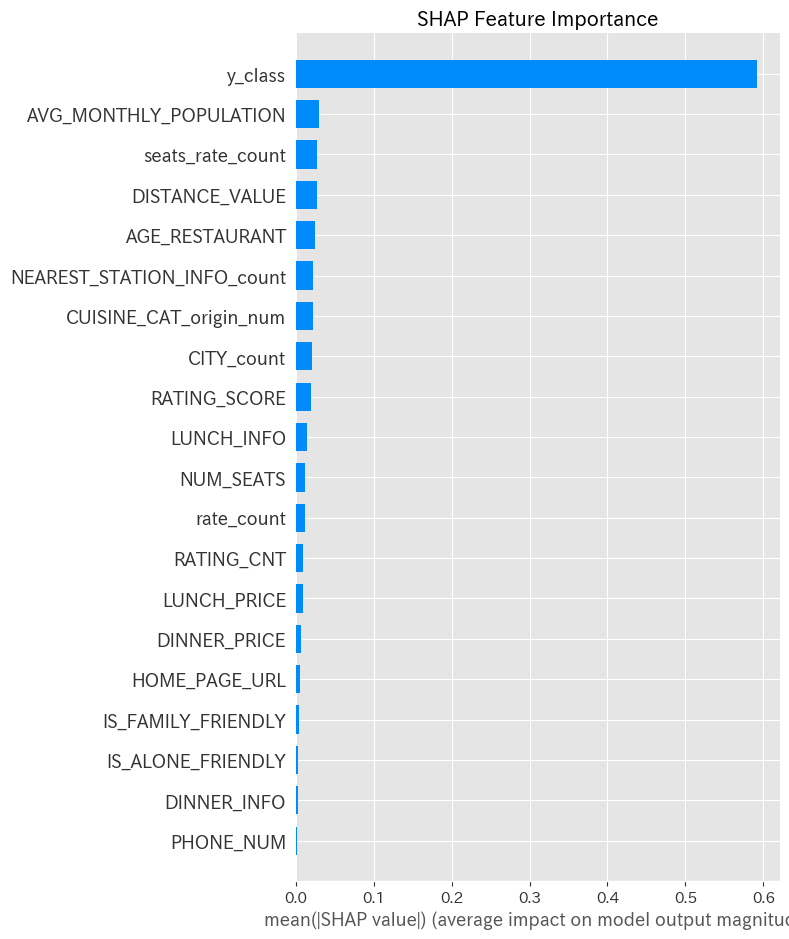

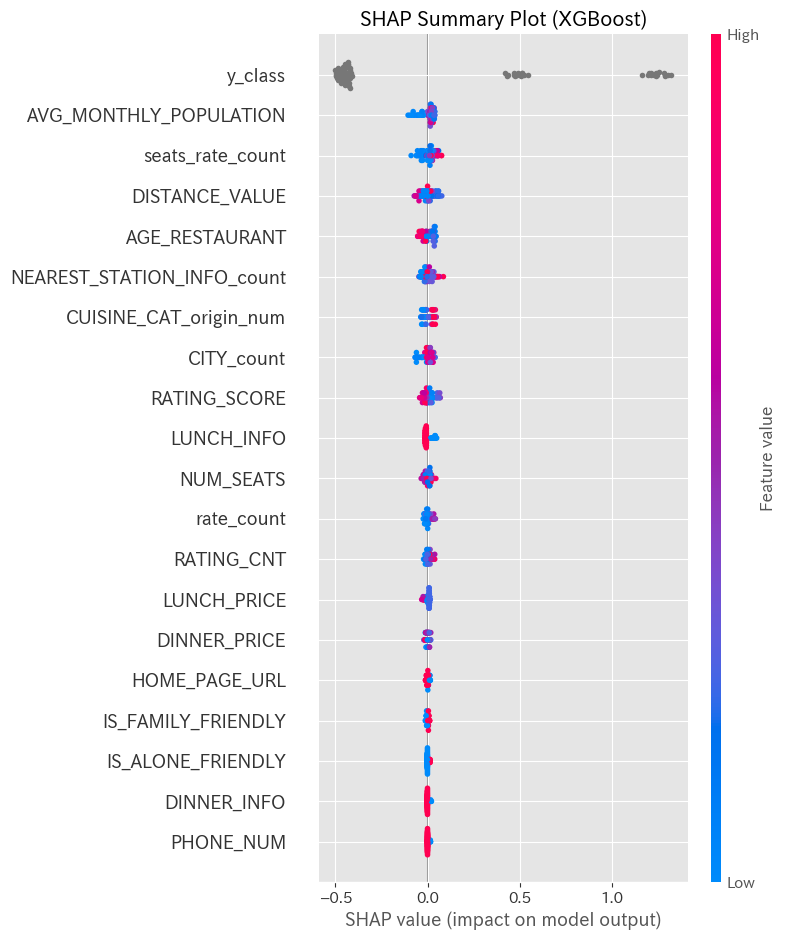

特徴量重要度（上位10個）:
                       feature   importance
37                     y_class  1852.207630
2               DISTANCE_VALUE    50.001774
34            seats_rate_count    49.000365
1   NEAREST_STATION_INFO_count    45.662558
0       AVG_MONTHLY_POPULATION    45.223105
15                   NUM_SEATS    36.765846
17                  CITY_count    36.300775
16              AGE_RESTAURANT    34.279097
4                 RATING_SCORE    30.299435
3                   RATING_CNT    30.011107
model:lightGBM
RMSE: 60.9471, MAE: 26.4890, MAPE: 29.83%, R²: 0.6763

=== 予測結果の可視化 ===


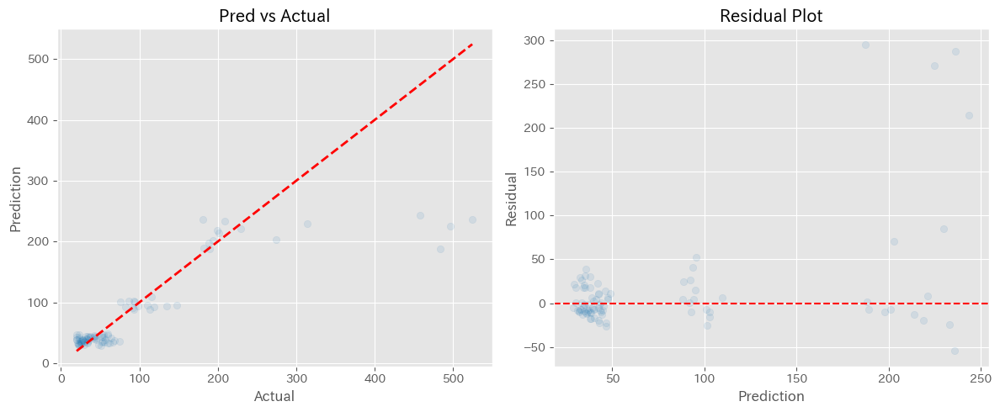


=== error vs actual ===


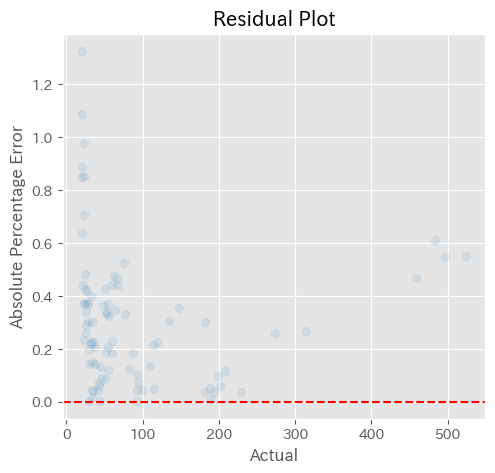

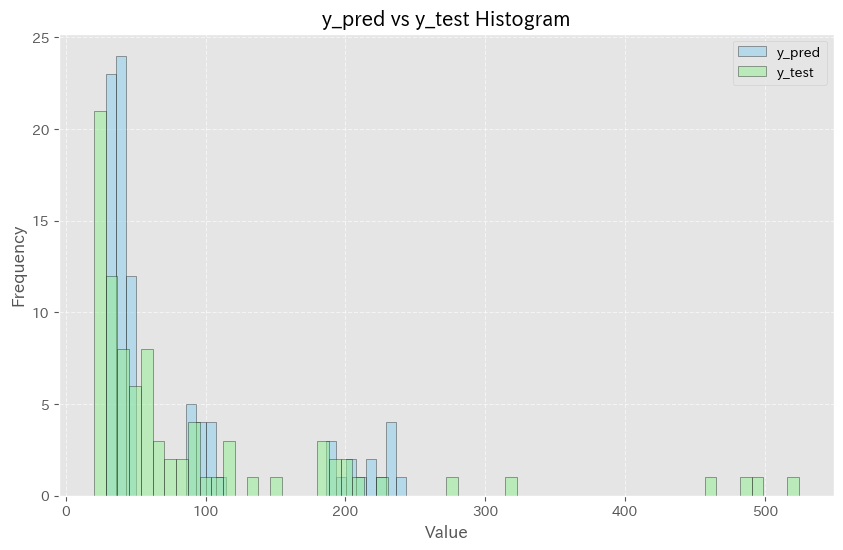


=== モデルの保存 ===
モデルを保存しました: lightgbm_sales_model.txt

=== 最適化結果の可視化 ===


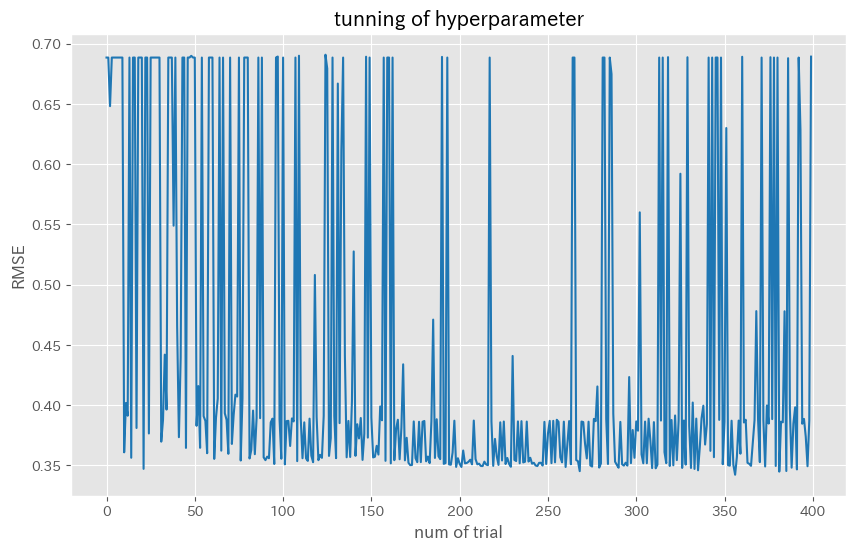


=== 完了 ===
LightGBM回帰モデルの作成とハイパーパラメータチューニングが完了しました。
生成されたファイル:
- lightgbm_sales_model.txt: 訓練済みモデル
- feature_importance.png: 特徴量重要度
- prediction_results.png: 予測結果
- optimization_progress.png: 最適化の進行
----------------------------------------------------------
CUISINE_CAT_1_hotel and ryokan
標準化完了
訓練データ: (8, 39)
テストデータ: (2, 39)

=== ハイパーパラメータチューニング ===
Optunaを使用してハイパーパラメータを最適化中...

--- lightGBM ---
最適化完了!
最適なRMSE: 0.7239
最適なパラメータ: {'num_leaves': 231, 'max_depth': 20, 'learning_rate': 0.0007442119855937606, 'feature_fraction': 0.9116489236054501, 'bagging_fraction': 0.7097634592061622, 'bagging_freq': 1, 'min_child_samples': 647, 'min_gain_to_split': 0.021136828353024995, 'reg_alpha': 0.05379804349038668, 'reg_lambda': 9.458596404953745e-08}

=== 最適なパラメータでモデル訓練 ===
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[1]	valid_0's rmse: 1.35199

=== 最終モデルの評価結果 （対数変換後）===
RMSE: 1.3520
MAE: 0.9924
MAPE: 0.1680
R² Score: -1.1681

=== 最終モデルの評価結果 （オリジナ

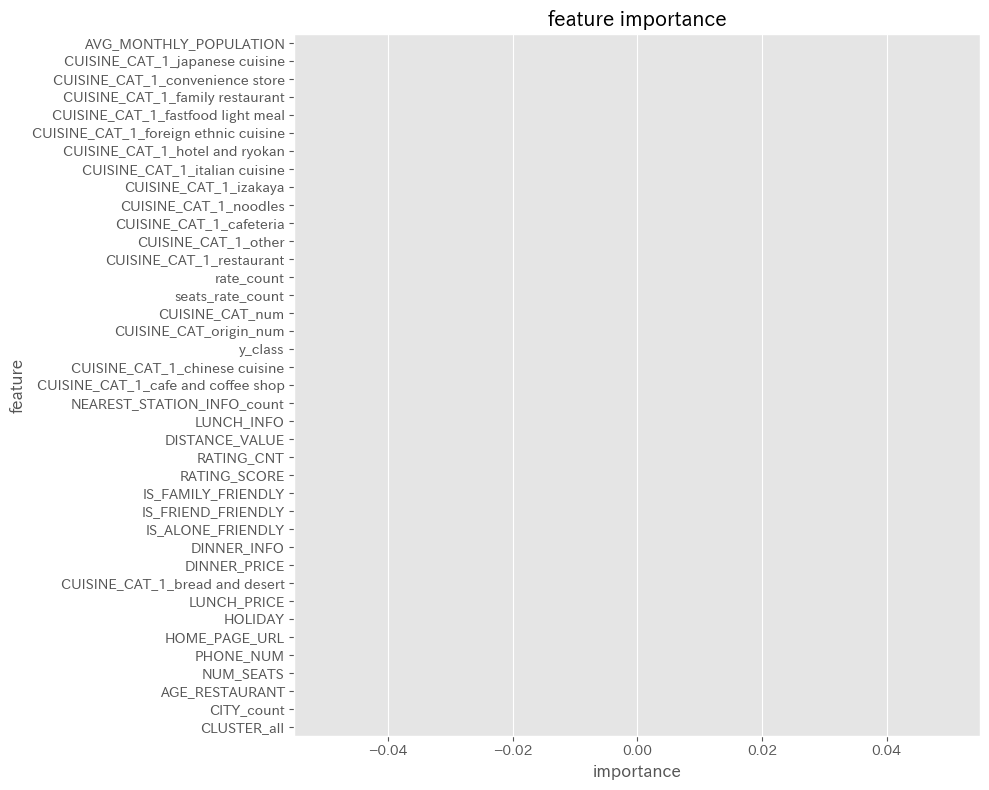


=== SHAP値の計算と可視化 


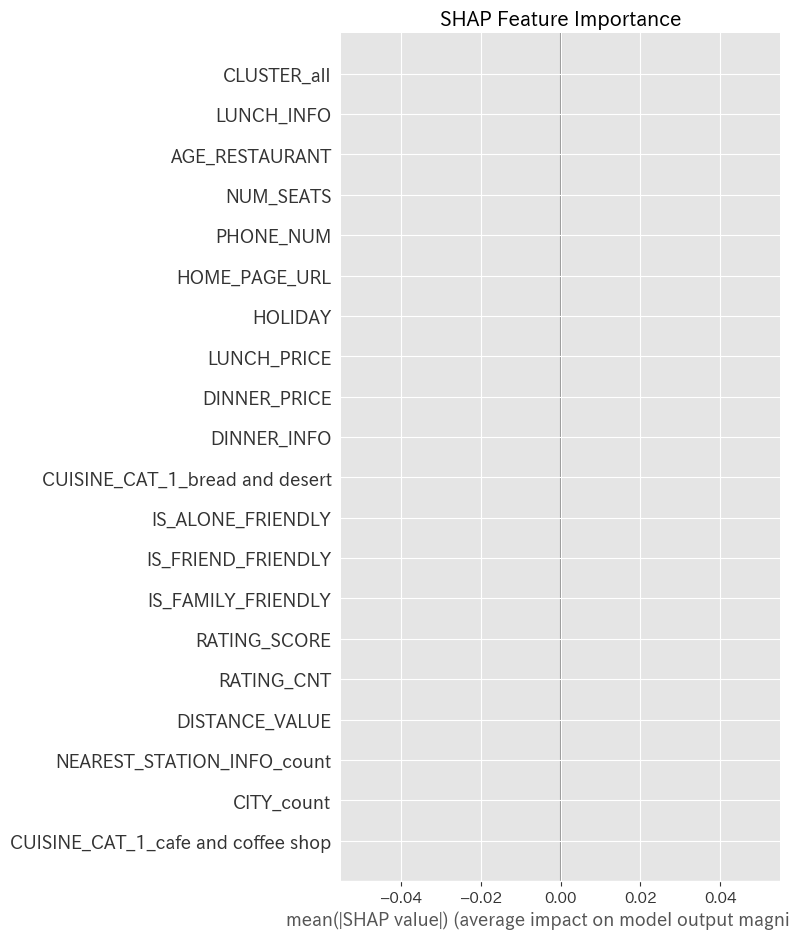

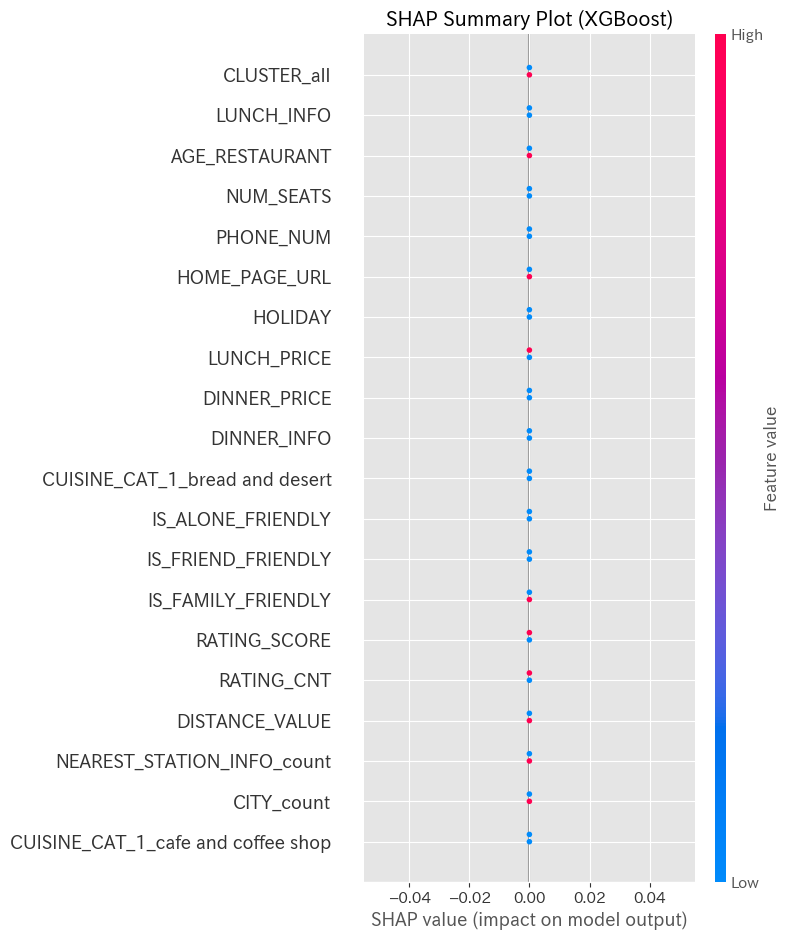

特徴量重要度（上位10個）:
                                 feature  importance
0                 AVG_MONTHLY_POPULATION         0.0
29        CUISINE_CAT_1_japanese cuisine         0.0
22       CUISINE_CAT_1_convenience store         0.0
23       CUISINE_CAT_1_family restaurant         0.0
24     CUISINE_CAT_1_fastfood light meal         0.0
25  CUISINE_CAT_1_foreign ethnic cuisine         0.0
26        CUISINE_CAT_1_hotel and ryokan         0.0
27         CUISINE_CAT_1_italian cuisine         0.0
28                 CUISINE_CAT_1_izakaya         0.0
30                 CUISINE_CAT_1_noodles         0.0
model:lightGBM
RMSE: 243.8161, MAE: 174.6939, MAPE: 46.34%, R²: -1.0549

=== 予測結果の可視化 ===


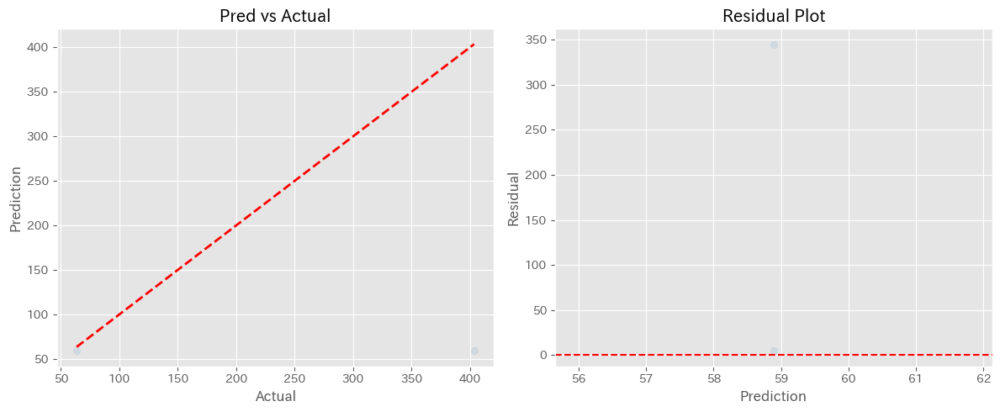


=== error vs actual ===


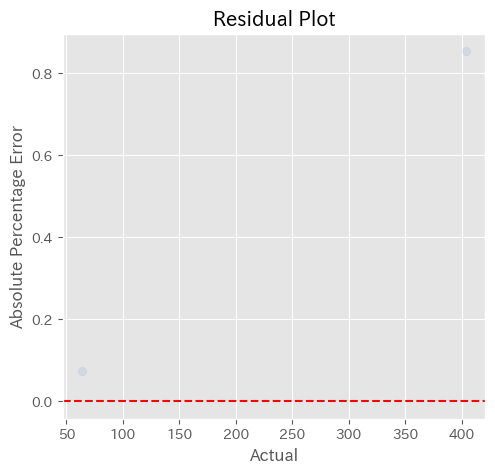

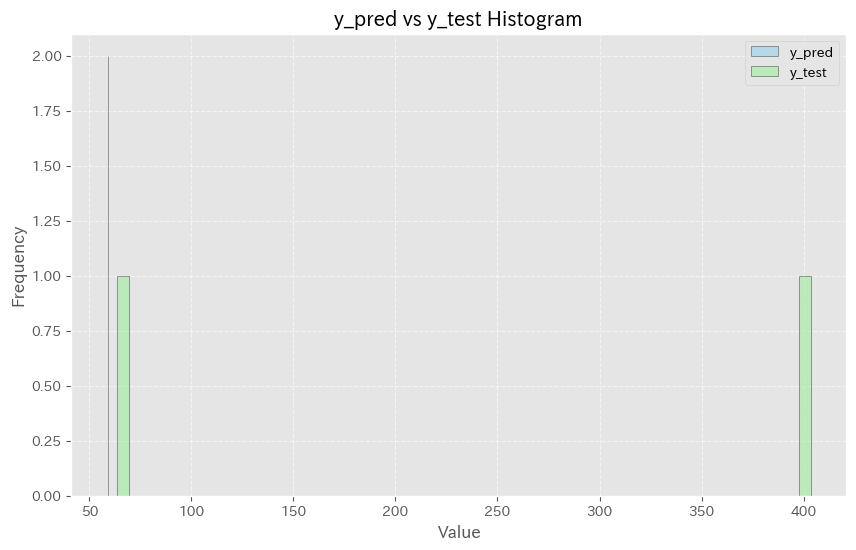


=== モデルの保存 ===
モデルを保存しました: lightgbm_sales_model.txt

=== 最適化結果の可視化 ===


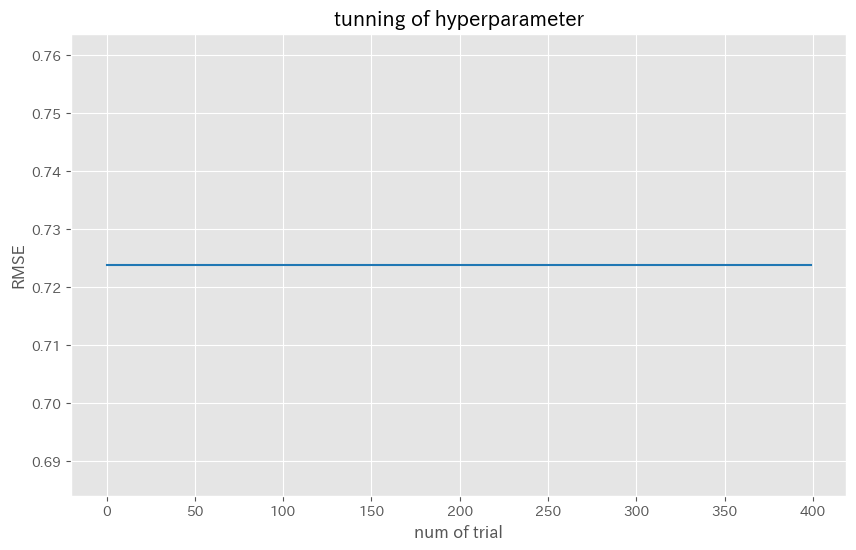


=== 完了 ===
LightGBM回帰モデルの作成とハイパーパラメータチューニングが完了しました。
生成されたファイル:
- lightgbm_sales_model.txt: 訓練済みモデル
- feature_importance.png: 特徴量重要度
- prediction_results.png: 予測結果
- optimization_progress.png: 最適化の進行
----------------------------------------------------------
CUISINE_CAT_1_italian cuisine
標準化完了
訓練データ: (492, 39)
テストデータ: (123, 39)

=== ハイパーパラメータチューニング ===
Optunaを使用してハイパーパラメータを最適化中...

--- lightGBM ---
最適化完了!
最適なRMSE: 0.3188
最適なパラメータ: {'num_leaves': 122, 'max_depth': 5, 'learning_rate': 0.0868345315604573, 'feature_fraction': 0.7849873283821005, 'bagging_fraction': 0.8737562361076247, 'bagging_freq': 4, 'min_child_samples': 59, 'min_gain_to_split': 0.4575391611807034, 'reg_alpha': 1.3166278006540036e-05, 'reg_lambda': 0.00047171230385699507}

=== 最適なパラメータでモデル訓練 ===
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[48]	valid_0's rmse: 0.340147

=== 最終モデルの評価結果 （対数変換後）===
RMSE: 0.3401
MAE: 0.2732
MAPE: 0.0672
R² Score: 0.8263

=== 最終モデルの評価結果 （オリジ

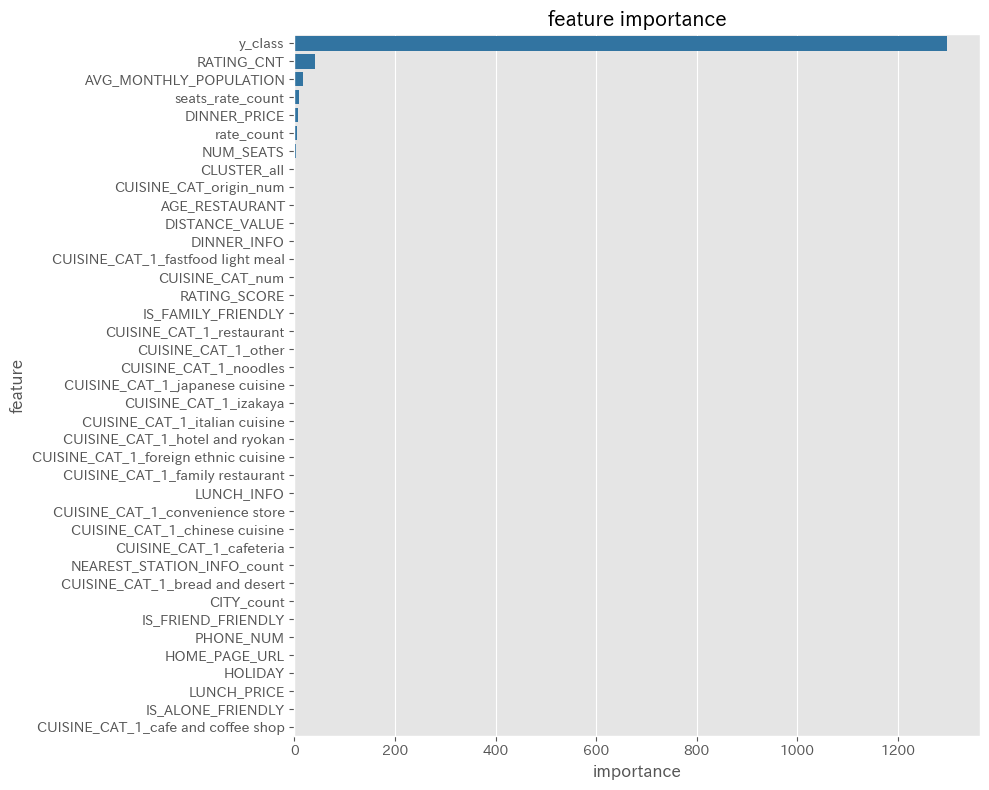


=== SHAP値の計算と可視化 


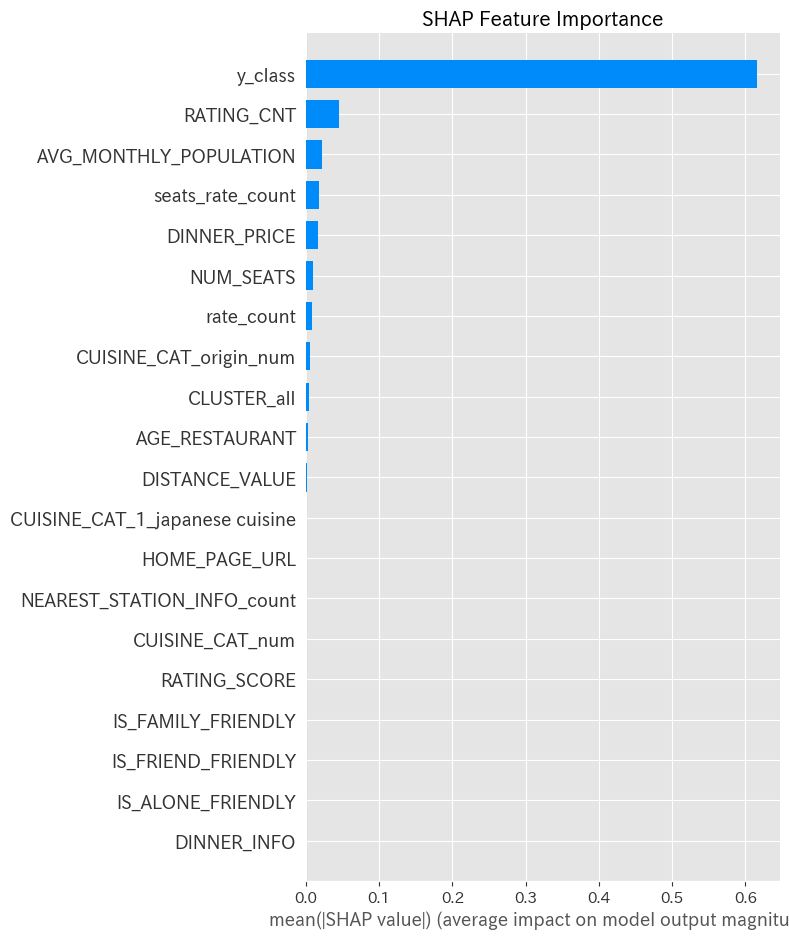

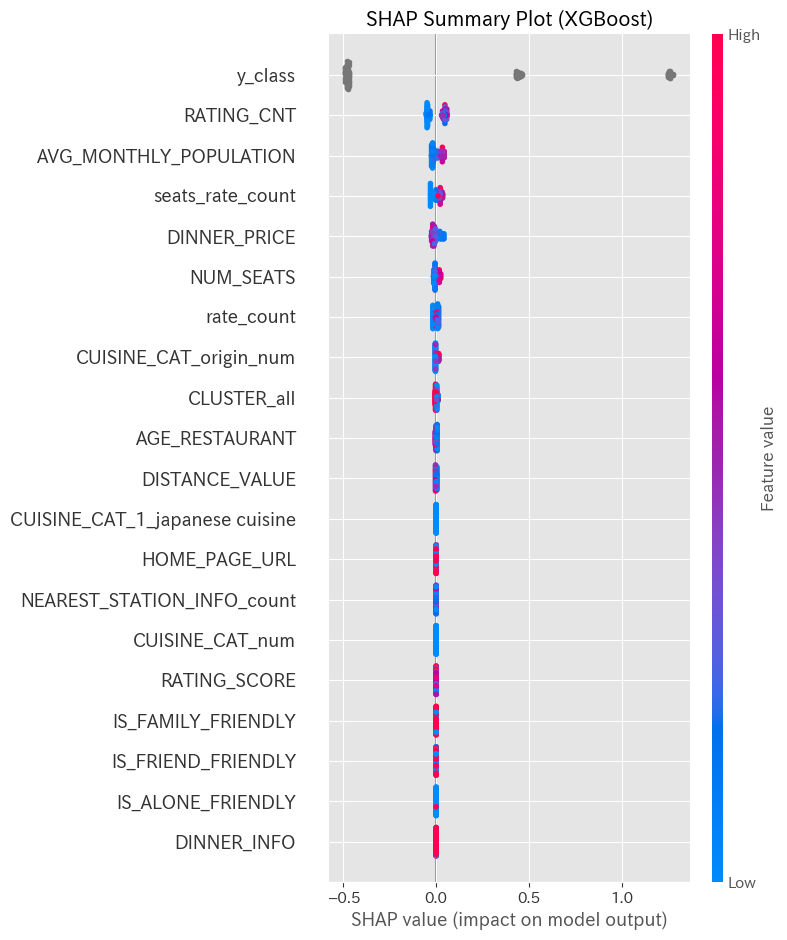

特徴量重要度（上位10個）:
                   feature   importance
37                 y_class  1298.050886
3               RATING_CNT    40.132104
0   AVG_MONTHLY_POPULATION    16.929850
34        seats_rate_count     8.172092
10            DINNER_PRICE     6.648852
33              rate_count     4.249742
15               NUM_SEATS     3.726234
38             CLUSTER_all     2.003610
36  CUISINE_CAT_origin_num     1.412254
16          AGE_RESTAURANT     1.273700
model:lightGBM
RMSE: 49.5512, MAE: 25.9548, MAPE: 27.11%, R²: 0.7729

=== 予測結果の可視化 ===


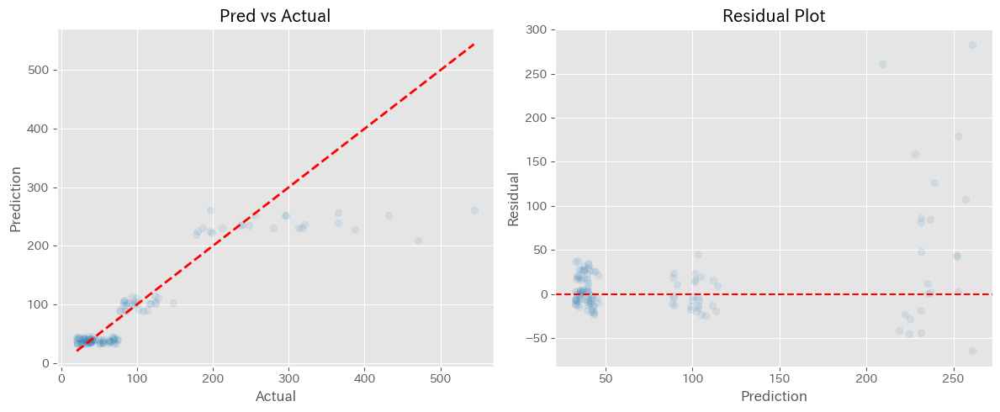


=== error vs actual ===


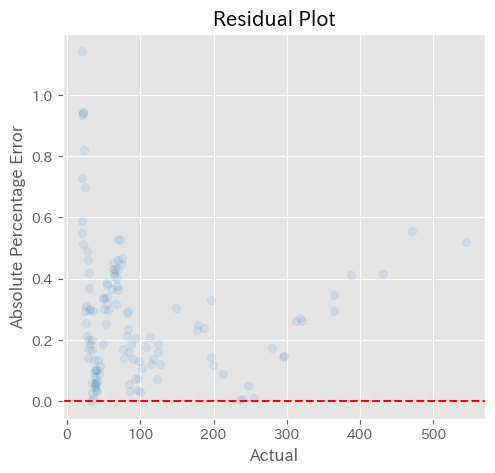

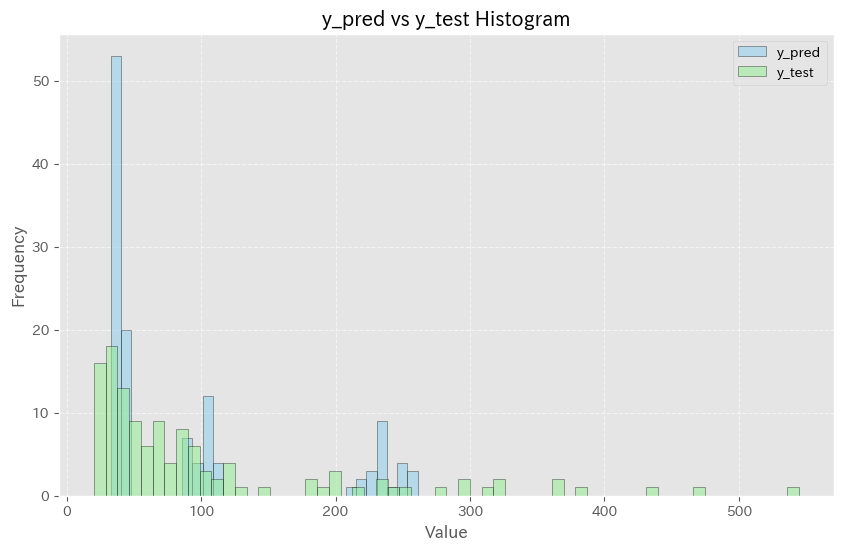


=== モデルの保存 ===
モデルを保存しました: lightgbm_sales_model.txt

=== 最適化結果の可視化 ===


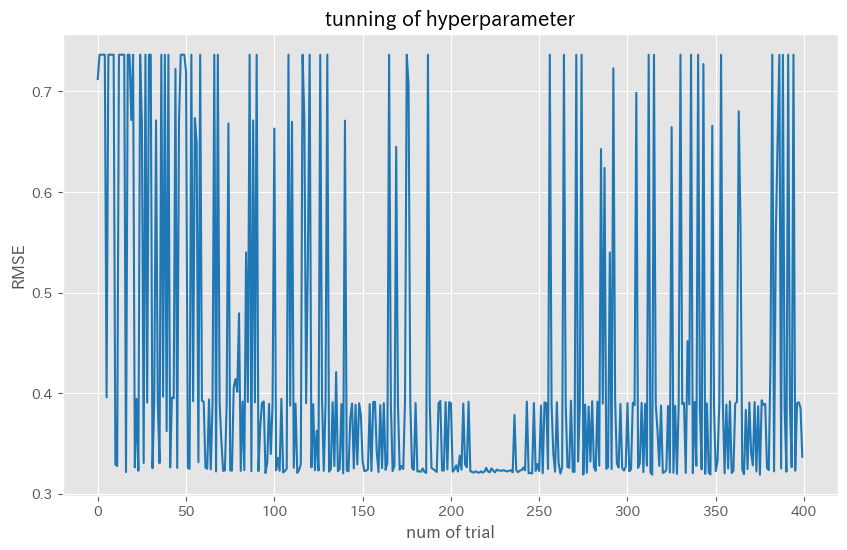


=== 完了 ===
LightGBM回帰モデルの作成とハイパーパラメータチューニングが完了しました。
生成されたファイル:
- lightgbm_sales_model.txt: 訓練済みモデル
- feature_importance.png: 特徴量重要度
- prediction_results.png: 予測結果
- optimization_progress.png: 最適化の進行
----------------------------------------------------------
CUISINE_CAT_1_izakaya
標準化完了
訓練データ: (1416, 39)
テストデータ: (355, 39)

=== ハイパーパラメータチューニング ===
Optunaを使用してハイパーパラメータを最適化中...

--- lightGBM ---


[W 2025-09-29 06:00:10,502] Trial 52 failed with parameters: {'num_leaves': 123, 'max_depth': 9, 'learning_rate': 0.05431180593862735, 'feature_fraction': 0.5707447730083546, 'bagging_fraction': 0.40074965013740393, 'bagging_freq': 2, 'min_child_samples': 43, 'min_gain_to_split': 0.4246549645066511, 'reg_alpha': 0.3383850182631531} because of the following error: KeyboardInterrupt().
Traceback (most recent call last):
  File "/home/katonaoto/py311env/lib/python3.11/site-packages/optuna/study/_optimize.py", line 201, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "/tmp/ipykernel_3482157/1610584324.py", line 75, in objective_lightGBM
    'reg_lambda': trial.suggest_float('reg_lambda', 1e-10, 10.0, log=True),
                  ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/katonaoto/py311env/lib/python3.11/site-packages/optuna/trial/_trial.py", line 161, in suggest_float
    suggested_value = self._suggest(name, distributio

KeyboardInterrupt: 

In [51]:
cuisine_cat = [
       'CUISINE_CAT_1_bread and desert', 'CUISINE_CAT_1_cafe and coffee shop',
       'CUISINE_CAT_1_cafeteria', 'CUISINE_CAT_1_chinese cuisine',
       #'CUISINE_CAT_1_convenience store', 'CUISINE_CAT_1_family restaurant',
       'CUISINE_CAT_1_fastfood light meal',
       'CUISINE_CAT_1_foreign ethnic cuisine',
       'CUISINE_CAT_1_hotel and ryokan', 
       'CUISINE_CAT_1_italian cuisine',
       'CUISINE_CAT_1_izakaya', 'CUISINE_CAT_1_japanese cuisine',
       'CUISINE_CAT_1_noodles', 
       'CUISINE_CAT_1_other',
       'CUISINE_CAT_1_restaurant'
]

for c in cuisine_cat:
    print("----------------------------------------------------------")
    print(c)
    final_model = train_test_model(aggregated_df[aggregated_df[c]==1], 'target_amount_tableau')

In [ ]:
aggregated_df

In [ ]:
for cuisine in aggregated_df['CUISINE_CAT_origin'].unique():
    print("----------------------------------------------------------")
    len_data = len(aggregated_df[aggregated_df["CUISINE_CAT_origin"]==cuisine])
    html_string = f"<h2><span style='font-size:20px; font-weight:bold;'>{cuisine} length of data ({len_data})</span></h2>"
    display(HTML(html_string))
    
    if len_data < 30:
        continue
    final_model = train_test_model(aggregated_df[aggregated_df["CUISINE_CAT_origin"]==cuisine], 'target_amount_tableau')

In [ ]:
def pinball_loss(y_true, y_pred, alpha=0.85):
    error = y_true - y_pred
    return np.mean(np.maximum(alpha * error, (alpha - 1) * error))

In [ ]:
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    mask = y_true > 0
    if not np.any(mask):
        return np.nan
    return np.mean(np.abs((y_true[mask] - y_pred[mask]) / y_true[mask])) * 100

In [ ]:
def plot_model_evaluation(y_true, y_pred, model_name):
    """
    Generates four evaluation plots for a model's predictions in a 2x2 grid.
    1. True vs. Predicted scatter plot.
    2. Residuals vs. Predicted scatter plot.
    3. Distribution comparison histogram.
    4. Actual vs. Absolute Percentage Error scatter plot.
    """
    print(f"\n--- Evaluation Plots for {model_name} ---")
    
    valid_indices = y_true > 0
    y_true_valid = y_true[valid_indices]
    y_pred_valid = y_pred[valid_indices]
    
    if len(y_true_valid) == 0:
        print(f"Skipping plots for {model_name} as there are no valid (y_true > 0) data points.")
        return

    fig, axes = plt.subplots(2, 2, figsize=(16, 14))
    fig.suptitle(f'Evaluation Plots for {model_name}', fontsize=16)

    # Plot 1: True vs. Predicted
    sns.scatterplot(x=y_true_valid, y=y_pred_valid, alpha=0.5, ax=axes[0, 0])
    min_val = 0 #min(y_true_valid.min(), y_pred_valid.min())
    max_val = 900 #max(y_true_valid.max(), y_pred_valid.max())
    axes[0, 0].plot([min_val, max_val], [min_val, max_val], 'r--', lw=2)
    axes[0, 0].set_title('True vs. Predicted Values')
    axes[0, 0].set_xlabel('True Values')
    axes[0, 0].set_ylabel('Predicted Values')
    axes[0,0].set_xlim(0,900)
    axes[0,0].set_ylim(0,900)
    axes[0, 0].grid(True)

    # Plot 2: Residuals vs. Predicted
    residuals = y_true_valid - y_pred_valid
    sns.scatterplot(x=y_pred_valid, y=residuals, alpha=0.5, ax=axes[0, 1])
    axes[0, 1].axhline(0, color='r', linestyle='--')
    axes[0, 1].set_title('Residuals vs. Predicted Values')
    axes[0, 1].set_xlabel('Predicted Values')
    axes[0, 1].set_ylabel('Residuals (True - Predicted)')
    axes[0, 1].grid(True)

    # Plot 3: Distribution Comparison
    sns.histplot(y_true_valid, color="blue", label='True Values', kde=True, stat="density", element="step", fill=False, ax=axes[1, 0])
    sns.histplot(y_pred_valid, color="red", label='Predicted Values', kde=True, stat="density", element="step", fill=False, ax=axes[1, 0])
    axes[1, 0].set_title('Distribution of True vs. Predicted Values')
    axes[1, 0].set_xlabel('Target Amount')
    axes[1, 0].legend()

    # Plot 4: Actual vs. Absolute Percentage Error
    abs_percentage_error = np.abs((y_true_valid - y_pred_valid) / y_true_valid) * 100
    sns.scatterplot(x=y_true_valid, y=abs_percentage_error, alpha=0.5, ax=axes[1, 1])
    axes[1, 1].set_title('Actual Values vs. Absolute Percentage Error')
    axes[1, 1].set_xlabel('Actual Values')
    axes[1, 1].set_ylabel('Absolute Percentage Error (%)')
    axes[1, 1].grid(True)

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

def objective_for_blending(weights, Z, y_true, alpha):
    y_pred = np.dot(Z, weights)
    return pinball_loss(y_true, y_pred, alpha)

In [ ]:
# グローバル変数としてデータフレームを読み込む
#global aggregated_df

# 特徴量とターゲットの定義
feature_columns = [
    'AVG_MONTHLY_POPULATION','DISTANCE_VALUE','rate_count',
    "seats_rate_count","DINNER_PRICE","LUNCH_PRICE",
    'AGE_RESTAURANT','NEAREST_STATION_INFO_count','RATING_CNT',
    'RATING_SCORE','DINNER_INFO',
    'LUNCH_INFO','HOME_PAGE_URL','PHONE_NUM','NUM_SEATS',
    'CITY_count', 'CUISINE_CAT', 'CUISINE_CAT_origin'
]
target_column = 'average_target_amount_in_length_of_relationship'


# 外れ値の除去
print("\n=== 外れ値の除去 ===")
initial_rows = len(aggregated_df)
print(f"除去前の行数: {initial_rows}")

# 1. `target_column` > 1000 のデータを除去
len_before_upper_clip = len(aggregated_df)
aggregated_df = aggregated_df[aggregated_df[target_column] <= 800]
print(f"'{target_column}' > 1000 を除去: {len_before_upper_clip - len(aggregated_df)} 行")

# 2. `target_amount_tableau` < 20 のデータを除去
len_before_lower_clip = len(aggregated_df)
aggregated_df = aggregated_df[aggregated_df['target_amount_tableau'] >= 30]
print(f"'target_amount_tableau' < 20 を除去: {len_before_lower_clip - len(aggregated_df)} 行")

# フィルタリング後のDataFrameのコピーを作成
aggregated_df = aggregated_df.copy()

final_rows = len(aggregated_df)
print(f"最終的な行数: {final_rows} (合計 {initial_rows - final_rows} 行除去)")
print(f"目標変数の統計 (除去後):\n{aggregated_df[target_column].describe()}")


# ============================================================
# 0. 前処理 (数値特徴量の標準化)
# ============================================================
print("\n" + "="*60)
print("0. Preprocessing (Standard Scaling)")
print("="*60)

# カテゴリカル特徴量をラベルエンコーディング
categorical_cols = ['CITY', 'CUISINE_CAT', 'CUISINE_CAT_origin']
for col in categorical_cols:
    if col in aggregated_df.columns:
        le = LabelEncoder()
        aggregated_df[col] = le.fit_transform(aggregated_df[col].astype(str))

standardize_columns = [
    'AVG_MONTHLY_POPULATION', 'DISTANCE_VALUE', 'rate_count', 'seats_rate_count',
    'DINNER_PRICE', 'LUNCH_PRICE', 'AGE_RESTAURANT', 'NEAREST_STATION_INFO_count',
    'RATING_CNT', 'RATING_SCORE', 'NUM_SEATS', 'CITY_count'
]

scaler = StandardScaler()
# 標準化対象のカラムが存在するか確認してから実行
existing_standardize_cols = [col for col in standardize_columns if col in aggregated_df.columns]
aggregated_df[existing_standardize_cols] = scaler.fit_transform(aggregated_df[existing_standardize_cols])

print("Numerical features standardized.")
print(aggregated_df[existing_standardize_cols].describe())

# ============================================================
# 1. Gating Classifier
# ============================================================
print("\n" + "="*60)
print("1. Gating Classifier")
print("="*60)

# 1-1. ラベル化
bins = [0, 120.69003434, 307.83363432, np.inf] # 実際のデータ分布の仮定に合わせて変更
labels = ['low', 'middle', 'high']
# 目的変数の下限を0にクリップしてNaNを防ぐ
target_clipped = aggregated_df[target_column].clip(0)
aggregated_df['target_class'] = pd.cut(target_clipped, bins=bins, labels=labels, right=False)

# ラベルのない行（NaN）を処理
# 'target_class'がNaNの行を特定し、除去するか、特定のカテゴリに割り当てる
# ここでは、最も一般的なクラス（'low'）に割り当てる例
if aggregated_df['target_class'].isnull().any():
    print(f"Warning: Found {aggregated_df['target_class'].isnull().sum()} rows with NaN target_class. Filling with 'low'.")
    aggregated_df['target_class'].fillna('low', inplace=True)

# ラベルのエンコーディング
le_class = LabelEncoder()
aggregated_df['target_class_encoded'] = le_class.fit_transform(aggregated_df['target_class'])

print("Class distribution:\n", aggregated_df['target_class'].value_counts())

# 1-2. 学習 (OOF)
print("\n--- 1-2. Gating Classifier Training (OOF) ---")

X = aggregated_df[feature_columns]
y_class = aggregated_df['target_class_encoded']

# カテゴリカル変数をPandasのカテゴリ型に変換
for col in X.select_dtypes(include=['object', 'category']).columns:
    X[col] = X[col].astype('category')

oof_gate_proba = np.zeros((len(aggregated_df), len(labels)))

skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

for fold, (train_idx, val_idx) in enumerate(skf.split(X, y_class)):
    print(f"  Fold {fold+1}")
    X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
    y_train, y_val = y_class.iloc[train_idx], y_class.iloc[val_idx]
    
    clf = lgb.LGBMClassifier(random_state=42, class_weight='balanced')
    clf.fit(X_train, y_train, categorical_feature='auto')
    
    oof_gate_proba[val_idx] = clf.predict_proba(X_val)
    
aggregated_df[['p_low', 'p_middle', 'p_high']] = oof_gate_proba
print("OOF gate probabilities calculated and added to dataframe.")

# 1-3. 評価
print("\n--- 1-3. Gating Classifier Evaluation ---")
oof_gate_pred_labels = np.argmax(oof_gate_proba, axis=1)

# LabelEncoderのクラス順序とレポートのラベル順序を一致させる
report_labels = le_class.inverse_transform(np.arange(len(labels)))

print("Classification Report (OOF):")
print(classification_report(y_class, oof_gate_pred_labels, target_names=report_labels))
print("Confusion Matrix (OOF):")
cm = confusion_matrix(y_class, oof_gate_pred_labels)
sns.heatmap(cm, annot=True, fmt='d', xticklabels=report_labels, yticklabels=report_labels)
plt.title('Confusion Matrix (OOF)')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# ============================================================
# 2. Expert Regressors Training (OOF)
# ============================================================
print("\n" + "="*60)
print("2. Expert Regressors Training (OOF)")
print("="*60)

y_regr = aggregated_df[target_column]
# 対数変換した目的変数を用意 (NaNを防ぐためにclip)
y_regr_log = np.log1p(y_regr.clip(0))

oof_preds = {}

base_models = {
    'LightGBM': lgb.LGBMRegressor(random_state=42),
    'CatBoost': CatBoostRegressor(random_state=42, verbose=0),
    'Ridge': Ridge(random_state=42),
    'Tweedie': TweedieRegressor(power=1.5, link='log')
}

for name, model in base_models.items():
    print(f"\n--- Training {name} ---")
    use_log_transform = name in ['LightGBM', 'CatBoost', 'Ridge']
    
    oof_pred_on_fit_scale = np.zeros(len(aggregated_df))

    for fold, (train_idx, val_idx) in enumerate(skf.split(X, y_class)):
        print(f"  Fold {fold+1}")
        X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]

        if use_log_transform:
            y_train_regr = y_regr_log.iloc[train_idx]
        else:
            y_train_regr = y_regr.iloc[train_idx]

        if name == 'Tweedie':
            y_train_regr = np.maximum(y_train_regr, 1e-8)
            
        model.fit(X_train, y_train_regr)
        oof_pred_on_fit_scale[val_idx] = model.predict(X_val)
        
    if use_log_transform:
        oof_pred = np.expm1(oof_pred_on_fit_scale)
    else:
        oof_pred = oof_pred_on_fit_scale

    oof_preds[name] = oof_pred
    aggregated_df[f'oof_{name}'] = oof_pred
    
    rmse = np.sqrt(mean_squared_error(y_regr, oof_pred))
    print(f"  {name} OOF RMSE: {rmse:.4f}")
    
# ============================================================
# 3. Mixture of Experts (Method A: Representative Values)
# ============================================================
print("\n" + "="*60)
print("3. Mixture of Experts (Method A: Representative Values)")
print("="*60)

class_medians = aggregated_df.groupby('target_class')[target_column].median()
print("Representative Values (Median) for each class:")
print(class_medians)

# ゲート確率と代表値を掛け合わせて予測を作成
# le_class.classes_でLabelEncoderが学習したクラス名を取得し、その順序で中央値を取得
ordered_medians = class_medians[le_class.classes_].values
oof_mixture = np.sum(oof_gate_proba * ordered_medians, axis=1)

aggregated_df['oof_mixture'] = oof_mixture
mixture_rmse = np.sqrt(mean_squared_error(y_regr, oof_mixture))
print(f"\nMixture Model OOF RMSE: {mixture_rmse:.4f}")

# ============================================================
# 4. Blending (Weighted Average with Pinball Loss Optimization)
# ============================================================
print("\n" + "="*60)
print("4. Blending (Weighted Average with Pinball Loss Optimization)")
print("="*60)

oof_columns_for_blending = [f'oof_{name}' for name in base_models.keys()] + ['oof_mixture']
print(f"Blending models: {oof_columns_for_blending}\n")
Z_blend = aggregated_df[oof_columns_for_blending].values

initial_weights = np.ones(Z_blend.shape[1]) / Z_blend.shape[1]
bounds = [(0, 1)] * Z_blend.shape[1]
constraints = ({'type': 'eq', 'fun': lambda weights: np.sum(weights) - 1})

result = minimize(
    objective_for_blending,
    initial_weights,
    args=(Z_blend, y_regr.values, 0.85),
    method='SLSQP',
    bounds=bounds,
    constraints=constraints
)

optimal_weights_blend = result.x
print("Optimal Weights for Blending:")
for name, weight in zip(oof_columns_for_blending, optimal_weights_blend):
    print(f"  {name}: {weight:.4f}")
    
aggregated_df['oof_blend'] = np.dot(Z_blend, optimal_weights_blend)
blend_rmse = np.sqrt(mean_squared_error(y_regr, aggregated_df['oof_blend']))
blend_pinball = pinball_loss(y_regr, aggregated_df['oof_blend'])
print(f"\nBlend Model OOF RMSE: {blend_rmse:.4f}")
print(f"Blend Model OOF Pinball Loss (alpha=0.85): {blend_pinball:.4f}")

# ============================================================
# 5. Stacking (Meta-Learning)
# ============================================================
print("\n" + "="*60)
print("5. Stacking (Meta-Learning)")
print("="*60)

meta_features = oof_columns_for_blending
print(f"Meta-features for stacking: {meta_features}\n")
X_meta = aggregated_df[meta_features]
y_meta = y_regr

oof_stack = np.zeros(len(aggregated_df))

meta_model = QuantileRegressor(quantile=0.7, alpha=0, solver='highs')

for fold, (train_idx, val_idx) in enumerate(skf.split(X, y_class)):
    print(f"  Fold {fold+1}")
    X_meta_train, X_meta_val = X_meta.iloc[train_idx], X_meta.iloc[val_idx]
    y_meta_train, y_meta_val = y_meta.iloc[train_idx], y_meta.iloc[val_idx]

    meta_model.fit(X_meta_train, y_meta_train)
    oof_stack[val_idx] = meta_model.predict(X_meta_val)
    
aggregated_df['oof_stack'] = oof_stack
stack_rmse = np.sqrt(mean_squared_error(y_regr, aggregated_df['oof_stack']))
stack_pinball = pinball_loss(y_regr, aggregated_df['oof_stack'])
print(f"\nStacking Model OOF RMSE: {stack_rmse:.4f}")
print(f"Stacking Model OOF Pinball Loss (alpha=0.85): {stack_pinball:.4f}")

# ============================================================
# 6. Final Integration (Double Blend)
# ============================================================
print("\n" + "="*60)
print("6. Final Integration (Double Blend)")
print("="*60)

Z_final_blend = aggregated_df[['oof_blend', 'oof_stack']].values

initial_weights_final = np.ones(Z_final_blend.shape[1]) / Z_final_blend.shape[1]
bounds_final = [(0, 1)] * Z_final_blend.shape[1]
constraints_final = ({'type': 'eq', 'fun': lambda weights: np.sum(weights) - 1})

result_final = minimize(
    objective_for_blending,
    initial_weights_final,
    args=(Z_final_blend, y_regr.values, 0.7),
    method='SLSQP',
    bounds=bounds_final,
    constraints=constraints_final
)

optimal_weights_final = result_final.x
print("\nOptimal Weights for Final Blend:")
print(f"  oof_blend: {optimal_weights_final[0]:.4f}")
print(f"  oof_stack: {optimal_weights_final[1]:.4f}")

aggregated_df['oof_final'] = np.dot(Z_final_blend, optimal_weights_final)
final_rmse = np.sqrt(mean_squared_error(y_regr, aggregated_df['oof_final']))
final_pinball = pinball_loss(y_regr, aggregated_df['oof_final'])
final_mape = mean_absolute_percentage_error(y_regr, aggregated_df['oof_final'])

print(f"\nFinal Model OOF RMSE: {final_rmse:.4f}")
print(f"Final Model OOF MAPE: {final_mape:.4f} %")
print(f"Final Model OOF Pinball Loss (alpha=0.85): {final_pinball:.4f}")

# ============================================================
# 7. 評価 / モニタリング
# ============================================================
print("\n" + "="*60)
print("7. Evaluation / Monitoring")
print("="*60)

# 各シングルモデルとブレンドモデルの評価プロット
models_to_evaluate = {
    'LightGBM': aggregated_df['oof_LightGBM'],
    'CatBoost': aggregated_df['oof_CatBoost'],
    'Ridge': aggregated_df['oof_Ridge'],
    'Tweedie': aggregated_df['oof_Tweedie'],
    'Blended Model': aggregated_df['oof_blend']
}

for name, y_pred in models_to_evaluate.items():
    plot_model_evaluation(y_regr, y_pred, name)

# 最終モデルの評価プロット
plot_model_evaluation(y_regr, aggregated_df['oof_final'], "Final Model")

# ============================================================
# 8. 出力/成果物
# ============================================================
print("\n" + "="*60)
print("8. Saving outputs")
print("="*60)

output_columns = [
    target_column, 'target_class',
    'p_low', 'p_middle', 'p_high'
] + [f'oof_{name}' for name in base_models.keys()] + [
    'oof_mixture', 'oof_blend', 'oof_stack', 'oof_final'
]

aggregated_df[output_columns].to_csv('ensemble_oof_predictions.csv', index=False)
print("OOF predictions saved to 'ensemble_oof_predictions.csv'")

print("\n=== 全ての処理が完了しました ===")

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# --- 1. データの準備 (ダミーデータを使用) ---
data = aggregated_df.drop(["KEY",'TABELOG_ID','SAKAYA_DEALER_NAME', 'RST_TITLE',"target_amount"],axis=1)
X = data.drop( "average_target_amount_in_length_of_relationship",axis=1)
y = data["average_target_amount_in_length_of_relationship"]

print("--- データ概要 ---")
print("特徴量 (X) の先頭5行:\n", X.head())
print("\nターゲット変数 (y) の先頭5行:\n", y.head())
print(f"\n特徴量 (X) の形状: {X.shape}")
print(f"ターゲット変数 (y) の形状: {y.shape}")

# --- 2. 訓練データとテストデータに分割 ---
# データを訓練用とテスト用に80:20の比率で分割
# random_state を固定することで、毎回同じ分割結果が得られる
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("\n--- データ分割後 ---")
print(f"訓練データ (X_train) の形状: {X_train.shape}")
print(f"テストデータ (X_test) の形状: {X_test.shape}")

# --- 3. RandomForestRegressorモデルのベースインスタンスを準備 ---
# ここでは、具体的なハイパーパラメータは指定せず、グリッドサーチに任せる
base_model = RandomForestRegressor(random_state=42)

# --- 4. 探索するハイパーパラメータのグリッドを定義 ---
# ここで探索したいパラメータとその候補値を指定します。
# 辞書のキーがパラメータ名、値が候補値のリストです。
param_grid = {
    'n_estimators': [200],         # 決定木の数
    'max_depth': [10],           # 木の最大深度 (Noneは制限なし)
    'min_samples_split': [2, 5, 10],       # 分割するためにノードに必要な最小サンプル数
    'min_samples_leaf': [2, 4]          # リーフノードに必要な最小サンプル数
}
# 注意: パラメータ候補の組み合わせが多すぎると計算に非常に時間がかかります。
# 最初の探索では粗いグリッドで、良い範囲が見つかったら細かいグリッドで再探索するのが一般的です。

print("\n--- グリッドサーチ設定 ---")
print("探索するハイパーパラメータのグリッド:")
for param, values in param_grid.items():
    print(f"  {param}: {values}")

# --- 5. GridSearchCV のインスタンスを作成 ---
# estimator: チューニング対象のモデル
# param_grid: 探索するハイパーパラメータのグリッド
# cv: 交差検定の分割数 (例: 5分割交差検定)
# scoring: モデルの評価指標 (回帰では 'neg_mean_squared_error' または 'r2')
#          'neg_mean_squared_error' はMSEを最小化するために負の値で返されます。
# n_jobs: 並列処理に使うCPUコア数 (-1は全コアを使用)
# verbose: ログの表示レベル (数字を大きくすると詳細になる)
grid_search = GridSearchCV(
    estimator=base_model,
    param_grid=param_grid,
    cv=5,                             # 5分割交差検定
    scoring='neg_mean_squared_error', # 評価指標 (MSEを最小化したいので負の値)
    n_jobs=-1,                        # 利用可能な全CPUコアを使用
    verbose=2                         # ログを詳細に表示
)

# --- 6. グリッドサーチを実行 (最適なパラメータの探索) ---
print("\n--- グリッドサーチ開始 ---")
grid_search.fit(X_train, y_train)
print("--- グリッドサーチ完了 ---")

# --- 7. 最適なハイパーパラメータと最高のスコアを取得 ---
print("\n--- グリッドサーチ結果 ---")
print(f"最適なハイパーパラメータ: {grid_search.best_params_}")
# 'neg_mean_squared_error' は負の値なので、-1をかけて正のMSEに戻す
print(f"交差検定でのベストスコア (MSE): {-grid_search.best_score_:.4f}")

# --- 8. 最適なモデルを取得し、テストデータで最終評価 ---
best_model = grid_search.best_estimator_

print("\n--- 最適モデルのテストデータでの評価 ---")
y_pred_best = best_model.predict(X_test)

mse_best = mean_squared_error(y_test, y_pred_best)
rmse_best = np.sqrt(mse_best)
r2_best = r2_score(y_test, y_pred_best)

print(f"テストデータでの平均二乗誤差 (MSE): {mse_best:.4f}")
print(f"テストデータでの二乗平均平方根誤差 (RMSE): {rmse_best:.4f}")
print(f"テストデータでの決定係数 (R^2 Score): {r2_best:.4f}")

# --- 9. (オプション) 最適モデルの特徴量の重要度 ---
print("\n--- 最適モデルの特徴量の重要度 ---")
feature_importances_best = pd.Series(best_model.feature_importances_, index=X.columns)
print(feature_importances_best.sort_values(ascending=False))

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
plt.scatter(x=y_test, y=y_pred_best,
                s=70, # マーカーサイズ
                alpha=0.1) # 透明度
plt.plot(range(0,100),range(0,100))